In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler
from sklearn.ensemble import RandomForestClassifier, IsolationForest
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score, StratifiedKFold
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import validation_curve, learning_curve
from sklearn.cluster import KMeans, SpectralClustering
from sklearn.metrics import silhouette_samples, silhouette_score, davies_bouldin_score, make_scorer
from sklearn.metrics import calinski_harabasz_score, adjusted_rand_score, jaccard_score, fowlkes_mallows_score
import math
from sklearn.linear_model import Lasso
from itertools import product
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout

2024-01-29 12:55:15.684660: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-29 12:55:15.734803: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-29 12:55:15.738465: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-29 12:55:16.669032: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


n_jobs represents the number of jobs or parallel processes to be used. If n_jobs is set to -1, the model will use all available cores on the machine to run jobs in parallel.

In [ ]:
n_jobs = -1

Loading of the dataset

In [ ]:
df_training = pd.read_csv('https_training.csv')
df_test = pd.read_csv('https_test.csv')
df = pd.concat([df_training, df_test], ignore_index=True)
df.loc[df['label'] == "_other", 'label'] = "other" # Variables that starts with _ generate error with t-SNE
df

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_ttl_max,_s_ttl_min,_s_win_0,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,c_ip,time,label
0,8.0,4.0,569.0,522.003,1672.0,0.0,1672.0,517.0,590.0,51.0,...,59.0,59.0,0.0,31232.0,27680.0,9.0,1.0,67.32.225.92,1.561932e+09,krxd.net
1,10.0,7.0,275.0,39.504,636.0,0.0,636.0,181.0,362.0,1.0,...,59.0,59.0,0.0,29480.0,27680.0,0.0,0.0,67.32.181.213,1.561932e+09,other
2,7.0,3.0,569.0,110.003,3325.0,0.0,3325.0,517.0,1435.0,51.0,...,59.0,59.0,0.0,34304.0,27680.0,9.0,1.0,67.32.225.92,1.561932e+09,contextweb.com
3,8.0,3.0,453.0,8.813,958.0,0.0,958.0,401.0,557.0,1.0,...,59.0,59.0,0.0,30208.0,27920.0,9.0,0.0,67.32.124.163,1.561932e+09,twitchcdn.net
4,6.0,2.0,0.0,0.000,452.0,0.0,452.0,401.0,401.0,1.0,...,59.0,59.0,0.0,29184.0,27920.0,9.0,0.0,67.32.124.163,1.561932e+09,twitchcdn.net
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262438,27.0,7.0,611.0,16.013,2965.0,13.0,2952.0,517.0,2397.0,38.0,...,59.0,59.0,0.0,34816.0,27920.0,9.0,1.0,67.32.51.91,1.562018e+09,other
262439,13.0,2.0,569.0,10.008,1425.0,6.0,1419.0,517.0,902.0,51.0,...,59.0,59.0,0.0,30720.0,27920.0,9.0,1.0,67.32.124.70,1.562018e+09,krxd.net
262440,7.0,3.0,611.0,24.000,997.0,0.0,997.0,517.0,517.0,93.0,...,59.0,59.0,0.0,30208.0,27680.0,9.0,1.0,67.32.35.141,1.562018e+09,other
262441,7.0,3.0,0.0,0.000,610.0,0.0,610.0,517.0,517.0,93.0,...,59.0,59.0,0.0,29184.0,27920.0,9.0,1.0,67.32.124.70,1.562018e+09,krxd.net


# Data Preprocessing

## Checking for NaN values

In [ ]:
df.isna().any().any() #No NaN values

False

## Checking for features with standard deviation 0

In [ ]:
df_sd0 = df.std(numeric_only=True)


df_sd0 = df_sd0.sort_values()

print(type(df_sd0))

for col, std in df_sd0.items():
    if std == 0:
        print(f"Colonna: {col}")

<class 'pandas.core.series.Series'>
Colonna: _s_port
Colonna: _s_pkts_unfs
Colonna: _c_pkts_unfs
Colonna: _c_sack_opt
Colonna: _s_win_0
Colonna: _s_syn_retx
Colonna: _c_pkts_fc
Colonna: _s_sack_opt
Colonna: _c_syn_retx


In [ ]:
columns_to_drop = ['_s_port', # Server port is always 443
                  '_s_pkts_unfs', # Number of unfragmented packets sent by the server is always 0
                  '_c_pkts_unfs', # Number of packets sent by the client with the FIN flag set but without ACK
                   '_c_sack_opt',# Client always supports SACK, value is always 1
                   '_s_win_0', # Number of zero-sized window updates sent by the server is always 0
                   '_s_syn_retx', # Number of SYN packets retransmitted by the server is always 0
                   '_c_pkts_fc', # Number of retransmitted segments to probe the receiver window is always 0
                   '_s_sack_opt', # Serves support SACK, value is 1
                   '_c_syn_retx', # SYN packets are never rentrasmitted by the client, value is always 0
                  'time']

df_dropped = df.drop(columns=columns_to_drop)
len(df_dropped.columns)

113

In addition to featuers that present the same data for each row, we are dropping the time columns beacuse we want to analyze the data related to the conncetion regardless of when they happens, in a way that our models can be applied on a future dataset

## Data scaling

In [ ]:
colonne_da_non_standardizzare = ['c_ip', 'label']

colonne_da_standardizzare = [col for col in df_dropped.columns if col not in colonne_da_non_standardizzare]

scaler = StandardScaler()

df_training_dropped = df_dropped.iloc[:len(df_training)].copy()

df_test_dropped = df_dropped.iloc[len(df_training):].copy()

df_training_dropped.loc[:, colonne_da_standardizzare] = scaler.fit_transform(df_training_dropped.loc[:, colonne_da_standardizzare])

df_test_dropped.loc[:, colonne_da_standardizzare] = scaler.transform(df_test_dropped.loc[:, colonne_da_standardizzare])

df_norm_scaled = pd.concat([df_training_dropped, df_test_dropped], ignore_index=True)

df_norm_scaled

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,c_ip,label
0,-0.107564,-0.102390,0.574035,0.167195,-0.024507,-0.053287,-0.024250,0.629761,-0.120316,-0.091699,...,-0.069715,1.106862,0.081361,0.108048,-0.088372,-1.106843,0.193998,0.608787,67.32.225.92,krxd.net
1,-0.105436,-0.099003,-0.605697,-0.084394,-0.031887,-0.053287,-0.031646,-1.804669,-0.195093,-1.116417,...,-0.069715,1.106862,0.081361,0.108048,-0.089836,-1.106843,-5.154702,-1.606309,67.32.181.213,other
2,-0.108628,-0.103519,0.574035,-0.047634,-0.012732,-0.053287,-0.012449,0.629761,0.156819,-0.091699,...,-0.069715,1.106862,0.081361,0.108048,-0.085807,-1.106843,0.193998,0.608787,67.32.225.92,contextweb.com
3,-0.107564,-0.103519,0.108562,-0.100397,-0.029593,-0.053287,-0.029347,-0.210697,-0.131139,-1.116417,...,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,-1.606309,67.32.124.163,twitchcdn.net
4,-0.109692,-0.104649,-1.709188,-0.104993,-0.033197,-0.053287,-0.032959,-0.210697,-0.182303,-1.116417,...,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,-1.606309,67.32.124.163,twitchcdn.net
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262438,-0.087350,-0.099003,0.742568,-0.096643,-0.015297,-0.037376,-0.015112,0.629761,0.472328,-0.358126,...,-0.069715,-0.903455,0.081361,0.108048,-0.085379,0.903467,0.193998,0.608787,67.32.51.91,other
262439,-0.102244,-0.104649,0.574035,-0.099774,-0.026266,-0.045944,-0.026056,0.629761,-0.017989,-0.091699,...,-0.069715,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.193998,0.608787,67.32.124.70,krxd.net
262440,-0.108628,-0.103519,0.742568,-0.092478,-0.029315,-0.053287,-0.029069,0.629761,-0.144258,0.769064,...,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787,67.32.35.141,other
262441,-0.108628,-0.103519,-1.709188,-0.104993,-0.032072,-0.053287,-0.031831,0.629761,-0.144258,0.769064,...,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,0.608787,67.32.124.70,krxd.net


# Data Visualization

In [ ]:
sns.set_theme()
n_cols = 10
n_rows = 12

## Flow level

### Features Plot

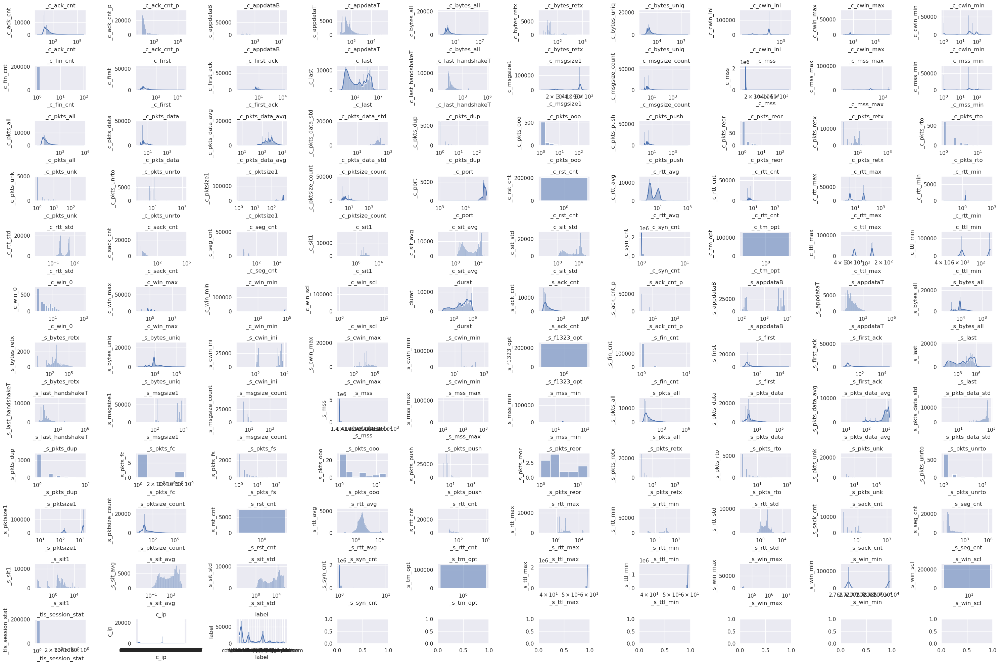

In [ ]:

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
fig.set_size_inches(30, 20)

axes = axes.flatten()

for i, y in enumerate(df_dropped.columns):
    # Calculate the position in the subplot grid
    row = i // n_cols
    col = i % n_cols

    sns.histplot(df_dropped[y], ax=axes[i], kde=True, log_scale=True)

    axes[i].set_title(y)
    axes[i].set_ylabel(y)

plt.tight_layout()
plt.show()

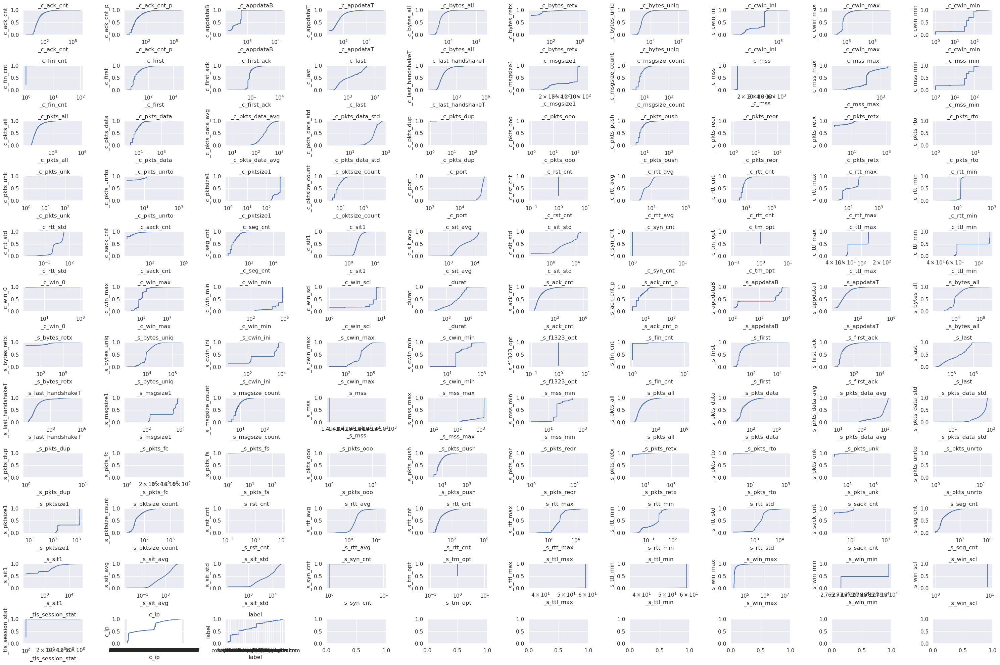

In [ ]:
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
fig.set_size_inches(30, 20)

axes = axes.flatten()

for i, y in enumerate(df_dropped.columns):

    row = i // n_cols
    col = i % n_cols

    sns.ecdfplot(data=df_dropped[y], ax=axes[i], log_scale=True)

    axes[i].set_title(y)
    axes[i].set_ylabel(y)

plt.tight_layout()
plt.show()

_c_rtt_avg
count    262443.000000
mean          7.092755
std          12.520561
min           0.780184
25%           2.850531
50%           4.004200
75%           9.981834
max        1125.393487
Name: _c_rtt_avg, dtype: float64


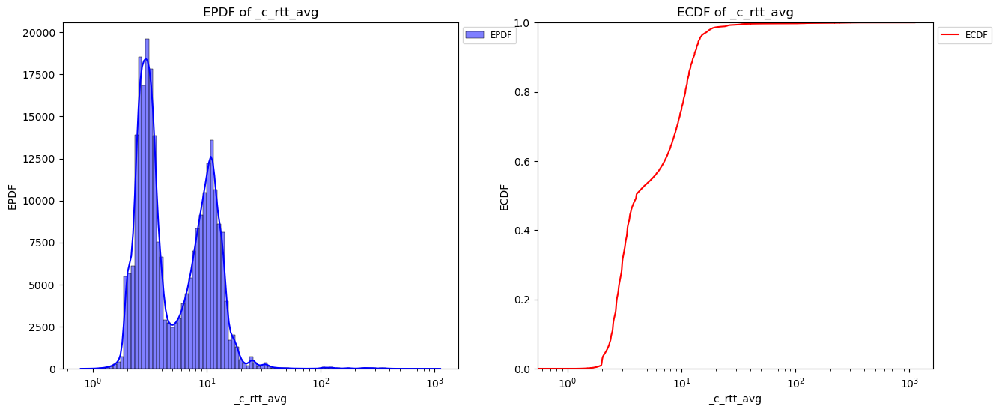

In [ ]:
feat = '_c_rtt_avg'
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
ax1.set_title(f'EPDF of {feat}')
ax1.set_xlabel(f'{feat}')
ax1.set_ylabel('EPDF')
print(feat)

sns.histplot(data=df_dropped[(df_dropped[feat] > 0) ], x=feat, bins=100, kde=True, color='blue', log_scale=True, ax=ax1, label='EPDF')
ax1.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize='small')
ax2.set_title(f'ECDF of {feat}')
ax2.set_xlabel(f'{feat}')
ax2.set_ylabel('ECDF')

sns.ecdfplot(data=df_dropped[df_dropped[feat] > 0], x=feat, ax=ax2, label='ECDF', log_scale=True,color='red')

ax2.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize='small')
print(df_dropped[(df_dropped[feat] > 0) ][feat].describe())

### Correlation matrix

In [ ]:
flow_matrix = df_norm_scaled.corr()

most_correlated_flow = dict()

for i in range(len(flow_matrix.columns)):
    for j in range(i + 1, len(flow_matrix.columns)):
        most_correlated_flow[flow_matrix.columns[i] + "-" + flow_matrix.columns[j]] = flow_matrix.iloc[i, j]

most_correlated_flow_ordered = {k: v for k, v in sorted(most_correlated_flow.items(), key=lambda item: item[1], reverse=True)}

print("Top 10 correlated features")
for key, value in list(most_correlated_flow_ordered.items())[:10]:
    print(f"Features: {key}, Value: {value}")


Top 10 correlated features
Features: _c_pkts_data-_c_pktsize_count, Value: 1.0
Features: _c_tm_opt-_s_tm_opt, Value: 1.0
Features: _s_f1323_opt-_s_win_scl, Value: 1.0
Features: _s_pkts_data-_s_pktsize_count, Value: 1.0
Features: _s_pkts_dup-_s_syn_cnt, Value: 0.9999999999999999
Features: _s_pkts_data-_s_seg_cnt, Value: 0.9999999998057654
Features: _s_pktsize_count-_s_seg_cnt, Value: 0.9999999998057654
Features: _s_ack_cnt-_s_pkts_all, Value: 0.9999999994463076
Features: _c_ack_cnt-_c_pkts_all, Value: 0.9999999515448132
Features: _c_pkts_data-_c_seg_cnt, Value: 0.999999931849779


### PCA

In [ ]:
pca_df_flow = df_norm_scaled.drop(columns=['c_ip', 'label'])

pca_flow = PCA(random_state=42)


principal_components_flow = pca_flow.fit(pca_df_flow)

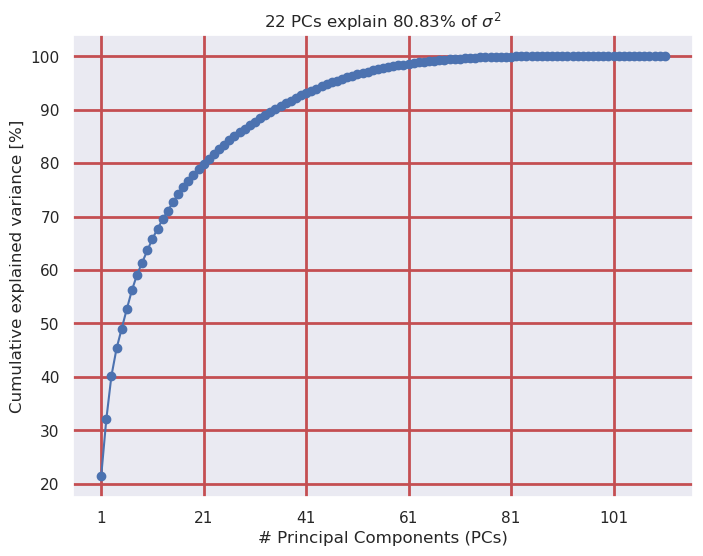

In [ ]:
explained_variance_flow = pca_flow.explained_variance_ratio_

cumul_exp_var_flow = np.cumsum(explained_variance_flow)

perc_cumul_exp_var_flow = cumul_exp_var_flow * 100

plt.figure(figsize=(8, 6))
plt.plot(perc_cumul_exp_var_flow, marker='o')
plt.xlabel('# Principal Components (PCs)')
plt.ylabel('Cumulative explained variance [%]')
plt.title(f'22 PCs explain {round(perc_cumul_exp_var_flow[21], 2)}% of $\sigma^2$')
plt.grid(color='r', linestyle='-', linewidth=2)
plt.xticks(np.arange(0, len(perc_cumul_exp_var_flow), step=20), np.arange(1, len(perc_cumul_exp_var_flow)+1, step=20))
plt.show()

In [ ]:
pca_flow = PCA(n_components=22, random_state=42)
pca_flow.fit(pca_df_flow)
pca_result_flow = pca_flow.transform(pca_df_flow)

pca_df_result_flow = pd.DataFrame(pca_result_flow, columns=['component_' + str(i) for i in range(1, 23)])
pca_df_result_flow['label'] = df_norm_scaled.reset_index()['label']
pca_df_result_flow

,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10,...,component_14,component_15,component_16,component_17,component_18,component_19,component_20,component_21,component_22,label
0,-0.428288,-0.112456,-0.171940,-1.326544,-2.352354,1.879344,0.330645,0.019211,-0.613271,0.958429,...,-0.089028,0.633361,0.319849,0.288634,1.746226,0.363423,0.177890,-1.945363,0.129934,krxd.net
1,-0.438645,-0.257208,-0.411653,-3.469950,2.042202,3.845721,-0.503644,-1.131646,5.163692,-0.005006,...,0.437329,-1.699863,-0.609705,0.005355,1.005096,0.322669,0.556782,-1.742584,-0.133501,other
2,-0.467753,0.111750,-0.207683,-1.596234,-1.929212,2.545121,-0.087703,-0.169831,-2.083898,1.154270,...,-0.211924,1.559697,3.428371,0.719150,0.128107,0.168956,0.291223,-1.467813,0.995449,contextweb.com
3,-0.481082,-0.144761,-0.354637,-0.511675,-2.839673,-0.706366,-0.167107,2.024324,2.418450,-1.592179,...,0.185569,1.180419,-0.456542,-0.029876,-0.346847,-0.186533,-0.133560,0.581786,2.556554,twitchcdn.net
4,-0.490636,-0.181913,-0.323544,-0.520104,-3.470664,-0.721625,0.179505,2.381980,3.483345,-0.168658,...,-0.029650,1.755353,-0.270496,0.094199,1.205464,0.168335,-0.159771,-0.096444,1.914039,twitchcdn.net
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262438,-0.192979,0.507131,0.062579,4.663496,0.478745,-1.827663,-0.330505,-1.744860,-1.450529,1.147592,...,-0.164176,-0.624785,1.642434,0.212204,-0.726417,-0.205131,-0.226371,-1.519821,-0.096662,other
262439,-0.397610,0.121443,-0.319340,3.324734,-3.918176,-1.546881,-0.258000,-0.302818,-0.150772,-0.653819,...,0.016211,-1.046359,0.167751,-0.046107,-1.935166,-0.442947,-0.666823,-1.186781,0.877593,krxd.net
262440,-0.427465,-0.143704,-0.260563,-1.338396,0.717713,1.186614,-0.281444,-0.647897,-1.800244,1.159874,...,-0.186714,0.013828,0.191992,0.040248,1.559576,0.001872,-0.459596,-0.038026,-1.079605,other
262441,-0.466013,-0.169299,-0.199438,-0.367589,0.066629,-1.920027,0.006094,1.786768,-0.102627,-1.466911,...,0.468186,-0.894463,0.324259,-0.178914,0.760300,-0.118954,-0.475217,0.452008,0.187096,krxd.net


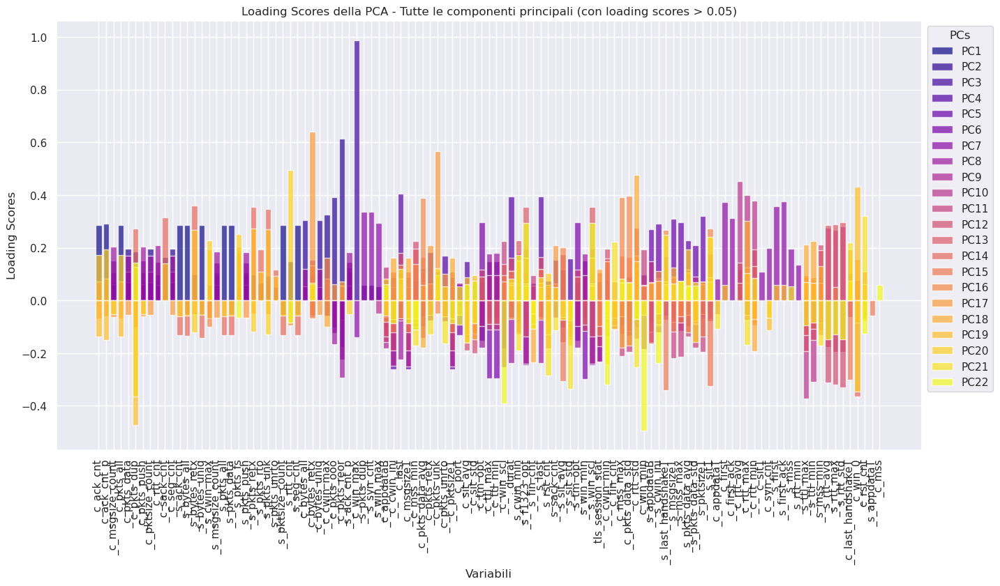

In [ ]:
num_components_flow = pca_flow.components_.shape[0]


selected_variables_flow = []
selected_loading_scores_flow = []


for i in range(num_components_flow):
    loading_scores_flow = pca_flow.components_[i, :]

    # Selects variable with loading scores (grater or smaller) then 0.05
    selected_vars_flow = pca_df_flow.columns[np.abs(loading_scores_flow) > 0.05]
    selected_vars_scores_flow = loading_scores_flow[np.abs(loading_scores_flow) > 0.05]


    selected_variables_flow.append(selected_vars_flow)
    selected_loading_scores_flow.append(selected_vars_scores_flow)

fig, ax = plt.subplots(figsize=(16, 8))

colors_flow = plt.cm.plasma(np.linspace(0, 1, num_components_flow))

for i in range(num_components_flow):
    ax.bar(selected_variables_flow[i], selected_loading_scores_flow[i], label=f'PC{i+1}', alpha=0.7, color=colors_flow[i])

ax.set_xlabel('Variabili')
ax.set_ylabel('Loading Scores')
ax.set_title('Loading Scores della PCA - Tutte le componenti principali (con loading scores > 0.05)')
plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left', title='PCs')

plt.show()

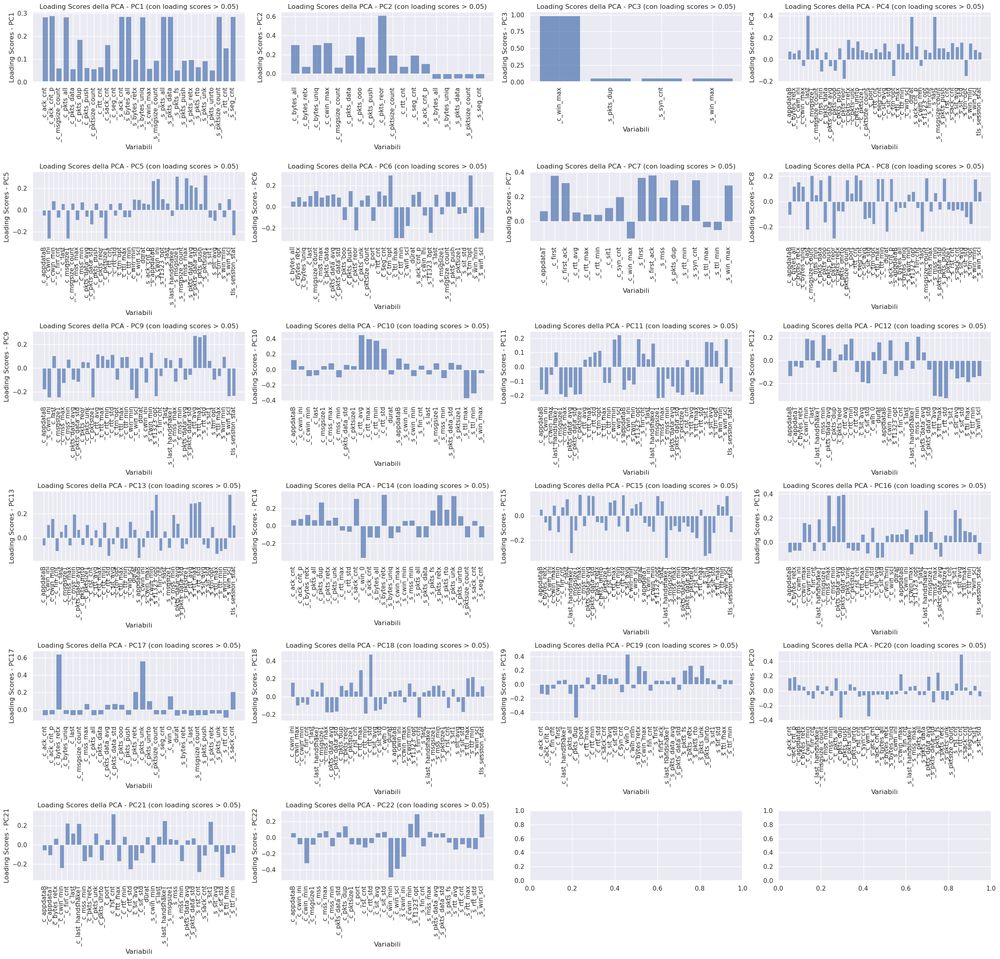

In [ ]:
num_components_flow = pca_flow.components_.shape[0]

num_rows_flow = int(np.ceil(num_components_flow / 4))
num_cols_flow = 4

fig, axes = plt.subplots(nrows=num_rows_flow, ncols=num_cols_flow, figsize=(25, 4 * num_rows_flow))

for i, ax in enumerate(axes.flatten()):
    if i < num_components_flow:
        loading_scores_flow = pca_flow.components_[i, :]

        selected_vars_flow = pca_df_flow.columns[np.abs(loading_scores_flow) > 0.05]
        selected_vars_scores_flow = loading_scores_flow[np.abs(loading_scores_flow) > 0.05]

        ax.bar(selected_vars_flow, selected_vars_scores_flow, alpha=0.7)

        ax.set_xlabel('Variabili')
        ax.set_ylabel(f'Loading Scores - PC{i+1}')
        ax.set_title(f'Loading Scores della PCA - PC{i+1} (con loading scores > 0.05)')
        ax.tick_params(axis='x', rotation=90)

plt.tight_layout()

plt.show()

### t-SNE

In [ ]:
X_flow = pca_df_result_flow.iloc[:, :-1]  # all coumns axcept the last one (target label)
y_flow = pca_df_result_flow.iloc[:, -1]   # selects anly the last one (target label)

label_encoder_flow = LabelEncoder()
y_encoded_flow = label_encoder_flow.fit_transform(y_flow)

tsne_flow = TSNE(n_components=2, random_state=42, n_jobs=n_jobs)

X_tsne_flow = tsne_flow.fit_transform(X_flow)

df_tsne_flow = pd.DataFrame(data=X_tsne_flow, columns=['TSNE1', 'TSNE2'])
df_tsne_flow['Target'] = label_encoder_flow.inverse_transform(y_encoded_flow)

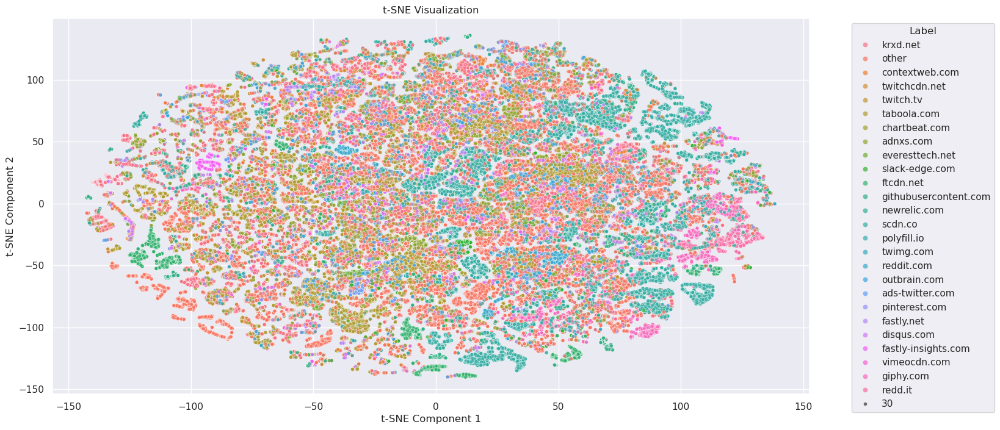

In [ ]:
palette_flow = sns.color_palette("husl", len(df_tsne_flow['Target'].unique()))

plt.figure(figsize=(16, 8))

sns.scatterplot(x='TSNE1', y='TSNE2', hue='Target', data=df_tsne_flow, palette=palette_flow, size=30, alpha=0.7)
plt.title('t-SNE Visualization')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Label')
plt.show()

## IP level

### Choosing of the aggreagation function

In [ ]:
from scipy.stats import percentileofscore

df_norm_scaled.drop(columns=['label']).describe()

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_avg,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat
count,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,...,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000,262443.000000
mean,-0.002506,-0.002285,0.009432,-0.001639,-0.000367,-0.004811,-0.000340,0.007913,-0.001527,-0.038016,...,-0.007782,-0.016407,-0.006885,0.061002,0.004926,0.010698,-0.006663,-0.060996,-0.105411,0.029091
std,1.709141,1.759133,0.998417,1.108586,1.346444,1.311679,1.347483,0.994943,1.525199,0.985066,...,0.973986,0.992942,0.936407,1.004336,0.956974,0.942138,0.960726,1.004335,1.229556,0.985809
min,-0.115011,-0.106907,-1.709188,-0.104993,-0.035583,-0.053287,-0.035351,-2.268370,-0.275446,-1.116417,...,-0.377549,-0.533901,-0.069715,-0.903455,-30.855557,-22.659110,-0.091339,-1.374884,-5.154702,-1.606309
25%,-0.106500,-0.102390,-0.517418,-0.097674,-0.031060,-0.053287,-0.030882,-1.203307,-0.144258,-0.501587,...,-0.377064,-0.533520,-0.069715,-0.903455,0.081361,0.108048,-0.089228,-1.106843,0.193998,-1.606309
50%,-0.099053,-0.099003,0.574035,-0.089313,-0.028346,-0.053287,-0.028176,0.629761,-0.144258,-0.358126,...,-0.356564,-0.490777,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787
75%,-0.079902,-0.083196,0.742568,-0.068495,-0.022057,-0.053287,-0.022030,0.629761,-0.078336,0.769064,...,-0.056909,0.009283,-0.069715,1.106862,0.081361,0.108048,-0.087517,0.903467,0.193998,0.608787
max,686.310301,715.050900,67.389387,156.018638,538.036015,469.248100,538.946915,8.186636,645.031636,11.487613,...,17.496858,7.300033,58.984732,1.106862,0.081361,0.108048,11.823813,0.903467,0.193998,13.899360


In [ ]:
df_norm_scaled.loc[df_norm_scaled['_c_ack_cnt'] > 680]

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,c_ip,label
229241,686.310301,715.0509,-0.344872,-0.08519,7.293393,28.883024,7.14092,-1.333723,1.06038,-0.501587,...,-0.069715,1.106862,0.081361,0.108048,0.03007,-1.106843,0.193998,-1.606309,67.32.230.6,taboola.com


In [ ]:
dato_interesse = df_norm_scaled['_c_ack_cnt'].mean()

percentile = percentileofscore(df_norm_scaled['_c_ack_cnt'], dato_interesse)

print(f"The data of interest {dato_interesse} is in the {percentile}° percentile.")

The data of interest -0.002505538868863091 is in the 89.8968537930141° percentile.


In [ ]:
df_norm_scaled['_c_ack_cnt'].drop(columns=['label']).drop(229241).mean()

-0.005120641658919788

In [ ]:
difference = df_norm_scaled['_c_ack_cnt'].drop(columns=['label']).drop(229241).mean() / df_norm_scaled['_c_ack_cnt'].drop(columns=['label']).mean()
print(f"The difference is {difference} times.")

The difference is 2.043728685495636 times.


In [ ]:
# Group by 'c_ip' and apply the aggregation functions
ip = df_norm_scaled.drop(columns=['label']).groupby('c_ip').median()
ip

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_avg,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat
c_ip,,,,,,,,,,,,,,,,,,,,,
67.32.100.12,-0.102244,-0.102390,-0.549519,-0.098741,-0.031651,-0.053287,-0.031410,-1.623536,-0.144258,-0.501587,...,-0.228051,-0.533177,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,-1.606309
67.32.100.15,-0.105436,-0.102390,0.742568,-0.092472,-0.030469,-0.053287,-0.030225,0.629761,-0.144258,-0.501587,...,-0.376090,-0.533497,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787
67.32.100.161,-0.095861,-0.094487,0.742568,-0.097582,-0.029294,-0.053287,-0.029047,0.629761,-0.144258,-0.501587,...,-0.377495,-0.533850,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787
67.32.100.172,-0.089478,-0.100132,0.742568,-0.095335,-0.014713,-0.036152,-0.014534,0.629761,0.071219,-0.091699,...,1.409986,2.968732,-0.069715,-0.903455,0.081361,0.108048,-0.085807,0.903467,0.193998,0.608787
67.32.100.217,-0.106500,-0.104649,0.730530,-0.099764,-0.028097,-0.053287,-0.027926,0.702214,-0.131467,-0.501587,...,-0.243588,-0.524234,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67.32.99.53,11.618891,11.650086,-0.545507,-0.095623,0.279182,-0.053287,0.280104,-1.695989,0.278497,-0.358126,...,-0.377523,-0.531910,-0.069715,1.106862,0.081361,0.108048,-0.049034,-1.106843,0.193998,-1.606309
67.32.99.59,-0.066071,-0.089971,0.742568,-0.094563,-0.015079,-0.036764,-0.014898,0.629761,-0.092930,-0.358126,...,0.511417,1.875142,-0.069715,-0.903455,0.081361,0.108048,-0.079607,0.903467,0.193998,0.608787
67.32.99.78,-0.096393,-0.091664,0.742568,-0.096641,-0.027997,-0.053287,-0.027748,0.629761,-0.114577,0.769064,...,-0.227796,0.479327,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787


While aggregating at ip level for median we noticed some columns got the same value, after exploring the meaning of the columns in the starting dataset, we decided to drop this value

In [ ]:
std_per_colonna = ip.std()

colonne_con_std_zero = std_per_colonna[std_per_colonna < 0.000001].index.tolist()

print("Columns to drop:")
print(colonne_con_std_zero)

Columns to drop:
['_c_pkts_ooo', '_c_pkts_reor', '_c_pkts_rto', '_c_syn_cnt', '_s_mss', '_s_pkts_fc', '_s_pkts_ooo', '_s_pkts_reor', '_s_pkts_unrto']


In [ ]:
ip = ip.drop(columns=colonne_con_std_zero)
ip

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_avg,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat
c_ip,,,,,,,,,,,,,,,,,,,,,
67.32.100.12,-0.102244,-0.102390,-0.549519,-0.098741,-0.031651,-0.053287,-0.031410,-1.623536,-0.144258,-0.501587,...,-0.228051,-0.533177,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,-1.606309
67.32.100.15,-0.105436,-0.102390,0.742568,-0.092472,-0.030469,-0.053287,-0.030225,0.629761,-0.144258,-0.501587,...,-0.376090,-0.533497,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787
67.32.100.161,-0.095861,-0.094487,0.742568,-0.097582,-0.029294,-0.053287,-0.029047,0.629761,-0.144258,-0.501587,...,-0.377495,-0.533850,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787
67.32.100.172,-0.089478,-0.100132,0.742568,-0.095335,-0.014713,-0.036152,-0.014534,0.629761,0.071219,-0.091699,...,1.409986,2.968732,-0.069715,-0.903455,0.081361,0.108048,-0.085807,0.903467,0.193998,0.608787
67.32.100.217,-0.106500,-0.104649,0.730530,-0.099764,-0.028097,-0.053287,-0.027926,0.702214,-0.131467,-0.501587,...,-0.243588,-0.524234,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67.32.99.53,11.618891,11.650086,-0.545507,-0.095623,0.279182,-0.053287,0.280104,-1.695989,0.278497,-0.358126,...,-0.377523,-0.531910,-0.069715,1.106862,0.081361,0.108048,-0.049034,-1.106843,0.193998,-1.606309
67.32.99.59,-0.066071,-0.089971,0.742568,-0.094563,-0.015079,-0.036764,-0.014898,0.629761,-0.092930,-0.358126,...,0.511417,1.875142,-0.069715,-0.903455,0.081361,0.108048,-0.079607,0.903467,0.193998,0.608787
67.32.99.78,-0.096393,-0.091664,0.742568,-0.096641,-0.027997,-0.053287,-0.027748,0.629761,-0.114577,0.769064,...,-0.227796,0.479327,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787


### Features Plot

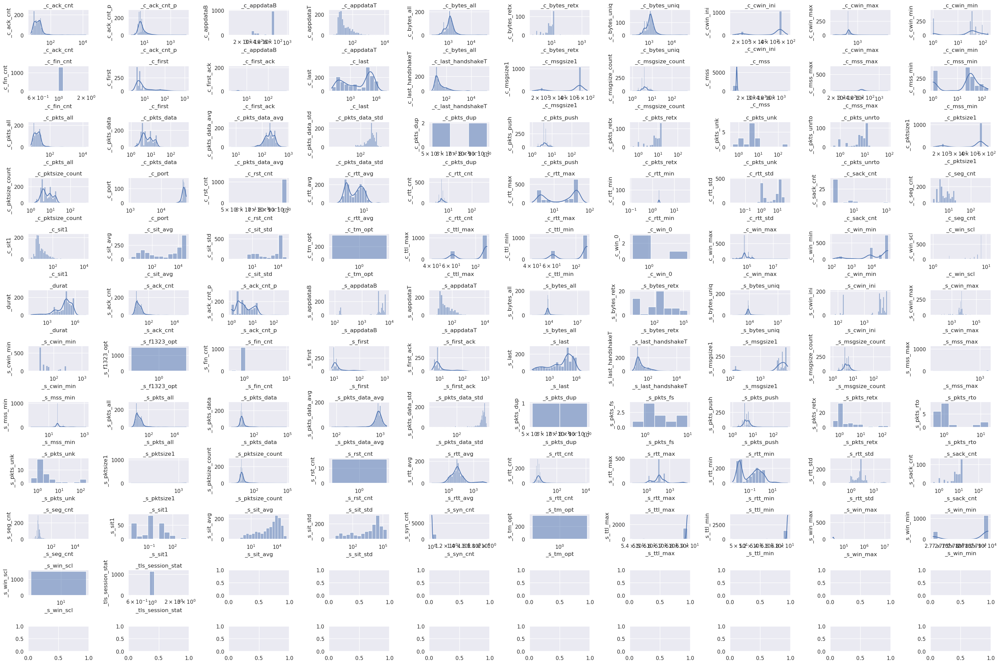

In [ ]:
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
fig.set_size_inches(30, 20)

axes = axes.flatten()

for i, y in enumerate(ip.columns):
    row = i // n_cols
    col = i % n_cols

    sns.histplot(df_dropped.drop(columns=['label']).groupby('c_ip').median()[y], ax=axes[i], kde=True, log_scale=True)

    axes[i].set_title(y)
    axes[i].set_ylabel(y)

plt.tight_layout()
plt.show()

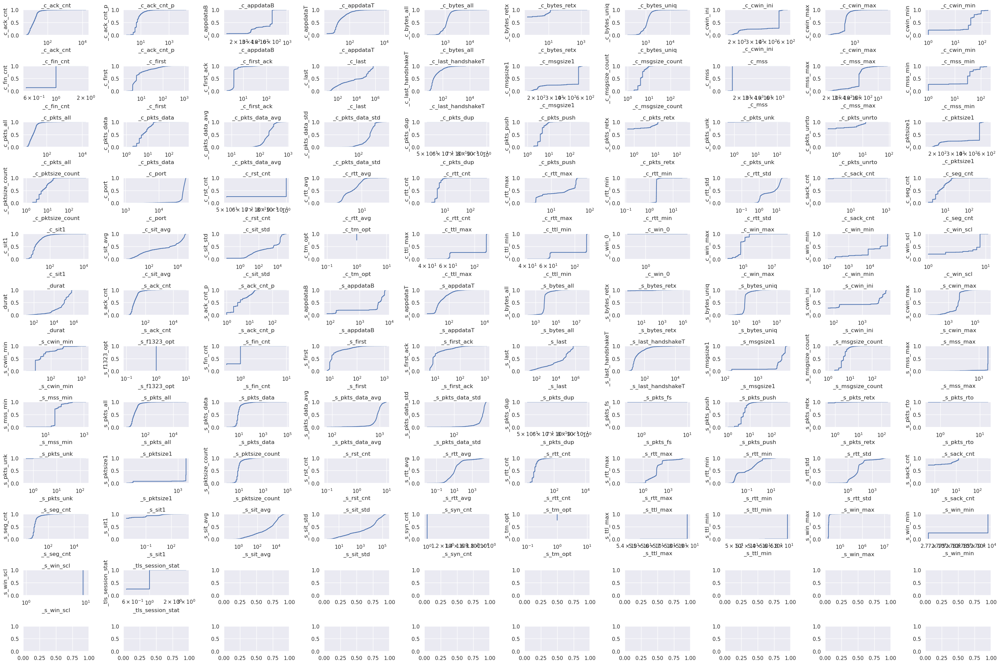

In [ ]:
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
fig.set_size_inches(30, 20)

axes = axes.flatten()

for i, y in enumerate(ip.columns):
    row = i // n_cols
    col = i % n_cols

    sns.ecdfplot(data=df_dropped.drop(columns=['label']).groupby('c_ip').median()[y], ax=axes[i], log_scale=True)

    axes[i].set_title(y)
    axes[i].set_ylabel(y)

plt.tight_layout()
plt.show()

_s_rtt_avg
count     1526.000000
mean       689.996444
std       3317.793871
min          0.009625
25%          3.997172
50%         11.014725
75%         28.573660
max      41944.805880
Name: _s_rtt_avg, dtype: float64


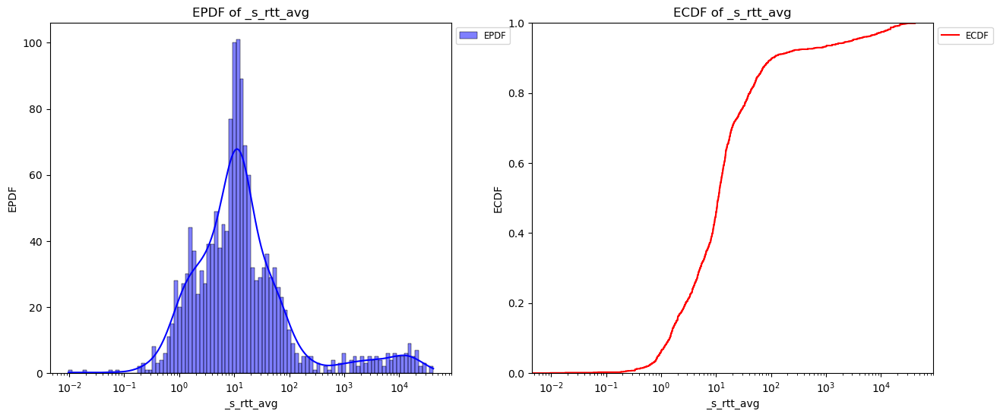

In [ ]:
feat = '_s_rtt_avg'
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
ax1.set_title(f'EPDF of {feat}')
ax1.set_xlabel(f'{feat}')
ax1.set_ylabel('EPDF')
print(feat)

sns.histplot(data=df_dropped.drop(columns=['label']).groupby('c_ip').median()[feat], bins=100, kde=True, color='blue', log_scale=True, ax=ax1, label='EPDF')
ax1.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize='small')
ax2.set_title(f'ECDF of {feat}')
ax2.set_xlabel(f'{feat}')
ax2.set_ylabel('ECDF')

sns.ecdfplot(data=df_dropped.drop(columns=['label']).groupby('c_ip').median()[feat], label='ECDF', log_scale=True,color='red')

ax2.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize='small')
print(df_dropped.drop(columns=['label']).groupby('c_ip').median()[feat].describe())

### Correlation matrix

In [ ]:
ip_matrix = ip.corr()

most_correlated_ip = dict()

# Iterate over pairs of columns in a triangular manner to avoid duplicates
for i in range(len(ip_matrix.columns)):
    for j in range(i + 1, len(ip_matrix.columns)):
        most_correlated_ip[ip_matrix.columns[i] + "-" + ip_matrix.columns[j]] = ip_matrix.iloc[i, j]

most_correlated_ip_ordered = {k: v for k, v in sorted(most_correlated_ip.items(), key=lambda item: item[1], reverse=True)}

# Itera sui primi 10 elementi del dizionario ordinato e stampa chiave e valore
print("Top 10 correlated features")
for key, value in list(most_correlated_ip_ordered.items())[:10]:
    print(f"Features: {key}, Value: {value}")

Top 10 correlated features
Features: _c_pkts_data-_c_pktsize_count, Value: 1.0
Features: _c_tm_opt-_s_tm_opt, Value: 1.0
Features: _s_f1323_opt-_s_win_scl, Value: 1.0
Features: _s_pkts_data-_s_pktsize_count, Value: 1.0
Features: _s_pkts_dup-_s_syn_cnt, Value: 0.9999999999999999
Features: _c_msgsize1-_c_pktsize1, Value: 0.9999999999999987
Features: _s_pkts_data-_s_seg_cnt, Value: 0.9999999999305582
Features: _s_pktsize_count-_s_seg_cnt, Value: 0.9999999999305582
Features: _s_ack_cnt-_s_pkts_all, Value: 0.9999999976037607
Features: _c_ack_cnt-_c_pkts_all, Value: 0.9999997253607854


### PCA

In [ ]:
pca_ip = PCA(random_state=42)

principal_components_ip = pca_ip.fit(ip)

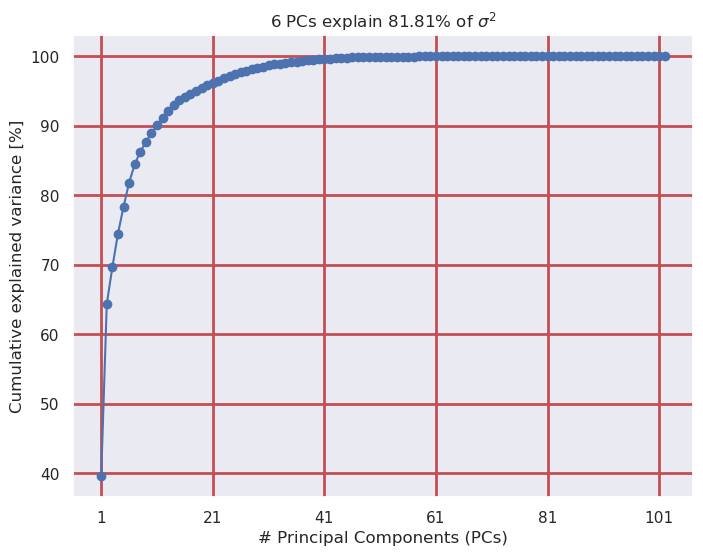

In [ ]:
explained_variance_ip = pca_ip.explained_variance_ratio_

cumul_exp_var_ip = np.cumsum(explained_variance_ip)

perc_cumul_exp_var_ip = cumul_exp_var_ip * 100

plt.figure(figsize=(8, 6))
plt.plot(perc_cumul_exp_var_ip, marker='o')
plt.xlabel('# Principal Components (PCs)')
plt.ylabel('Cumulative explained variance [%]')
plt.title(f'6 PCs explain {round(perc_cumul_exp_var_ip[5], 2)}% of $\sigma^2$')
plt.grid(color='r', linestyle='-', linewidth=2)
plt.xticks(np.arange(0, len(perc_cumul_exp_var_ip), step=20), np.arange(1, len(perc_cumul_exp_var_ip)+1, step=20))
plt.show()

In [ ]:
chosen_n_ip = 6

pca_ip = PCA(n_components=chosen_n_ip, random_state=42)
pca_ip.fit(ip)
pca_result_ip = pca_ip.transform(ip)

pca_df_result_ip = pd.DataFrame(pca_result_ip, columns=['component_' + str(i) for i in range(1, chosen_n_ip+1)])
pca_df_result_ip.index = ip.index
pca_df_result_ip

,component_1,component_2,component_3,component_4,component_5,component_6
c_ip,,,,,,
67.32.100.12,-0.417584,-0.793707,2.576800,-1.372080,-0.002150,-3.623546
67.32.100.15,-0.370026,-0.660946,0.383444,-0.019401,2.497851,-2.503146
67.32.100.161,-0.377404,-0.516799,0.342361,-0.030604,2.999009,-2.273742
67.32.100.172,-0.333288,1.604171,-2.298784,1.987870,0.377205,2.536910
67.32.100.217,-0.312492,-0.592311,-1.072563,0.461701,0.316864,0.794409
...,...,...,...,...,...,...
67.32.99.53,3.590152,-0.415626,18.881312,19.331261,0.129474,0.175462
67.32.99.59,-0.076714,1.536033,-2.372336,1.609192,-0.342636,1.573838
67.32.99.78,-0.377097,-0.230145,0.436522,0.040295,2.646837,-2.643443


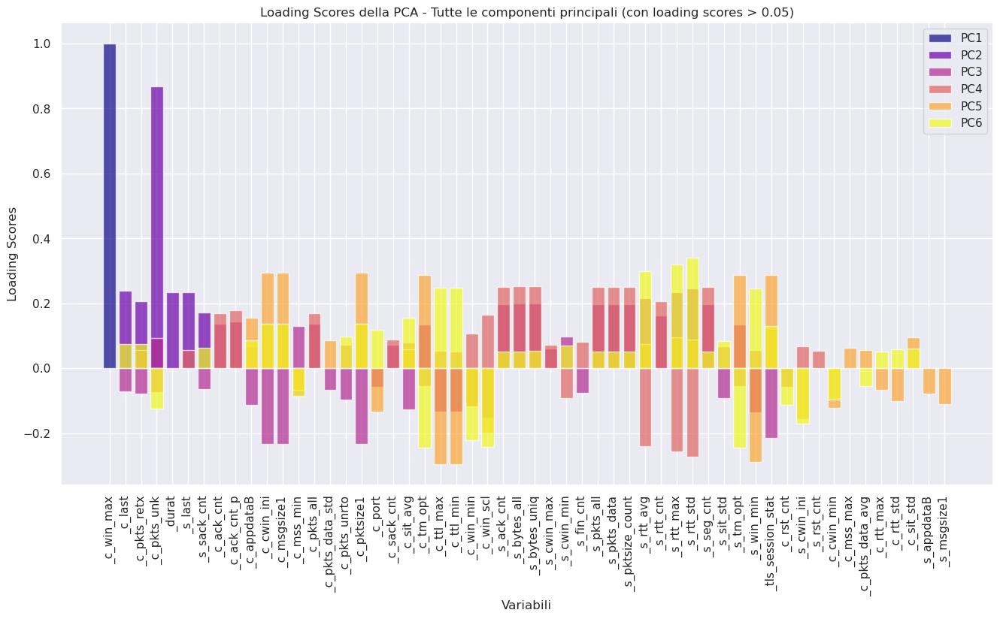

In [ ]:
num_components_ip = pca_ip.components_.shape[0]

selected_variables_ip = []
selected_loading_scores_ip = []

for i in range(num_components_ip):
    loading_scores_ip = pca_ip.components_[i, :]

    selected_vars_ip = ip.columns[np.abs(loading_scores_ip) > 0.05]
    selected_vars_scores_ip = loading_scores_ip[np.abs(loading_scores_ip) > 0.05]

    selected_variables_ip.append(selected_vars_ip)
    selected_loading_scores_ip.append(selected_vars_scores_ip)

fig, ax = plt.subplots(figsize=(16, 8))

colors_ip = plt.cm.plasma(np.linspace(0, 1, num_components_ip))

for i in range(num_components_ip):
    ax.bar(selected_variables_ip[i], selected_loading_scores_ip[i], label=f'PC{i+1}', alpha=0.7, color=colors_ip[i])

ax.set_xlabel('Variabili')
ax.set_ylabel('Loading Scores')
ax.set_title('Loading Scores della PCA - Tutte le componenti principali (con loading scores > 0.05)')
plt.xticks(rotation=90)
ax.legend()

plt.show()

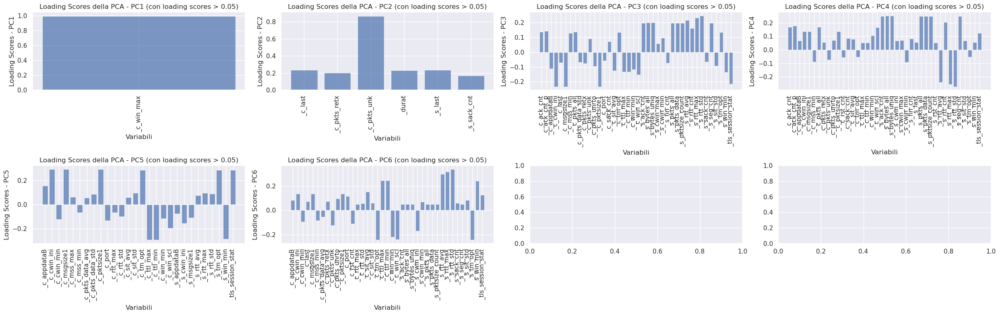

In [ ]:
num_components_ip = pca_ip.components_.shape[0]

# number of rows and columns for the subplot
num_rows_ip = int(np.ceil(num_components_ip / 4))
num_cols_ip = 4

fig, axes = plt.subplots(nrows=num_rows_ip, ncols=num_cols_ip, figsize=(25, 4 * num_rows_ip))

for i, ax in enumerate(axes.flatten()):
    if i < num_components_ip:
        loading_scores_ip = pca_ip.components_[i, :]

        selected_vars_ip = ip.columns[np.abs(loading_scores_ip) > 0.05]
        selected_vars_scores_ip = loading_scores_ip[np.abs(loading_scores_ip) > 0.05]

        ax.bar(selected_vars_ip, selected_vars_scores_ip, alpha=0.7)

        ax.set_xlabel('Variabili')
        ax.set_ylabel(f'Loading Scores - PC{i+1}')
        ax.set_title(f'Loading Scores della PCA - PC{i+1} (con loading scores > 0.05)')
        ax.tick_params(axis='x', rotation=90)

plt.tight_layout()

plt.show()

### TSNE

In [ ]:
tsne_ip = TSNE(n_components=2, random_state=42, n_jobs=n_jobs)

X_tsne_ip = tsne_ip.fit_transform(ip)

df_tsne_ip = pd.DataFrame(data=X_tsne_ip, columns=['TSNE1', 'TSNE2'], index=ip.index)

In [ ]:
labels_grouped_ip = df_norm_scaled.groupby('c_ip')['label'].agg(['count', 'nunique', lambda x: x.mode().iloc[0] if not x.mode().empty else x.iloc[0]]).rename(columns={'<lambda_0>': 'mode'})
grouped_ip_stats = pd.merge(df_tsne_ip, labels_grouped_ip, left_index=True, right_on='c_ip')
grouped_ip_stats

,TSNE1,TSNE2,count,nunique,mode
c_ip,,,,,
67.32.100.12,-23.664579,-32.835751,207,14,other
67.32.100.15,-38.208473,-14.136958,33,7,other
67.32.100.161,-35.870182,-13.044767,32,4,disqus.com
67.32.100.172,-26.583340,28.983746,3,2,disqus.com
67.32.100.217,43.031807,6.806585,19,2,disqus.com
...,...,...,...,...,...
67.32.99.53,-2.511993,-39.434608,1,1,other
67.32.99.59,-19.665283,22.584057,2,2,everesttech.net
67.32.99.78,-39.121452,-7.128708,32,8,other


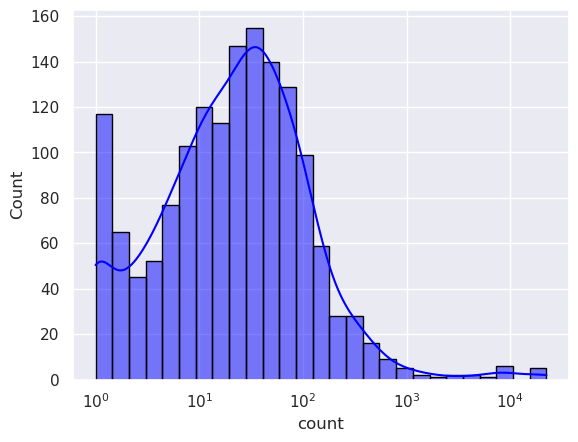

In [ ]:
histplot_ip = sns.histplot(grouped_ip_stats['count'], kde=True, color='blue', edgecolor='black', log_scale=True)

x_vals_ip = histplot_ip.get_lines()[0].get_xdata()

intervals_ip = np.logspace(np.log10(x_vals_ip.min()), np.log10(x_vals_ip.max()), num=30)

grouped_ip_stats['count_intervals'] = pd.cut(grouped_ip_stats['count'], bins=intervals_ip, right=False)

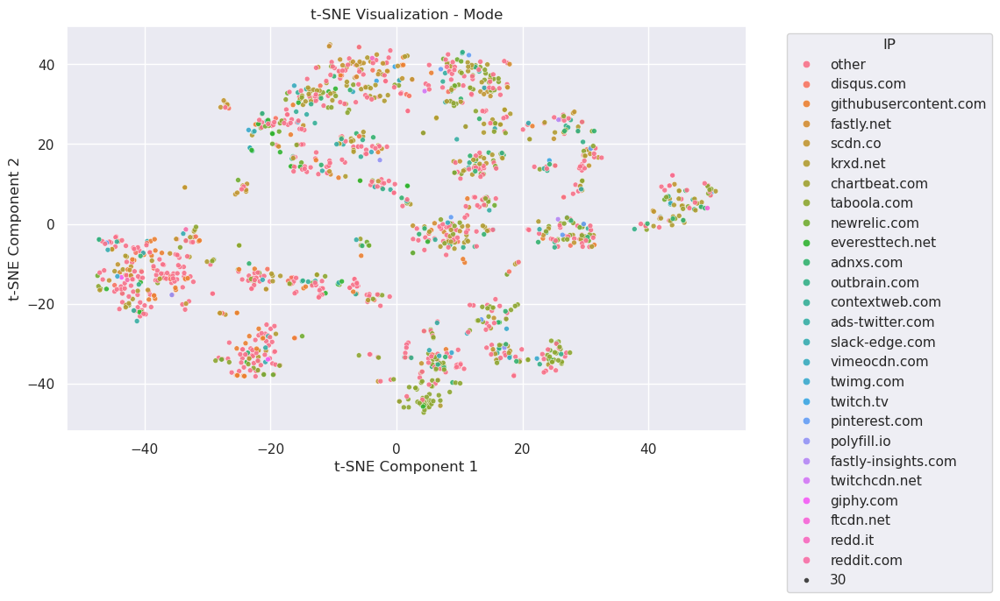

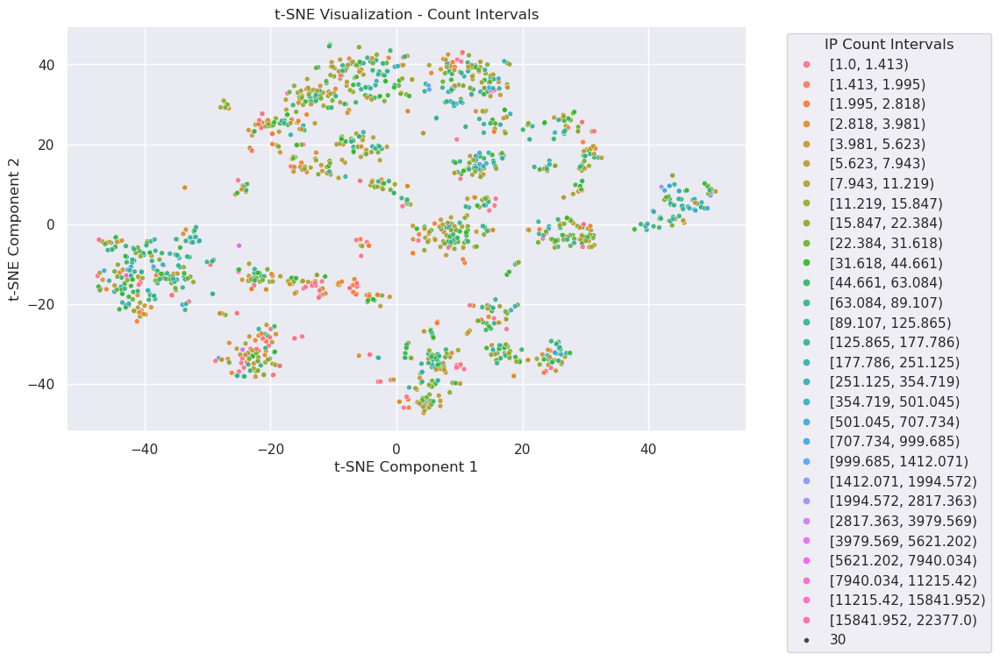

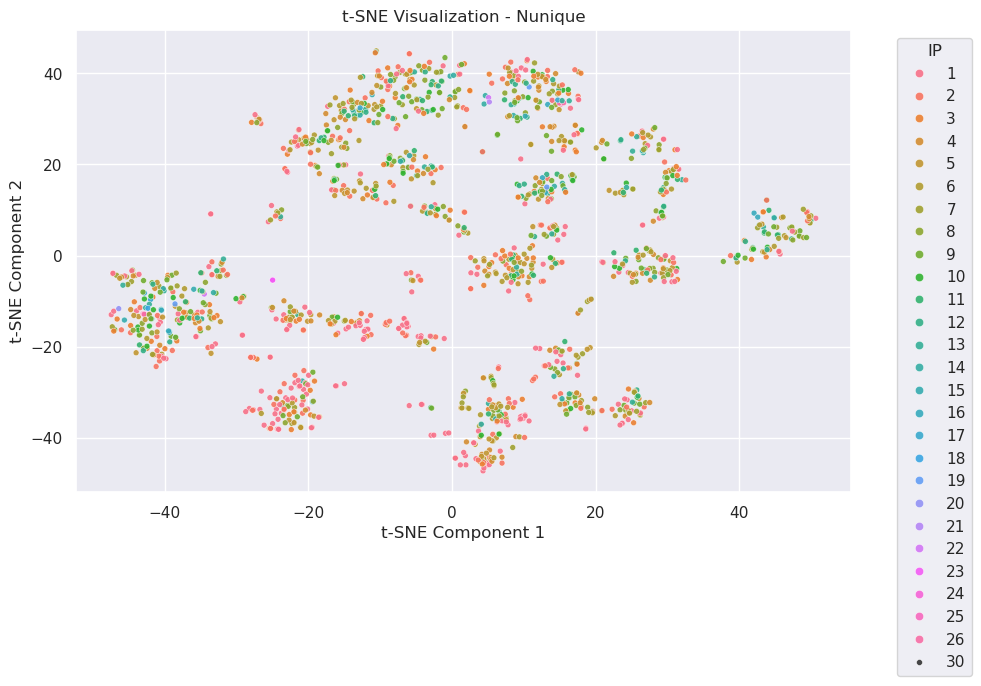

In [ ]:
palette_ip_mode = sns.color_palette("husl", len(grouped_ip_stats['mode'].dropna().unique()))
palette_ip_count = sns.color_palette("husl", n_colors=len(grouped_ip_stats['count_intervals'].unique().categories))
palette_ip_nunique = sns.color_palette("husl", len(grouped_ip_stats['nunique'].unique()))

# 'mode'
plt.figure(figsize=(10, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='mode', data=grouped_ip_stats, palette=palette_ip_mode, size=30, alpha=0.9)
plt.title('t-SNE Visualization - Mode')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='IP')
plt.show()

# 'count' with intervals
plt.figure(figsize=(10, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='count_intervals', data=grouped_ip_stats, palette=palette_ip_count, size=30, alpha=0.9)
plt.title('t-SNE Visualization - Count Intervals')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='IP Count Intervals')
plt.show()

#nunique'
plt.figure(figsize=(10, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='nunique', data=grouped_ip_stats, palette=palette_ip_nunique, size=30, alpha=0.9)
plt.title('t-SNE Visualization - Nunique')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='IP')
plt.show()

## Domain level

In [ ]:
domain = df_norm_scaled.drop(columns=['c_ip']).groupby('label').median()
domain

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_avg,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat
label,,,,,,,,,,,,,,,,,,,,,
adnxs.com,-0.103308,-0.101261,-0.517418,-0.096652,-0.027933,-0.053287,-0.027834,0.629761,-0.110805,-0.091699,...,-0.339835,-0.526632,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787
ads-twitter.com,-0.102244,-0.101261,0.574035,-0.091307,-0.029066,-0.053287,-0.028847,0.629761,-0.144258,-0.358126,...,-0.039700,-0.094594,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787
chartbeat.com,-0.100117,-0.101261,0.742568,-0.091899,-0.027420,-0.053287,-0.027284,0.629761,-0.144258,-0.358126,...,0.129206,-0.025911,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787
contextweb.com,-0.104372,-0.102390,0.742568,-0.089550,-0.026081,-0.053287,-0.025927,0.629761,-0.060953,-0.091699,...,-0.132122,-0.278361,-0.069715,-0.903455,0.081361,0.108048,-0.088659,0.903467,0.193998,0.608787
disqus.com,-0.100117,-0.100132,0.742568,-0.091437,-0.024763,-0.053287,-0.024735,0.629761,-0.049474,-0.091699,...,-0.232699,-0.360901,-0.069715,1.106862,0.081361,0.108048,-0.088372,-1.106843,0.193998,0.608787
everesttech.net,-0.100117,-0.100132,0.742568,-0.086235,-0.026936,-0.053287,-0.026748,0.629761,-0.098670,-0.358126,...,-0.218059,-0.256944,-0.069715,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.193998,0.608787
fastly-insights.com,-0.106500,-0.102390,0.742568,-0.073689,-0.028731,-0.053287,-0.028490,0.629761,-0.138027,0.769064,...,-0.376984,-0.533358,-0.069715,-0.903455,-4.137310,-2.996564,-0.089228,0.903467,0.193998,0.608787
fastly.net,-0.093733,-0.093358,0.742568,-0.088286,-0.027363,-0.053287,-0.027141,0.629761,-0.121956,-0.091699,...,-0.326540,-0.438533,-0.069715,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.193998,0.608787
ftcdn.net,-0.105436,-0.100132,-1.709188,-0.104993,-0.030583,-0.053287,-0.030354,0.144324,-0.166232,-0.501587,...,-0.377350,-0.533615,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787


While aggregating at domain level for median we noticed some columns got the same value, after exploring the meaning of the columns in the starting dataset, we decided to drop this value

In [ ]:
# Calcola la deviazione standard per ogni colonna
std_per_colonna = domain.std()

# Trova le colonne con deviazione standard uguale a zero
colonne_con_std_zero = std_per_colonna[std_per_colonna < 0.00000001].index.tolist()

# Stampa la lista delle colonne
print("Columns to drop:")
print(colonne_con_std_zero)

Columns to drop:
['_c_bytes_retx', '_c_mss', '_c_pkts_dup', '_c_pkts_ooo', '_c_pkts_reor', '_c_pkts_retx', '_c_pkts_rto', '_c_pkts_unk', '_c_pkts_unrto', '_c_syn_cnt', '_c_win_0', '_s_bytes_retx', '_s_f1323_opt', '_s_mss', '_s_pkts_dup', '_s_pkts_fc', '_s_pkts_fs', '_s_pkts_ooo', '_s_pkts_reor', '_s_pkts_retx', '_s_pkts_rto', '_s_pkts_unk', '_s_pkts_unrto', '_s_rst_cnt', '_s_sack_cnt', '_s_syn_cnt', '_s_win_scl']


In [ ]:
domain=domain.drop(columns=colonne_con_std_zero)
domain

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,_c_fin_cnt,...,_s_seg_cnt,_s_sit1,_s_sit_avg,_s_sit_std,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_tls_session_stat
label,,,,,,,,,,,,,,,,,,,,,
adnxs.com,-0.103308,-0.101261,-0.517418,-0.096652,-0.027933,-0.027834,0.629761,-0.110805,-0.091699,0.386011,...,-0.089534,-0.073680,-0.339835,-0.526632,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787
ads-twitter.com,-0.102244,-0.101261,0.574035,-0.091307,-0.029066,-0.028847,0.629761,-0.144258,-0.358126,0.386011,...,-0.089534,-0.073680,-0.039700,-0.094594,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787
chartbeat.com,-0.100117,-0.101261,0.742568,-0.091899,-0.027420,-0.027284,0.629761,-0.144258,-0.358126,0.386011,...,-0.088846,-0.073680,0.129206,-0.025911,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787
contextweb.com,-0.104372,-0.102390,0.742568,-0.089550,-0.026081,-0.025927,0.629761,-0.060953,-0.091699,0.386011,...,-0.089877,-0.073680,-0.132122,-0.278361,-0.903455,0.081361,0.108048,-0.088659,0.903467,0.608787
disqus.com,-0.100117,-0.100132,0.742568,-0.091437,-0.024763,-0.024735,0.629761,-0.049474,-0.091699,0.386011,...,-0.089534,-0.073680,-0.232699,-0.360901,1.106862,0.081361,0.108048,-0.088372,-1.106843,0.608787
everesttech.net,-0.100117,-0.100132,0.742568,-0.086235,-0.026936,-0.026748,0.629761,-0.098670,-0.358126,0.386011,...,-0.088502,-0.073680,-0.218059,-0.256944,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.608787
fastly-insights.com,-0.106500,-0.102390,0.742568,-0.073689,-0.028731,-0.028490,0.629761,-0.138027,0.769064,0.386011,...,-0.089534,-0.073680,-0.376984,-0.533358,-0.903455,-4.137310,-2.996564,-0.089228,0.903467,0.608787
fastly.net,-0.093733,-0.093358,0.742568,-0.088286,-0.027363,-0.027141,0.629761,-0.121956,-0.091699,0.386011,...,-0.084033,-0.073680,-0.326540,-0.438533,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.608787
ftcdn.net,-0.105436,-0.100132,-1.709188,-0.104993,-0.030583,-0.030354,0.144324,-0.166232,-0.501587,0.386011,...,-0.087815,-0.072187,-0.377350,-0.533615,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787


### Features Plot

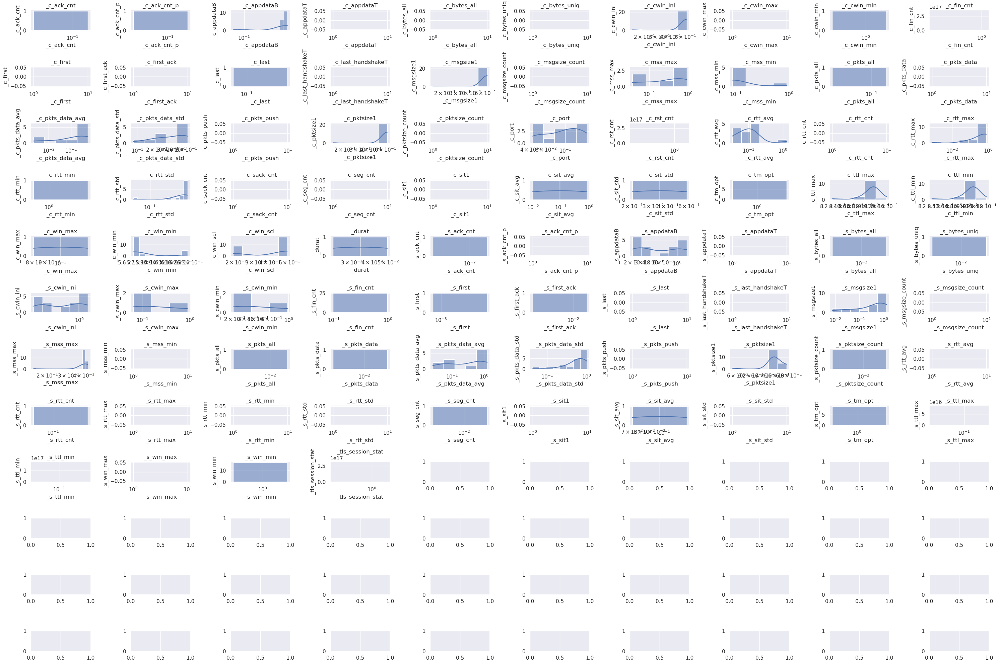

In [ ]:
# Create subplots
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
fig.set_size_inches(30, 20)

# Flatten the axes array to iterate through it
axes = axes.flatten()

# Iterate through each column in the DataFrame
for i, y in enumerate(domain.columns):
    # Calculate the position in the subplot grid
    row = i // n_cols
    col = i % n_cols

    # Scatter plot on the corresponding subplot
    sns.histplot(df_norm_scaled.drop(columns=['c_ip']).groupby('label').median()[y], ax=axes[i], kde=True, log_scale=True)

    # Set labels for the subplot
    axes[i].set_title(y)
    axes[i].set_ylabel(y)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

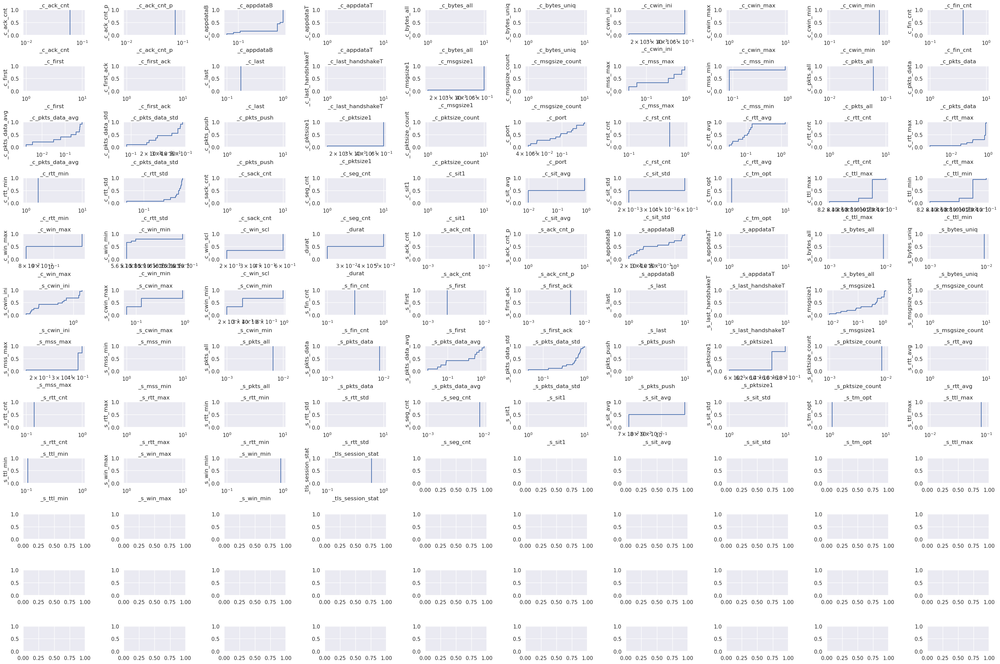

In [ ]:
# Create subplots
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols)
fig.set_size_inches(30, 20)

axes = axes.flatten()

# Iterate through each column in the DataFrame
for i, y in enumerate(domain.columns):
    # Calculate the position in the subplot grid
    row = i // n_cols
    col = i % n_cols

    # Scatter plot on the corresponding subplot
    sns.ecdfplot(data=df_norm_scaled.drop(columns=['c_ip']).groupby('label').median()[y], ax=axes[i], log_scale=True)

    # Set labels for the subplot
    axes[i].set_title(y)
    axes[i].set_ylabel(y)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

count       26.000000
mean     10740.000000
std      17840.159239
min        424.000000
25%       3946.250000
50%       5325.000000
75%       6798.750000
max      89166.000000
Name: _s_cwin_max, dtype: float64


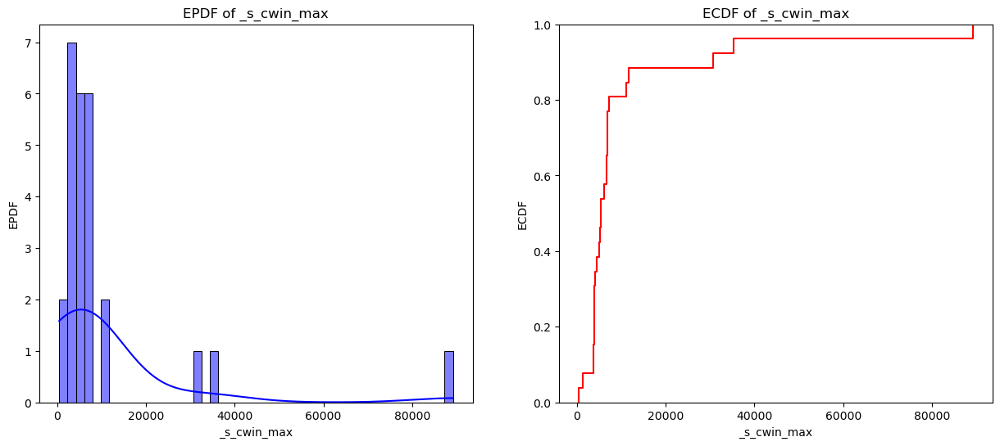

In [ ]:
feat = '_s_cwin_max'

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

ax1.set_title(f'EPDF of {feat}')
ax1.set_xlabel(f'{feat}')
ax1.set_ylabel('EPDF')

sns.histplot(data=df_dropped.drop(columns=['c_ip']).groupby('label').median()[feat], kde=True, ax=ax1, color='blue')

ax2.set_title(f'ECDF of {feat}')
ax2.set_xlabel(f'{feat}')
ax2.set_ylabel('ECDF')

sns.ecdfplot(data=df_dropped.drop(columns=['c_ip']).groupby('label').median()[feat], ax=ax2,color='red')


print(df_dropped.drop(columns=['c_ip']).groupby('label').median()[feat].describe())


### Correlation matrix

In [ ]:
domain_matrix = domain.corr()

most_correlated_domain = dict()


for i in range(len(domain_matrix.columns)):
    for j in range(i + 1, len(domain_matrix.columns)):
        most_correlated_domain[domain_matrix.columns[i] + "-" + domain_matrix.columns[j]] = domain_matrix.iloc[i, j]

most_correlated_domain_ordered = {k: v for k, v in sorted(most_correlated_domain.items(), key=lambda item: item[1], reverse=True)}

print("Top 10 correlated features")
for key, value in list(most_correlated_domain_ordered.items())[:10]:
    print(f"Features: {key}, Value: {value}")


Top 10 correlated features
Features: _c_ttl_max-_c_ttl_min, Value: 1.0000000000000002
Features: _c_pkts_data-_c_pktsize_count, Value: 1.0
Features: _c_pkts_data-_c_seg_cnt, Value: 1.0
Features: _c_pktsize_count-_c_seg_cnt, Value: 1.0
Features: _c_tm_opt-_s_tm_opt, Value: 1.0
Features: _s_pkts_data-_s_pktsize_count, Value: 1.0
Features: _s_pkts_data-_s_seg_cnt, Value: 1.0
Features: _s_pktsize_count-_s_seg_cnt, Value: 1.0
Features: _s_ttl_max-_s_ttl_min, Value: 1.0
Features: _c_cwin_ini-_c_msgsize1, Value: 0.9999999999999998


### PCA

In [ ]:
pca_domain = PCA(random_state=42)

principal_components_domain = pca_domain.fit(domain)

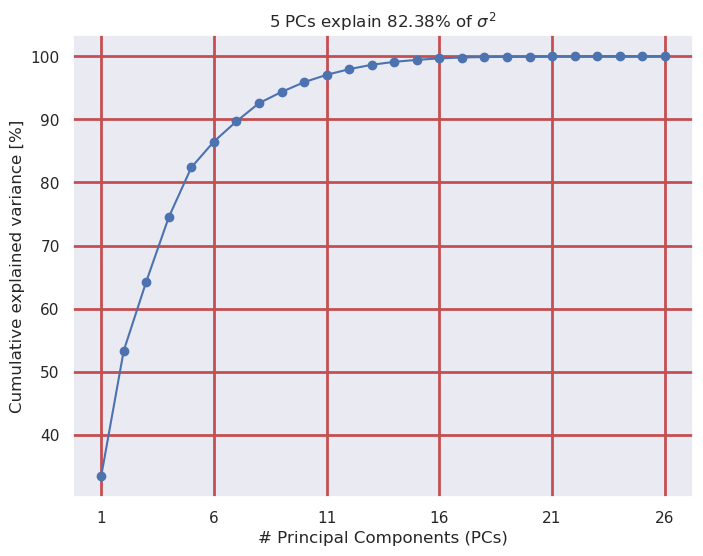

In [ ]:
# describe how much of the dataset variability is indicated by a given amount of features
explained_variance_domain = pca_domain.explained_variance_ratio_

# evaluate the total dataset variability while increasing the variables
cumul_exp_var_domain = np.cumsum(explained_variance_domain)

# percentage value to better understand the best number of components
perc_cumul_exp_var_domain = cumul_exp_var_domain * 100

plt.figure(figsize=(8, 6))
plt.plot(perc_cumul_exp_var_domain, marker='o')
plt.xlabel('# Principal Components (PCs)')
plt.ylabel('Cumulative explained variance [%]')
plt.title(f'5 PCs explain {round(perc_cumul_exp_var_domain[4], 2)}% of $\sigma^2$')
plt.grid(color='r', linestyle='-', linewidth=2)
plt.xticks(np.arange(0, len(perc_cumul_exp_var_domain), step=5), np.arange(1, len(perc_cumul_exp_var_domain)+1, step=5))
plt.show()

In [ ]:
chosen_n_domain = 5

pca_domain = PCA(n_components=chosen_n_domain, random_state=42)
pca_domain.fit(domain)
pca_result_domain = pca_domain.transform(domain)

pca_df_result_domain = pd.DataFrame(pca_result_domain, columns=['component_' + str(i) for i in range(1, chosen_n_domain+1)])
pca_df_result_domain.index = domain.index
pca_df_result_domain

,component_1,component_2,component_3,component_4,component_5
label,,,,,
adnxs.com,-1.661602,0.855784,0.084922,-0.505315,1.735077
ads-twitter.com,-1.576819,-0.575176,-0.909185,-0.029436,-0.707750
chartbeat.com,-1.602720,-0.863040,-1.257255,-0.340931,-1.656778
contextweb.com,-1.719645,-0.330874,-0.555651,-0.030499,-0.283285
disqus.com,2.495968,-0.897274,0.121421,-0.591000,-0.791937
everesttech.net,-1.821355,-2.181750,-0.814090,0.176093,-0.079805
fastly-insights.com,-2.739595,-1.064183,5.294944,2.369590,-1.282308
fastly.net,-1.608771,-0.141182,0.172127,-0.609587,0.845354
ftcdn.net,-1.305480,4.304409,0.919178,0.143245,0.831086


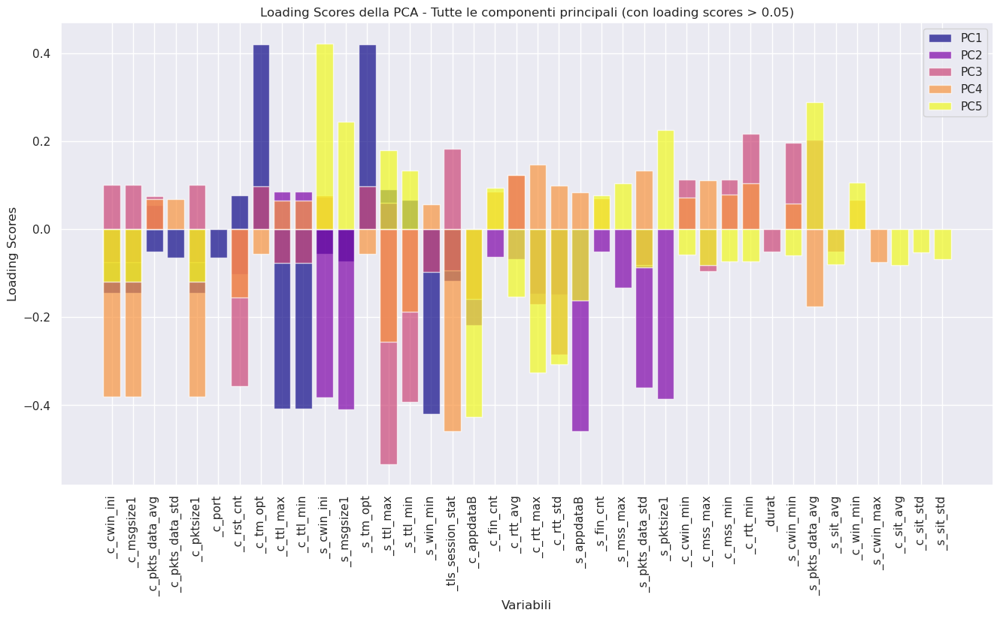

In [ ]:
num_components_domain = pca_domain.components_.shape[0]

selected_variables_domain = []
selected_loading_scores_domain = []

for i in range(num_components_domain):
    loading_scores_domain = pca_domain.components_[i, :]

    selected_vars_domain = domain.columns[np.abs(loading_scores_domain) > 0.05]
    selected_vars_scores_domain = loading_scores_domain[np.abs(loading_scores_domain) > 0.05]

    selected_variables_domain.append(selected_vars_domain)
    selected_loading_scores_domain.append(selected_vars_scores_domain)

fig, ax = plt.subplots(figsize=(16, 8))

colors_domain = plt.cm.plasma(np.linspace(0, 1, num_components_domain))

for i in range(num_components_domain):
    ax.bar(selected_variables_domain[i], selected_loading_scores_domain[i], label=f'PC{i+1}', alpha=0.7, color=colors_domain[i])

ax.set_xlabel('Variabili')
ax.set_ylabel('Loading Scores')
ax.set_title('Loading Scores della PCA - Tutte le componenti principali (con loading scores > 0.05)')
plt.xticks(rotation=90)
ax.legend()

plt.show()

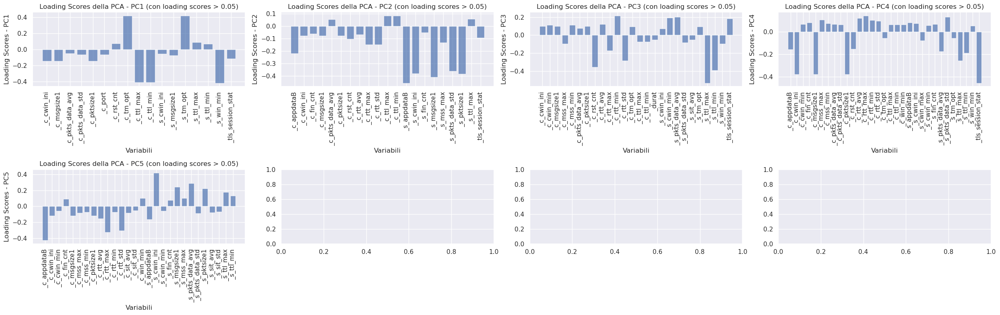

In [ ]:
num_components_domain = pca_domain.components_.shape[0]

num_rows_domain = int(np.ceil(num_components_domain / 4))
num_cols_domain = 4

fig, axes = plt.subplots(nrows=num_rows_domain, ncols=num_cols_domain, figsize=(25, 4 * num_rows_domain))

for i, ax in enumerate(axes.flatten()):
    if i < num_components_domain:
        loading_scores_domain = pca_domain.components_[i, :]

        selected_vars_domain = domain.columns[np.abs(loading_scores_domain) > 0.05]
        selected_vars_scores_domain = loading_scores_domain[np.abs(loading_scores_domain) > 0.05]

        ax.bar(selected_vars_domain, selected_vars_scores_domain, alpha=0.7)

        ax.set_xlabel('Variabili')
        ax.set_ylabel(f'Loading Scores - PC{i+1}')
        ax.set_title(f'Loading Scores della PCA - PC{i+1} (con loading scores > 0.05)')
        ax.tick_params(axis='x', rotation=90)

plt.tight_layout()

plt.show()

### TSNE

In [ ]:
tsne_domain = TSNE(n_components=2, random_state=42, n_jobs=n_jobs, perplexity=10)

X_tsne_domain = tsne_domain.fit_transform(domain)

df_tsne_domain = pd.DataFrame(data=X_tsne_domain, columns=['TSNE1', 'TSNE2'])
df_tsne_domain['label'] = domain.index
df_tsne_domain

,TSNE1,TSNE2,label
0,3.929430,-2.014512,adnxs.com
1,6.492821,-3.495021,ads-twitter.com
2,7.650218,-3.393528,chartbeat.com
3,5.623703,-3.172950,contextweb.com
4,7.444780,-9.401835,disqus.com
5,6.049782,-4.880124,everesttech.net
6,3.431073,-4.877277,fastly-insights.com
7,4.502202,-3.157430,fastly.net
8,4.484285,-0.250017,ftcdn.net
9,8.683078,-10.462311,giphy.com


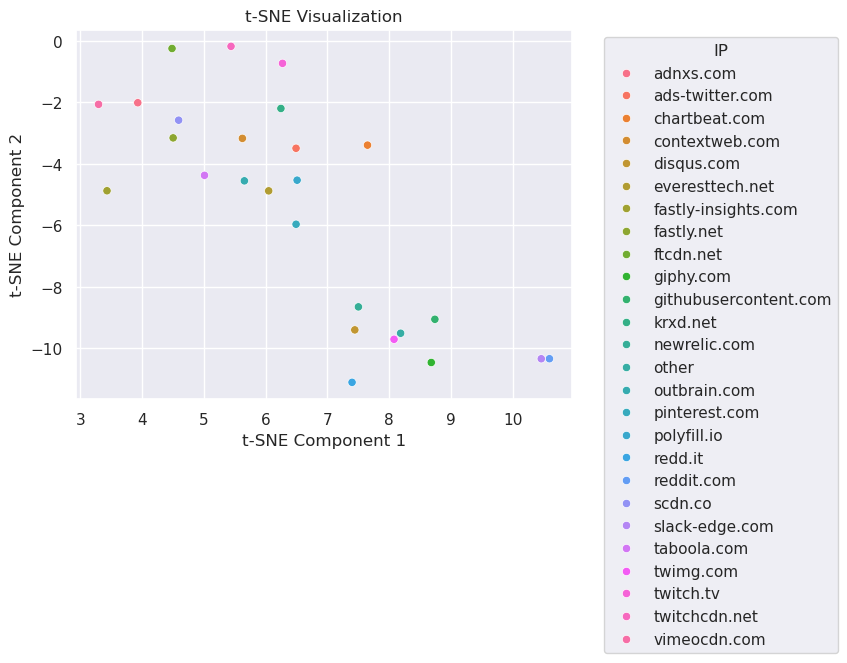

In [ ]:
palette_domain = sns.color_palette("husl", len(df_tsne_domain['label'].unique()))

sns.scatterplot(x='TSNE1', y='TSNE2', hue='label', data=df_tsne_domain, palette=palette_domain)
plt.title('t-SNE Visualization')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='IP')
plt.show()

## Plot statistics on number of bytes transmitted and the round trip time (RTT)

In [ ]:
# _c_appdataB: The number of bytes of application data sent by the client
# _c_bytes_all: The total number of bytes sent by the client
# _s_appdataB: Number of bytes of application data sent by the server
# _s_bytes_all: Total number of bytes sent by the server

In [ ]:
# By domains

In [ ]:
total_bytes_per_flow = df_dropped[['_c_bytes_all', '_s_bytes_all', 'label']].copy()
total_bytes_per_domain = total_bytes_per_flow.groupby('label').sum()
total_bytes_per_domain['total_bytes'] = total_bytes_per_domain['_c_bytes_all'] + total_bytes_per_domain['_s_bytes_all']
total_bytes_per_domain['percentage'] = total_bytes_per_domain['_s_bytes_all'] / total_bytes_per_domain['total_bytes']
total_bytes_per_domain

,_c_bytes_all,_s_bytes_all,total_bytes,percentage
label,,,,
adnxs.com,27838346.0,2.189261e+08,2.467644e+08,0.887187
ads-twitter.com,2610705.0,1.101893e+07,1.362964e+07,0.808454
chartbeat.com,3903451.0,1.505800e+07,1.896145e+07,0.794138
contextweb.com,11231706.0,2.466942e+07,3.590113e+07,0.687149
disqus.com,14756121.0,6.837102e+07,8.312714e+07,0.822487
everesttech.net,9226029.0,4.354341e+07,5.276944e+07,0.825163
fastly-insights.com,5296071.0,1.282886e+07,1.812493e+07,0.707802
fastly.net,8031468.0,2.203014e+08,2.283329e+08,0.964826
ftcdn.net,4309971.0,7.145046e+08,7.188146e+08,0.994004


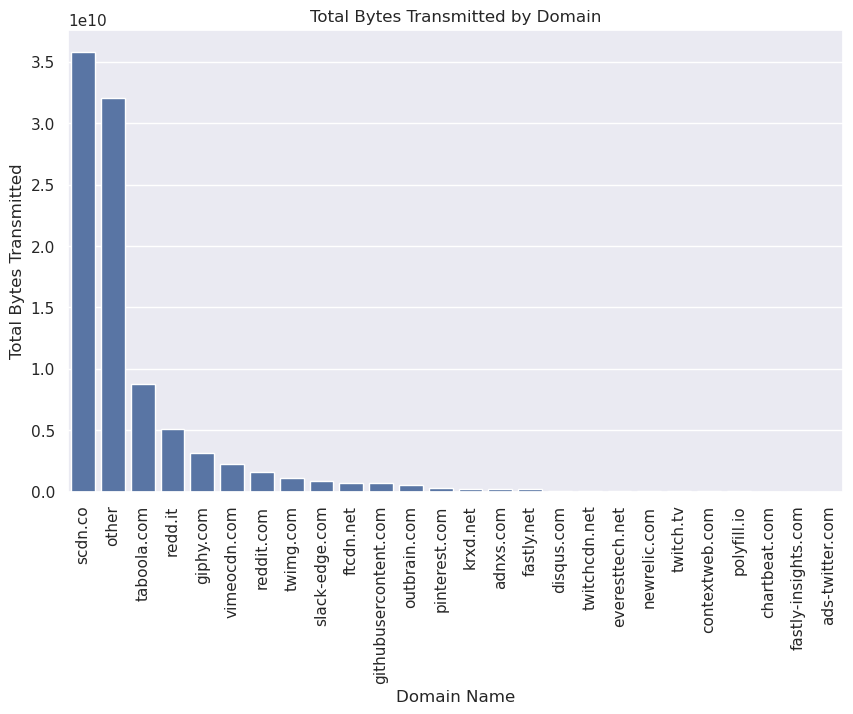

In [ ]:
plt.figure(figsize=(10, 6))
sns.barplot(data=total_bytes_per_domain.sort_values(by='total_bytes', ascending=False), x='label', y='total_bytes')
plt.xlabel('Domain Name')
plt.ylabel('Total Bytes Transmitted')
plt.title('Total Bytes Transmitted by Domain')
plt.xticks(rotation=90)
plt.show()

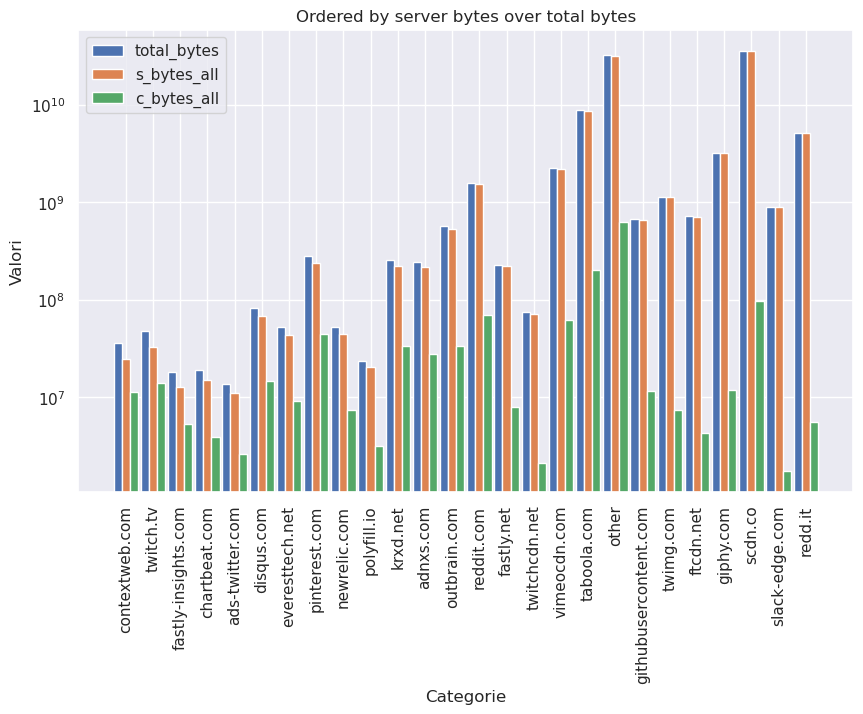

In [ ]:
total_bytes_per_domain = total_bytes_per_domain.sort_values(by='percentage')

plt.figure(figsize=(10, 6))

larghezza_barre = 0.30
posizioni_barre_serie_1 = np.arange(len(total_bytes_per_domain.index))
posizioni_barre_serie_2 = posizioni_barre_serie_1 + larghezza_barre
posizioni_barre_serie_3 = posizioni_barre_serie_2 + larghezza_barre

bar1 = plt.bar(posizioni_barre_serie_1, total_bytes_per_domain['total_bytes'], width=larghezza_barre, label='total_bytes')
bar2 = plt.bar(posizioni_barre_serie_2, total_bytes_per_domain['_s_bytes_all'], width=larghezza_barre, label='s_bytes_all')
bar3 = plt.bar(posizioni_barre_serie_3, total_bytes_per_domain['_c_bytes_all'], width=larghezza_barre, label='c_bytes_all')

plt.xlabel('Categorie')
plt.xticks(posizioni_barre_serie_2, total_bytes_per_domain.index)
plt.ylabel('Valori')
plt.title('Ordered by server bytes over total bytes')
plt.legend([bar1, bar2, bar3], ['total_bytes', 's_bytes_all', 'c_bytes_all'])
plt.xticks(rotation=90)
plt.yscale('log')

plt.show()

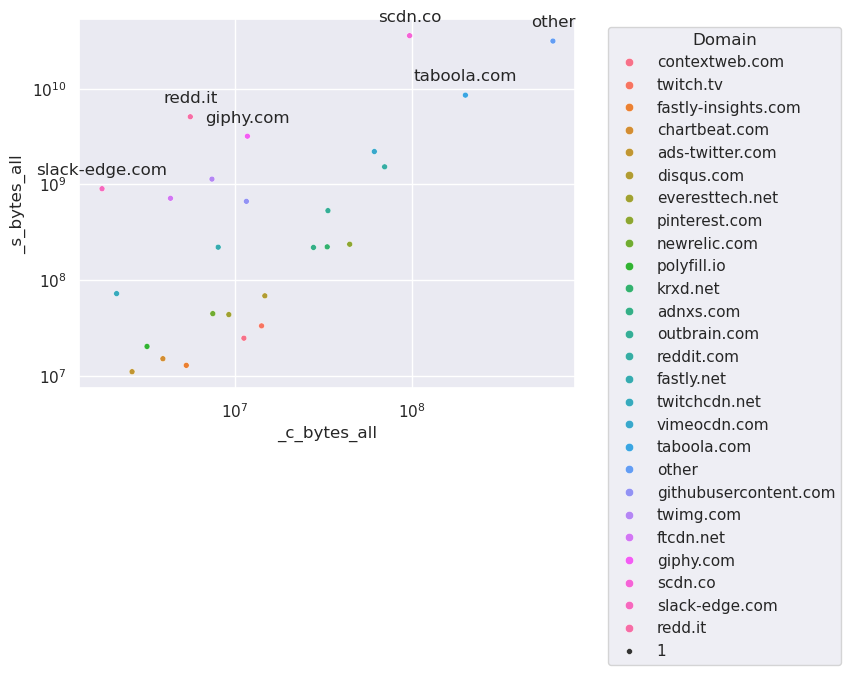

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

nomi_da_annotare = ['other', 'scdn.co', 'taboola.com', 'redd.it', 'giphy.com', 'slack-edge.com']

subset_total_bytes_per_domain = total_bytes_per_domain[total_bytes_per_domain.index.isin(nomi_da_annotare)]

sns.scatterplot(data=total_bytes_per_domain, x='_c_bytes_all', y='_s_bytes_all', hue=total_bytes_per_domain.index, size=1)
plt.yscale('log')
plt.xscale('log')

for domain, x, y in zip(subset_total_bytes_per_domain.index, subset_total_bytes_per_domain['_c_bytes_all'], subset_total_bytes_per_domain['_s_bytes_all']):
    plt.annotate(domain, (x, y), textcoords="offset points", xytext=(0, 10), ha='center')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Domain')

plt.show()

In [ ]:
# flow

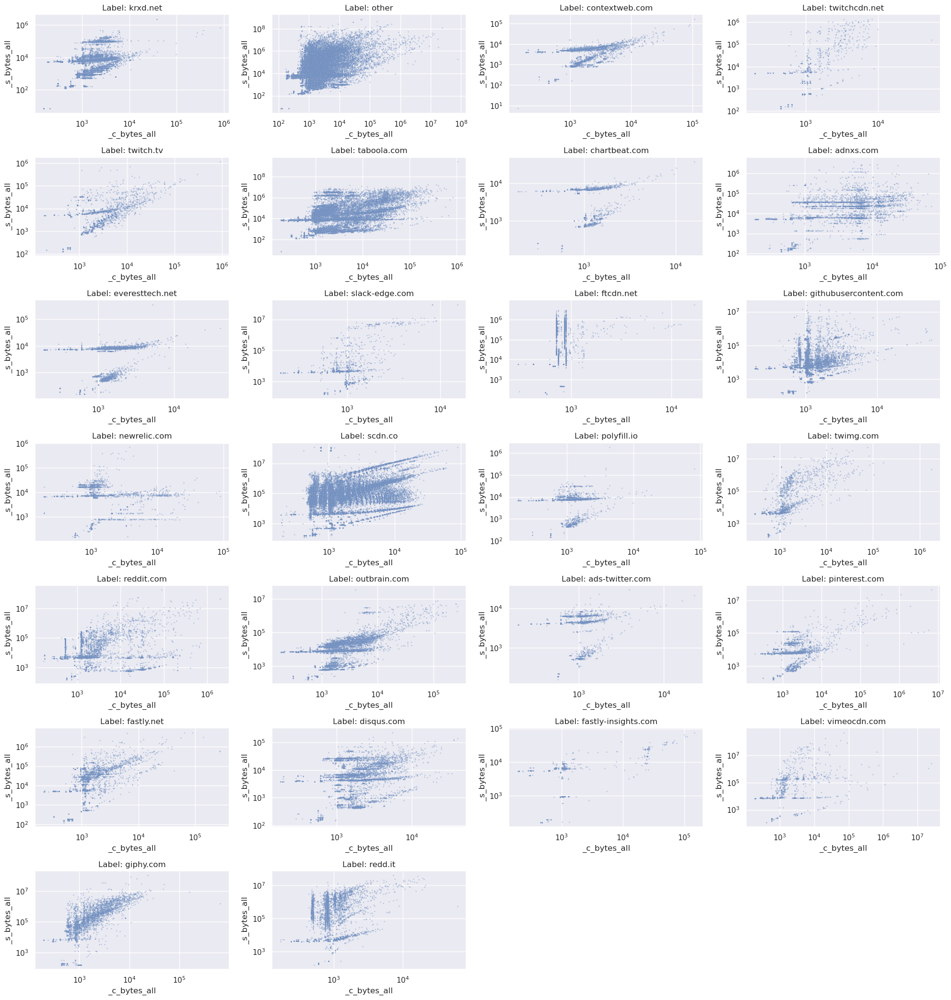

In [ ]:
labels = df_dropped['label'].unique()

num_subplots = len(labels)
num_cols = 4
num_rows = math.ceil(num_subplots / num_cols)

fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 3 * num_rows))

for i, label in enumerate(labels):
    row = i // num_cols
    col = i % num_cols

    data_subset = df_dropped.loc[df_dropped['label'] == label]

    sns.scatterplot(data=data_subset, x='_c_bytes_all', y='_s_bytes_all', alpha=0.4, s=3, ax=axes[row, col])

    axes[row, col].set_yscale('log')
    axes[row, col].set_xscale('log')

    axes[row, col].set_title(f"Label: {label}")

for i in range(num_subplots, num_rows * num_cols):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout()

plt.show()

In [ ]:
# _c_rtt_avg: Average round-trip time (RTT) for packets sent by the client
# _c_rtt_cnt: Number of RTT measurements for packets sent by the client
# _c_rtt_max: Maximum RTT for packets sent by the client
# _c_rtt_min: Minimum RTT for packets sent by the client
# _c_rtt_std: Standard deviation of the RTT for packets sent by the client

# _s_rtt_avg: Average round-trip time (RTT) for packets sent by the server
# _s_rtt_cnt: Number of RTT measurements for packets sent by the server
# _s_rtt_max: Maximum RTT for packets sent by the server
# _s_rtt_min: Minimum RTT for packets sent by the server
# _s_rtt_std: Standard deviation of the RTT for packets sent by the server

In [ ]:
total_bytes_per_domain = total_bytes_per_flow.groupby('label').sum()
total_bytes_per_domain['total_bytes'] = total_bytes_per_domain['_c_bytes_all'] + total_bytes_per_domain['_s_bytes_all']
total_bytes_per_domain['percentage'] = total_bytes_per_domain['_s_bytes_all'] / total_bytes_per_domain['total_bytes']
total_bytes_per_domain

,_c_bytes_all,_s_bytes_all,total_bytes,percentage
label,,,,
adnxs.com,27838346.0,2.189261e+08,2.467644e+08,0.887187
ads-twitter.com,2610705.0,1.101893e+07,1.362964e+07,0.808454
chartbeat.com,3903451.0,1.505800e+07,1.896145e+07,0.794138
contextweb.com,11231706.0,2.466942e+07,3.590113e+07,0.687149
disqus.com,14756121.0,6.837102e+07,8.312714e+07,0.822487
everesttech.net,9226029.0,4.354341e+07,5.276944e+07,0.825163
fastly-insights.com,5296071.0,1.282886e+07,1.812493e+07,0.707802
fastly.net,8031468.0,2.203014e+08,2.283329e+08,0.964826
ftcdn.net,4309971.0,7.145046e+08,7.188146e+08,0.994004


In [ ]:
df_rtt = df_dropped[['_c_rtt_avg', '_c_rtt_cnt', '_c_rtt_max', '_c_rtt_min', '_c_rtt_std', '_s_rtt_avg', '_s_rtt_cnt', '_s_rtt_max', '_s_rtt_min', '_s_rtt_std', 'label']].copy()
df_rtt_domain = df_rtt.groupby('label').mean()
df_rtt_domain['avg_rtt_ratio'] = df_rtt_domain['_c_rtt_avg'] / df_rtt_domain['_s_rtt_avg']
df_rtt_domain

,_c_rtt_avg,_c_rtt_cnt,_c_rtt_max,_c_rtt_min,_c_rtt_std,_s_rtt_avg,_s_rtt_cnt,_s_rtt_max,_s_rtt_min,_s_rtt_std,avg_rtt_ratio
label,,,,,,,,,,,
adnxs.com,5.643571,5.326353,15.123118,2.390083,5.841221,446.868040,10.729686,1986.394866,5.244547,833.387708,0.012629
ads-twitter.com,8.371040,6.532927,34.301310,2.370528,12.527132,906.267334,5.996341,4449.573837,3.668462,1821.264362,0.009237
chartbeat.com,8.626946,7.253674,40.897262,1.961991,14.709113,1850.264746,6.608626,7556.704855,2.083286,3424.711126,0.004663
contextweb.com,7.493962,5.128481,21.452560,2.092553,8.671436,856.071205,5.059343,3375.098262,3.424295,1578.914006,0.008754
disqus.com,7.918628,5.367191,27.273867,2.394267,10.393463,452.116045,7.113725,2102.441630,6.448743,889.444886,0.017515
everesttech.net,8.217100,6.921930,35.032541,1.979841,12.982053,666.225032,7.004760,3579.559491,4.482057,1423.798649,0.012334
fastly-insights.com,73.078797,5.174937,75.692017,71.836036,1.716132,91.326519,5.959398,503.970669,2.386534,180.247910,0.800193
fastly.net,5.133398,6.858905,15.214966,2.014074,5.539376,710.607934,23.878460,3476.754745,4.675307,1398.272120,0.007224
ftcdn.net,3.168852,4.151324,5.266179,2.038982,1.521918,35.526927,45.107863,189.865080,5.505106,54.224178,0.089196


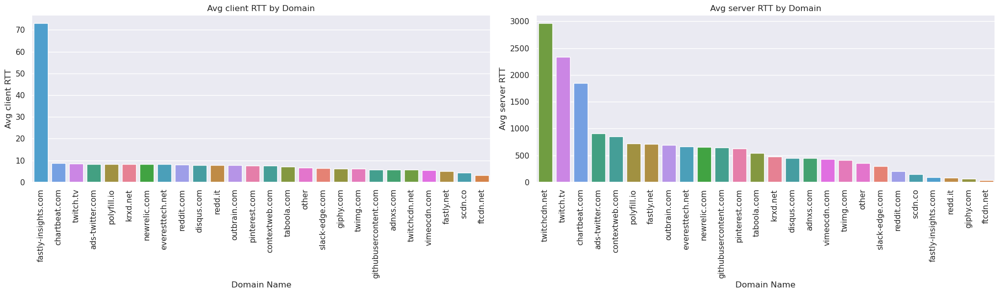

In [ ]:
palette = sns.color_palette("husl", n_colors=len(df_rtt_domain.index.unique()))

np.random.shuffle(palette)

label_color_dict = dict(zip(df_rtt_domain.index.unique(), palette))

plt.figure(figsize=(20, 6))
ax1 = plt.subplot(1, 2, 1)
sns.barplot(data=df_rtt_domain.sort_values(by='_c_rtt_avg', ascending=False), x='label', hue='label', y='_c_rtt_avg', palette=label_color_dict)
plt.xlabel('Domain Name')
plt.ylabel('Avg client RTT')
plt.title('Avg client RTT by Domain')
plt.xticks(rotation=90)

ax2 = plt.subplot(1, 2, 2)
sns.barplot(data=df_rtt_domain.sort_values(by='_s_rtt_avg', ascending=False), x='label', hue='label', y='_s_rtt_avg', palette=label_color_dict)
plt.xlabel('Domain Name')
plt.ylabel('Avg server RTT')
plt.title('Avg server RTT by Domain')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

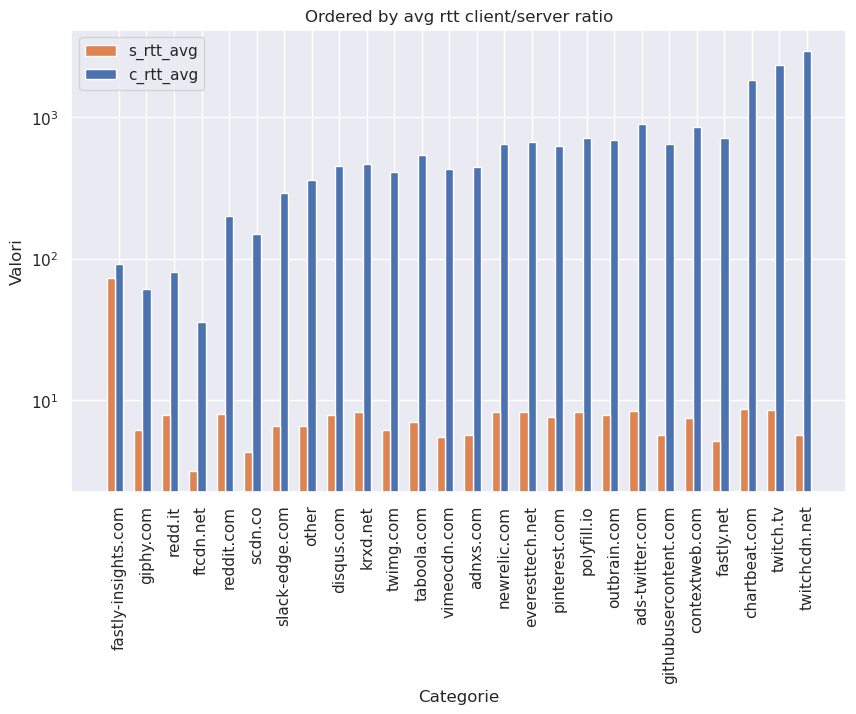

In [ ]:
df_rtt_domain = df_rtt_domain.sort_values(by='avg_rtt_ratio', ascending=False)

plt.figure(figsize=(10, 6))

larghezza_barre = 0.30
posizioni_barre_serie_1 = np.arange(len(df_rtt_domain.index))
posizioni_barre_serie_2 = posizioni_barre_serie_1 + larghezza_barre
#posizioni_barre_serie_3 = posizioni_barre_serie_2 + larghezza_barre

bar2 = plt.bar(posizioni_barre_serie_2, df_rtt_domain['_s_rtt_avg'], width=larghezza_barre, label='s_rtt_avg')
bar1 = plt.bar(posizioni_barre_serie_1, df_rtt_domain['_c_rtt_avg'], width=larghezza_barre, label='c_rtt_avg')

plt.xlabel('Categorie')
plt.xticks(posizioni_barre_serie_2, df_rtt_domain.index)
plt.ylabel('Valori')
plt.title('Ordered by avg rtt client/server ratio')
plt.legend([bar1, bar2], ['s_rtt_avg', 'c_rtt_avg'])
plt.xticks(rotation=90)
plt.yscale('log')

plt.show()

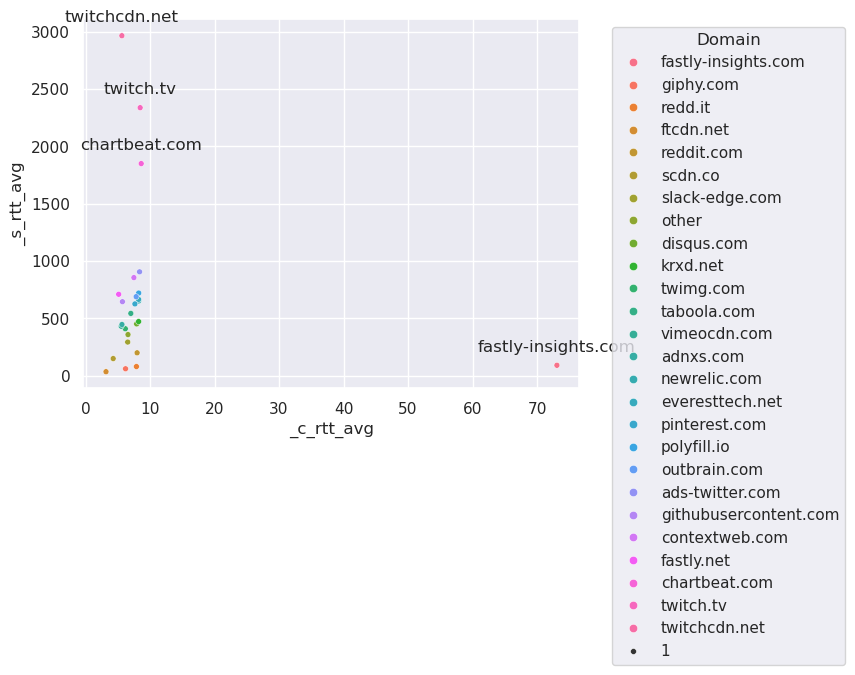

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

nomi_da_annotare = ['fastly-insights.com', 'twitchcdn.net', 'twitch.tv', 'chartbeat.com']

subset_df_rtt_domain = df_rtt_domain[df_rtt_domain.index.isin(nomi_da_annotare)]

sns.scatterplot(data=df_rtt_domain, x='_c_rtt_avg', y='_s_rtt_avg', hue=df_rtt_domain.index, size=1)

for domain, x, y in zip(subset_df_rtt_domain.index, subset_df_rtt_domain['_c_rtt_avg'], subset_df_rtt_domain['_s_rtt_avg']):
    plt.annotate(domain, (x, y), textcoords="offset points", xytext=(0, 10), ha='center')


plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Domain')

plt.show()

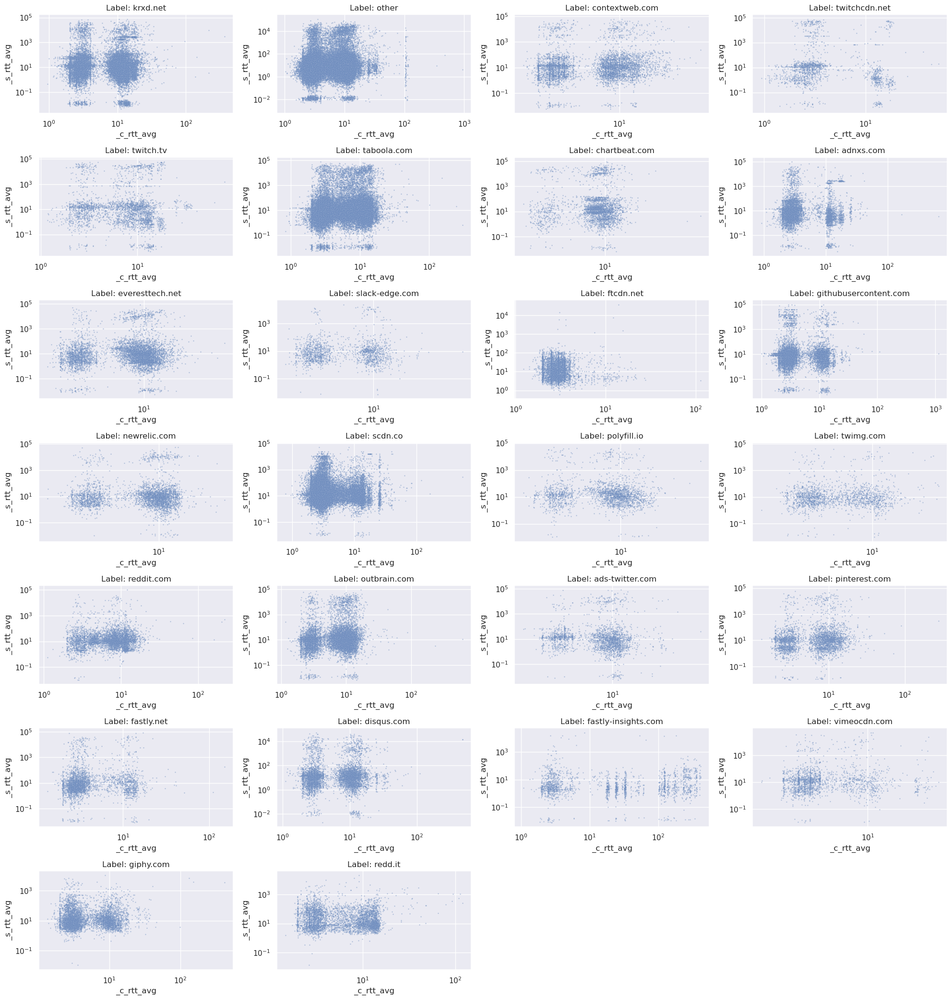

In [ ]:
labels = df_dropped['label'].unique()

num_subplots = len(labels)
num_cols = 4
num_rows = math.ceil(num_subplots / num_cols)

fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 3 * num_rows))

for i, label in enumerate(labels):
    row = i // num_cols
    col = i % num_cols

    data_subset = df_dropped.loc[df_dropped['label'] == label]

    sns.scatterplot(data=data_subset, x='_c_rtt_avg', y='_s_rtt_avg', alpha=0.4, s=3, ax=axes[row, col])

    axes[row, col].set_yscale('log')
    axes[row, col].set_xscale('log')

    axes[row, col].set_title(f"Label: {label}")

for i in range(num_subplots, num_rows * num_cols):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout()

plt.show()

# Classification

## Preparation

In [ ]:
classification_df = df_norm_scaled.drop(columns=['c_ip'])
start_test_index = df_training.index[-1] + 1
classification_df

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,label
0,-0.107564,-0.102390,0.574035,0.167195,-0.024507,-0.053287,-0.024250,0.629761,-0.120316,-0.091699,...,-0.457002,-0.069715,1.106862,0.081361,0.108048,-0.088372,-1.106843,0.193998,0.608787,krxd.net
1,-0.105436,-0.099003,-0.605697,-0.084394,-0.031887,-0.053287,-0.031646,-1.804669,-0.195093,-1.116417,...,-0.533046,-0.069715,1.106862,0.081361,0.108048,-0.089836,-1.106843,-5.154702,-1.606309,other
2,-0.108628,-0.103519,0.574035,-0.047634,-0.012732,-0.053287,-0.012449,0.629761,0.156819,-0.091699,...,-0.533901,-0.069715,1.106862,0.081361,0.108048,-0.085807,-1.106843,0.193998,0.608787,contextweb.com
3,-0.107564,-0.103519,0.108562,-0.100397,-0.029593,-0.053287,-0.029347,-0.210697,-0.131139,-1.116417,...,-0.533901,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,-1.606309,twitchcdn.net
4,-0.109692,-0.104649,-1.709188,-0.104993,-0.033197,-0.053287,-0.032959,-0.210697,-0.182303,-1.116417,...,-0.533901,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,-1.606309,twitchcdn.net
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262438,-0.087350,-0.099003,0.742568,-0.096643,-0.015297,-0.037376,-0.015112,0.629761,0.472328,-0.358126,...,2.968682,-0.069715,-0.903455,0.081361,0.108048,-0.085379,0.903467,0.193998,0.608787,other
262439,-0.102244,-0.104649,0.574035,-0.099774,-0.026266,-0.045944,-0.026056,0.629761,-0.017989,-0.091699,...,3.385088,-0.069715,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.193998,0.608787,krxd.net
262440,-0.108628,-0.103519,0.742568,-0.092478,-0.029315,-0.053287,-0.029069,0.629761,-0.144258,0.769064,...,-0.533145,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787,other
262441,-0.108628,-0.103519,-1.709188,-0.104993,-0.032072,-0.053287,-0.031831,0.629761,-0.144258,0.769064,...,-0.533847,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,0.608787,krxd.net


In [ ]:
corr_matrix = classification_df.corr(numeric_only=True)
corr_matrix

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_avg,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat
_c_ack_cnt,1.000000,0.993449,0.013663,-0.000708,0.160441,0.095049,0.160130,-0.014046,0.102324,-0.000205,...,-0.019926,-0.023120,-0.001840,0.012506,0.000886,-0.008931,0.001941,-0.012505,0.011374,-0.012943
_c_ack_cnt_p,0.993449,1.000000,0.011032,-0.000810,0.057200,0.061015,0.056935,-0.015632,0.027541,0.001483,...,-0.020269,-0.024215,-0.001588,0.014478,0.000623,-0.008947,0.000844,-0.014478,0.011114,-0.014243
_c_appdataB,0.013663,0.011032,1.000000,0.052234,0.011842,0.016640,0.011764,0.363557,0.051410,-0.190298,...,0.076571,0.239375,-0.025742,0.044127,-0.010387,-0.012193,-0.025000,-0.044112,-0.007169,0.294299
_c_appdataT,-0.000708,-0.000810,0.052234,1.000000,0.000322,0.006594,0.000285,-0.006259,0.003401,0.016494,...,0.014752,0.018741,0.114458,-0.001968,-0.002534,-0.015552,0.109056,0.001969,0.015409,-0.000957
_c_bytes_all,0.160441,0.057200,0.011842,0.000322,1.000000,0.252737,0.999985,0.005460,0.839603,-0.005872,...,-0.005718,-0.005477,-0.001146,-0.004450,0.001247,-0.001730,0.012502,0.004450,0.001072,0.002688
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
_s_ttl_min,-0.008931,-0.008947,-0.012193,-0.015552,-0.001730,-0.028461,-0.001571,-0.016464,0.002934,-0.026009,...,0.006060,-0.003476,-0.072223,-0.009859,0.744881,1.000000,-0.037047,0.009858,-0.016186,-0.015188
_s_win_max,0.001941,0.000844,-0.025000,0.109056,0.012502,0.009135,0.012468,-0.003319,0.011334,0.036275,...,-0.010008,-0.021006,0.816028,0.012510,0.002640,-0.037047,1.000000,-0.012617,0.020415,0.000582
_s_win_min,-0.012505,-0.014478,-0.044112,0.001969,0.004450,-0.006216,0.004492,0.097558,-0.011720,0.044850,...,0.118663,0.160716,-0.021953,-0.999990,-0.006991,0.009858,-0.012617,1.000000,0.226137,0.029549
_s_win_scl,0.011374,0.011114,-0.007169,0.015409,0.001072,0.008556,0.001025,-0.010211,-0.013358,0.060236,...,0.064038,0.094080,0.014364,-0.226140,-0.008075,-0.016186,0.020415,0.226137,1.000000,-0.043601


In [ ]:
# extract features having a correlation > 0.8
c = corr_matrix[corr_matrix>0.8]
s = c.unstack()
so = s.sort_values(ascending=False).reset_index()

# get strongly correlatead features removing pairs having correlation = 1 because of the diagonal, i.e., correlation between one feature and itself
so = so[(so[0].isnull()==False) & (so["level_0"] != so["level_1"])]

to_be_deleted = []
candidates = list(so["level_0"])

# get the unique set of features to be deleted. Notice that we discard one feature per time considering the case where a feature is strongly correlated with multiple features
subset_so = so
for candidate in candidates:
    if (candidate in list(subset_so["level_0"])):
        to_be_deleted.append(candidate)
        subset_so = subset_so[(subset_so["level_0"] != candidate) & (subset_so["level_1"] != candidate)]

# to_be_deleted contains the index of columns that you need to remove from both training and test sets
print(len(to_be_deleted), 'features are removed')

# remove the correlated features from bot sets
to_be_deleted.append('label')
features = classification_df.drop(columns=to_be_deleted)
labels = classification_df['label']

X_train = features.loc[:start_test_index]
y_train = labels.loc[:start_test_index]
X_test = features.loc[start_test_index:]
y_test = labels.loc[start_test_index:]

46 features are removed


In [ ]:
start_test_index = df_training.index[-1] + 1
features_pca = pca_df_result_flow.drop(columns=['label'])
labels_pca = pca_df_result_flow['label']

X_train_pca = features_pca.loc[:start_test_index]
y_train_pca = labels_pca.loc[:start_test_index]
X_test_pca = features_pca.loc[start_test_index:]
y_test_pca = labels_pca.loc[start_test_index:]

## Random Forest

In [ ]:
random_forest_model = RandomForestClassifier(random_state=42, n_jobs = n_jobs)
random_forest_model.fit(X_train, y_train)

RandomForestClassifier(n_jobs=-1, random_state=42)

### Trainset performance

In [ ]:
y_pred = random_forest_model.predict(X_train)
print(classification_report(y_train, y_pred))

                       precision    recall  f1-score   support

            adnxs.com       1.00      1.00      1.00      3839
      ads-twitter.com       1.00      1.00      1.00      1325
        chartbeat.com       1.00      1.00      1.00      1413
       contextweb.com       1.00      1.00      1.00      2824
           disqus.com       1.00      1.00      1.00      3173
      everesttech.net       1.00      1.00      1.00      3408
  fastly-insights.com       1.00      1.00      1.00      1309
           fastly.net       1.00      1.00      1.00      1869
            ftcdn.net       1.00      1.00      1.00      3455
            giphy.com       1.00      1.00      1.00      3886
githubusercontent.com       1.00      1.00      1.00      4271
             krxd.net       1.00      1.00      1.00     11144
         newrelic.com       1.00      1.00      1.00      2182
                other       1.00      1.00      1.00     35083
         outbrain.com       1.00      1.00      1.00  

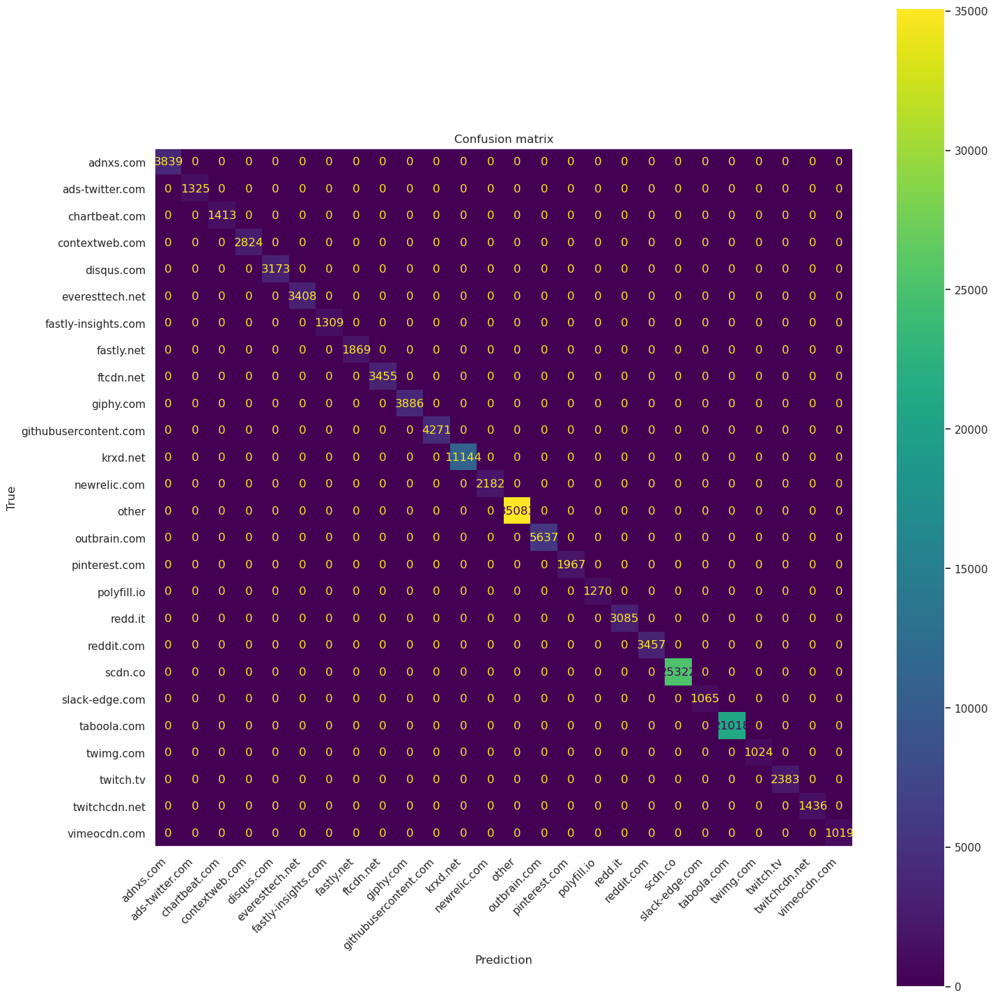

In [ ]:
confusion_train = confusion_matrix(y_train, y_pred)

cmp = ConfusionMatrixDisplay(confusion_train, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

### Testset Performance

In [ ]:
y_pred = random_forest_model.predict(X_test)
print(classification_report(y_test, y_pred))

                       precision    recall  f1-score   support

            adnxs.com       0.91      0.85      0.88      2942
      ads-twitter.com       0.95      0.78      0.85      1135
        chartbeat.com       0.94      0.91      0.93      1717
       contextweb.com       0.87      0.81      0.84      2383
           disqus.com       0.80      0.62      0.70      3246
      everesttech.net       0.93      0.82      0.87      2894
  fastly-insights.com       0.98      0.84      0.90       686
           fastly.net       0.89      0.57      0.69      1455
            ftcdn.net       0.99      0.94      0.96      1607
            giphy.com       0.92      0.86      0.89      1730
githubusercontent.com       0.87      0.81      0.84      4477
             krxd.net       0.84      0.93      0.89     11171
         newrelic.com       0.90      0.76      0.83      1604
                other       0.79      0.85      0.82     34777
         outbrain.com       0.69      0.65      0.67  

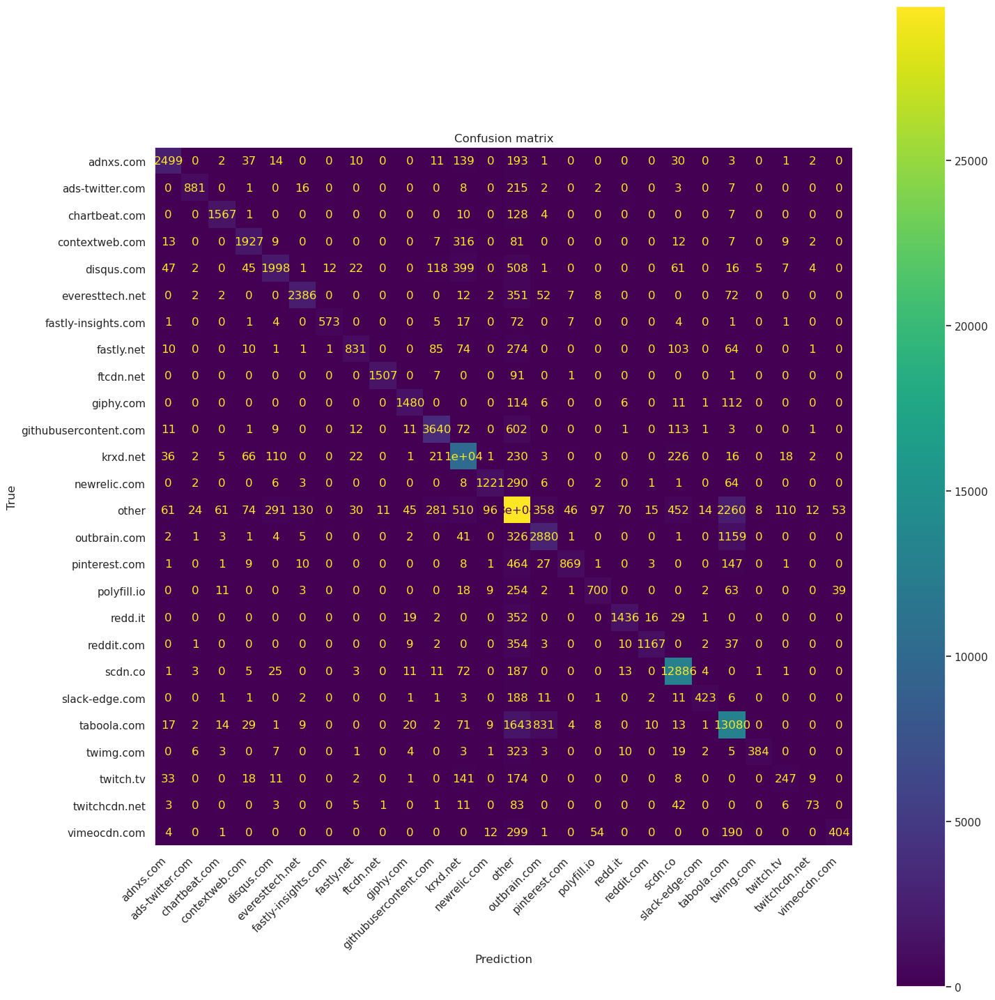

In [ ]:
confusion_test = confusion_matrix(y_test, y_pred)

cmp = ConfusionMatrixDisplay(confusion_test, display_labels=np.unique(y_test))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

In [ ]:
def plot_learning_curve(estimator, X, y, title="Learning Curve"):
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=5, n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10)
    )

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.figure()
    plt.title(title)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    plt.grid()

    plt.fill_between(
        train_sizes,
        train_scores_mean - train_scores_std,
        train_scores_mean + train_scores_std,
        alpha=0.1,
        color="r",
    )
    plt.fill_between(
        train_sizes,
        test_scores_mean - test_scores_std,
        test_scores_mean + test_scores_std,
        alpha=0.1,
        color="g",
    )

    plt.plot(train_sizes, train_scores_mean, "o-", color="r", label="Training score")
    plt.plot(train_sizes, test_scores_mean, "o-", color="g", label="Cross-validation score")

    plt.legend(loc="best")
    plt.grid(True)

    return plt

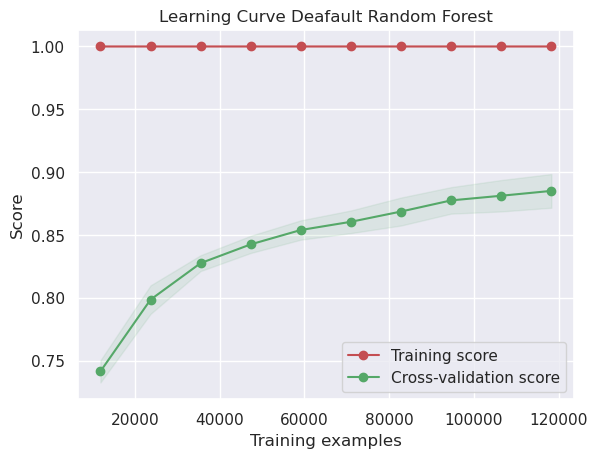

In [ ]:
plot_learning_curve(random_forest_model, X_train, y_train, title="Learning Curve Deafault Random Forest")
plt.show()

### Cross Validation

In [ ]:
# Grid of Hyperparametrs to explore
param_grid_rf = {
    'n_estimators': [50, 100],
    'max_depth': [None, 10],
    'min_samples_split': [5, 10],
    'min_samples_leaf': [2, 4],
    'criterion': ['gini', 'entropy'],
    'class_weight': [None, 'balanced']
}

grid_search_rf = GridSearchCV(RandomForestClassifier(random_state=42, n_jobs=n_jobs), param_grid_rf, cv=5, scoring='accuracy', n_jobs = n_jobs)

#grid search on the training set
grid_search_rf.fit(X_train, y_train)

print("Best Hyperparameters:", grid_search_rf.best_params_)

#Best Hyperparameters: {'class_weight': 'balanced', 'criterion': 'entropy', 'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}

In [ ]:
best_model_rf = grid_search_rf.best_estimator_

In [ ]:
#### TEST TO NOT RE DO THE CROSS VALIDATION

Best_Hyperparameters = {'class_weight': 'balanced', 'criterion': 'entropy', 'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
best_model_rf = RandomForestClassifier(
    random_state=42,
    n_jobs=n_jobs,
    class_weight=Best_Hyperparameters['class_weight'],
    criterion=Best_Hyperparameters['criterion'],
    max_depth=Best_Hyperparameters['max_depth'],
    min_samples_leaf=Best_Hyperparameters['min_samples_leaf'],
    min_samples_split=Best_Hyperparameters['min_samples_split'],
    n_estimators=Best_Hyperparameters['n_estimators']
)

In [ ]:
best_model_rf.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       min_samples_leaf=2, min_samples_split=5, n_jobs=-1,
                       random_state=42)

In [ ]:
y_pred_best_rf = best_model_rf.predict(X_train)
print("Classification Report on Train Set:")
print(classification_report(y_train, y_pred_best_rf))

Classification Report on Train Set:
                       precision    recall  f1-score   support

            adnxs.com       0.99      1.00      1.00      3839
      ads-twitter.com       0.99      1.00      1.00      1325
        chartbeat.com       0.98      1.00      0.99      1413
       contextweb.com       0.99      1.00      1.00      2824
           disqus.com       0.99      1.00      1.00      3173
      everesttech.net       0.99      1.00      0.99      3408
  fastly-insights.com       1.00      1.00      1.00      1309
           fastly.net       1.00      1.00      1.00      1869
            ftcdn.net       1.00      1.00      1.00      3455
            giphy.com       0.99      1.00      1.00      3886
githubusercontent.com       0.99      1.00      0.99      4271
             krxd.net       0.99      1.00      0.99     11144
         newrelic.com       0.98      1.00      0.99      2182
                other       1.00      0.98      0.99     35083
         outbrain.

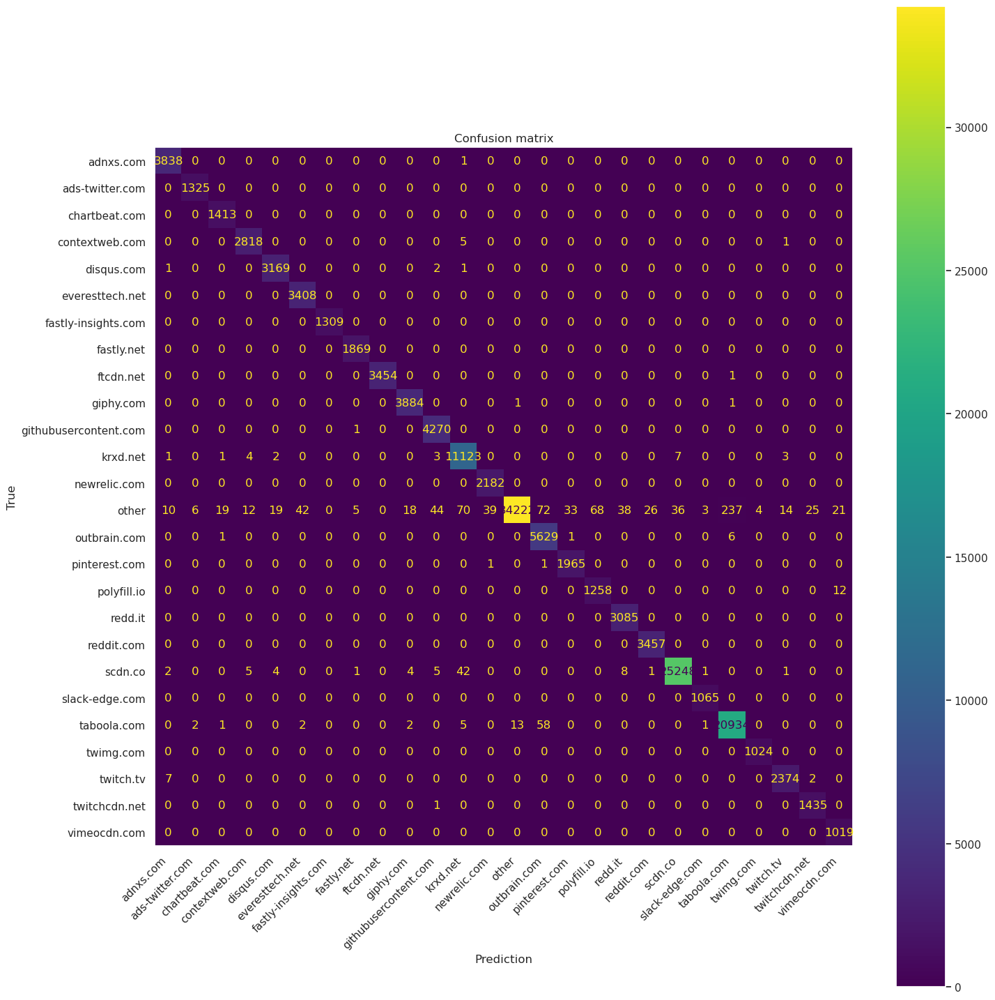

In [ ]:
confusion_best_rf = confusion_matrix(y_train, y_pred_best_rf)

cmp = ConfusionMatrixDisplay(confusion_best_rf, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

In [ ]:
y_pred_best_rf = best_model_rf.predict(X_test)
print("Classification Report on Test Set:")
print(classification_report(y_test, y_pred_best_rf))

Classification Report on Test Set:
                       precision    recall  f1-score   support

            adnxs.com       0.89      0.88      0.89      2942
      ads-twitter.com       0.85      0.88      0.87      1135
        chartbeat.com       0.89      0.95      0.92      1717
       contextweb.com       0.79      0.85      0.82      2383
           disqus.com       0.75      0.69      0.72      3246
      everesttech.net       0.89      0.87      0.88      2894
  fastly-insights.com       0.95      0.87      0.91       686
           fastly.net       0.84      0.68      0.75      1455
            ftcdn.net       0.99      0.94      0.97      1607
            giphy.com       0.89      0.87      0.88      1730
githubusercontent.com       0.82      0.89      0.85      4477
             krxd.net       0.81      0.93      0.87     11171
         newrelic.com       0.85      0.81      0.83      1604
                other       0.85      0.79      0.82     34777
         outbrain.c

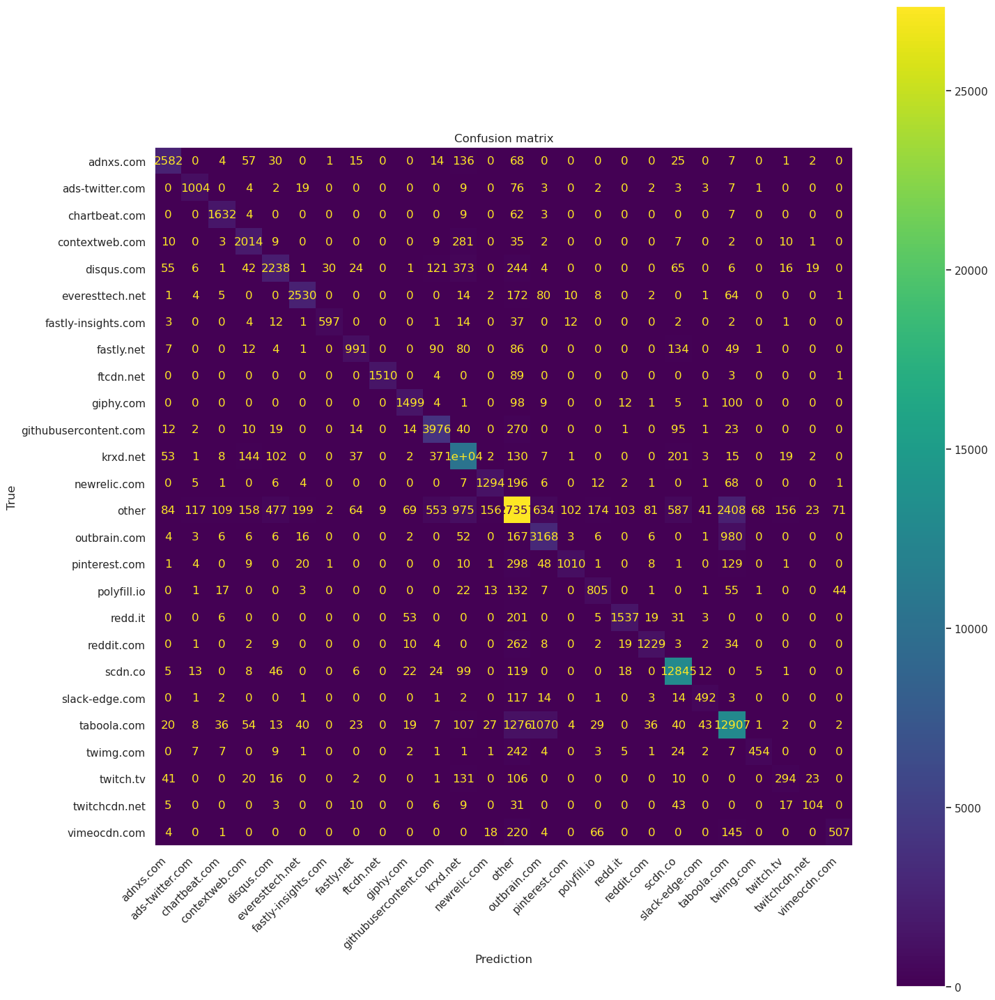

In [ ]:
confusion_best_rf = confusion_matrix(y_test, y_pred_best_rf)

cmp = ConfusionMatrixDisplay(confusion_best_rf, display_labels=np.unique(y_test))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

In [ ]:
# Get the feature importances
feature_importances = best_model_rf.feature_importances_

feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

#top 10 features
top_10_features = feature_importance_df.head(10)['Feature'].tolist()

print("Top 10 Features:")
print(top_10_features)

Top 10 Features:
['_s_appdataB', '_s_cwin_ini', '_s_cwin_max', '_c_cwin_max', '_s_pkts_data_avg', '_c_pkts_data_std', '_c_pkts_data_avg', '_s_pkts_data_std', '_s_pktsize1', '_c_appdataB']


### Learning Curve

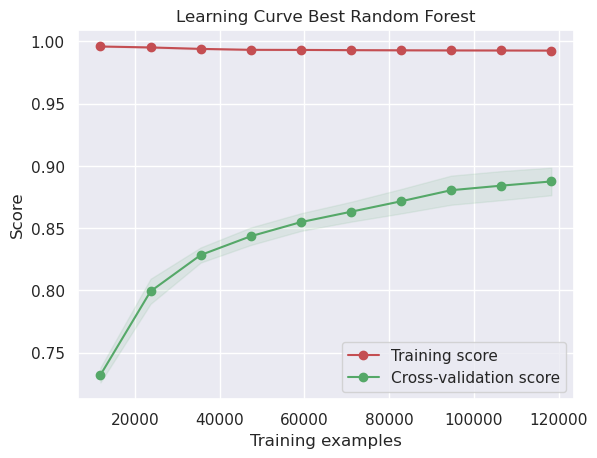

In [ ]:
plot_learning_curve(best_model_rf, X_train, y_train, title="Learning Curve Best Random Forest")
plt.show()

### False Positive/Negatives

In [ ]:
data = []
for i in range(labels.nunique()):
    class_of_interest = i
    FP = np.sum(confusion_best_rf[:, class_of_interest]) - confusion_best_rf[class_of_interest, class_of_interest]
    FN = np.sum(confusion_best_rf[class_of_interest, :]) - confusion_best_rf[class_of_interest, class_of_interest]
    data.append([np.unique(y_test)[i], FP, FN])

df_fpn = pd.DataFrame(data, columns=['Label', 'False Positives', 'False Negatives']).set_index('Label')
df_fpn['Total'] = labels.value_counts()
df_fpn['Accuracy'] = 1 - ((df_fpn['False Positives'] + df_fpn['False Negatives']) / df_fpn['Total'])
df_fpn = df_fpn.sort_values(by='False Negatives')
df_fpn

,False Positives,False Negatives,Total,Accuracy
Label,,,,
chartbeat.com,206,85,3130,0.907029
fastly-insights.com,34,89,1995,0.938346
ftcdn.net,9,97,5062,0.979060
twitchcdn.net,70,124,1664,0.883413
ads-twitter.com,173,131,2460,0.876423
slack-edge.com,115,159,1715,0.840233
giphy.com,194,231,5616,0.924323
polyfill.io,309,297,2372,0.744519
newrelic.com,220,310,3786,0.860011


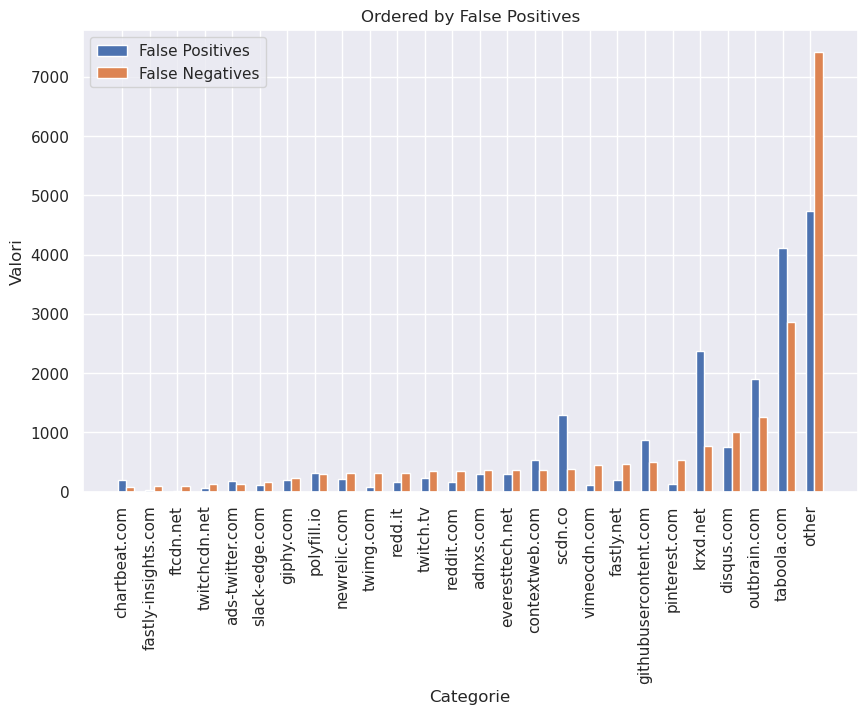

In [ ]:
plt.figure(figsize=(10, 6))

larghezza_barre = 0.30
posizioni_barre_serie_1 = np.arange(len(df_fpn.index))

bar1 = plt.bar(posizioni_barre_serie_1, df_fpn['False Positives'], width=larghezza_barre, label='False Positives')
bar2 = plt.bar(posizioni_barre_serie_1 + larghezza_barre, df_fpn['False Negatives'], width=larghezza_barre, label='False Negatives')

plt.xlabel('Categorie')
plt.xticks(posizioni_barre_serie_1, df_fpn.index)
plt.ylabel('Valori')
plt.title('Ordered by False Positives')
plt.legend([bar1, bar2], ['False Positives', 'False Negatives'])
plt.xticks(rotation=90)
# plt.yscale('log')

plt.show()

In [ ]:
indexes = []

for i, x in enumerate(y_test):
    if x != y_pred_best_rf[i]:
        indexes.append(i)

indexes = np.array(indexes) + 147863

In [ ]:
miss_classified = X_test.loc[indexes]
y_test_df = pd.DataFrame(y_test)
y_test_df['predicted'] = y_pred_best_rf
miss_classified = pd.merge(miss_classified, y_test_df, left_index=True, right_index=True)
miss_classified

,_c_appdataB,_c_appdataT,_c_bytes_retx,_c_cwin_max,_c_cwin_min,_c_fin_cnt,_c_first_ack,_c_last,_c_last_handshakeT,_c_mss,...,_s_sit_std,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,label,predicted
147870,-1.709188,-0.104993,-0.053287,-0.162296,-0.501587,0.386011,-0.101388,-0.322062,-0.066560,-0.015889,...,-0.533845,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,0.608787,other,ftcdn.net
147873,-0.112136,-0.081718,-0.053287,-0.158689,-1.116417,0.386011,-0.100337,-0.322082,-0.067298,-0.015889,...,-0.312568,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,-1.606309,other,disqus.com
147874,-0.140225,-0.078673,-0.053287,-0.188534,1.445377,0.386011,-0.098292,-0.322065,-0.067578,-0.015889,...,-0.532149,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,-1.606309,other,krxd.net
147886,0.742568,-0.093387,-0.053287,-0.144258,-1.116417,0.386011,-0.100256,-0.322148,-0.068048,-0.015889,...,-0.532819,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787,other,githubusercontent.com
147887,-1.709188,-0.104993,-0.053287,-0.144258,-0.091699,0.386011,0.091277,-0.320930,-0.049108,-0.015889,...,-0.533901,1.106862,0.081361,0.108048,-0.090083,-1.106843,0.193998,0.608787,scdn.co,disqus.com
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262399,0.574035,-0.009051,-0.053287,-0.140978,-0.501587,0.386011,0.312149,-0.150447,-0.061017,-0.015889,...,-0.273583,1.106862,0.081361,0.108048,-0.086662,-1.106843,0.193998,0.608787,fastly.net,githubusercontent.com
262402,-0.100098,-0.086151,-0.053287,-0.223955,1.445377,0.386011,-0.099674,-0.322107,-0.067986,-0.015889,...,0.006894,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,-1.606309,other,githubusercontent.com
262403,-0.104110,-0.083094,-0.053287,-0.224283,1.445377,0.386011,-0.100180,-0.322090,-0.067630,-0.015889,...,0.053725,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,-1.606309,other,githubusercontent.com
262407,0.750593,-0.093519,-0.053287,0.778653,-0.501587,0.386011,-0.108410,0.017100,-0.068083,-0.015889,...,0.973307,1.106862,0.081361,0.108048,-0.078625,-1.106843,-5.154702,0.608787,adnxs.com,contextweb.com


In [ ]:
from lime import lime_tabular, lime_image
from skimage.segmentation import mark_boundaries  # Import mark_boundaries

/opt/conda/lib/python3.11/site-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/opt/conda/lib/python3.11/site-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/opt/conda/lib/python3.11/site-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

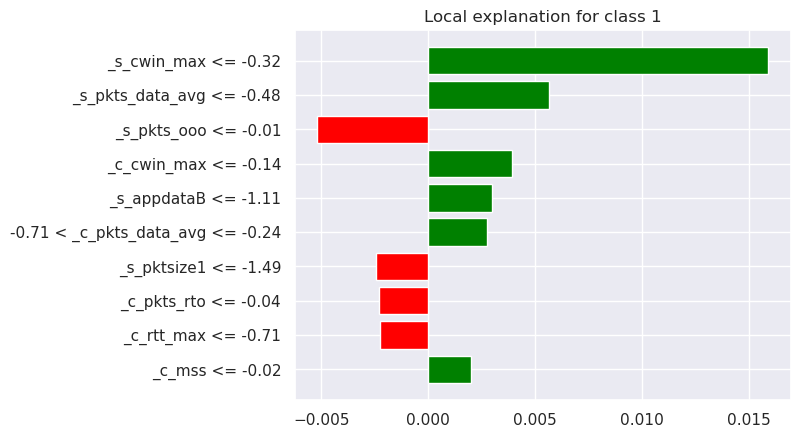

In [ ]:
# Create a LimeTabularExplainer
explainer = lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns)

# Choose a sample to explain
sample_index = 234398
sample = X_test.loc[sample_index]

# Explain the model's prediction for the selected sample
explanation = explainer.explain_instance(sample, best_model_rf.predict_proba)

# Display the explanation
exp_plot = explanation.as_pyplot_figure()
plt.show()

## k-Nearest Neighbors

In [ ]:
knn_model = KNeighborsClassifier(n_jobs=n_jobs)
knn_model.fit(X_train.values, y_train)

KNeighborsClassifier(n_jobs=-1)

### Trainset performance

In [ ]:
y_pred = knn_model.predict(X_train.values)

print(classification_report(y_train, y_pred))

                       precision    recall  f1-score   support

            adnxs.com       0.77      0.82      0.80      3839
      ads-twitter.com       0.55      0.59      0.57      1325
        chartbeat.com       0.56      0.75      0.64      1413
       contextweb.com       0.72      0.72      0.72      2824
           disqus.com       0.71      0.59      0.64      3173
      everesttech.net       0.62      0.73      0.67      3408
  fastly-insights.com       0.90      0.88      0.89      1309
           fastly.net       0.71      0.65      0.68      1869
            ftcdn.net       0.98      0.98      0.98      3455
            giphy.com       0.84      0.88      0.86      3886
githubusercontent.com       0.80      0.80      0.80      4271
             krxd.net       0.77      0.85      0.81     11144
         newrelic.com       0.60      0.56      0.58      2182
                other       0.78      0.81      0.80     35083
         outbrain.com       0.65      0.51      0.57  

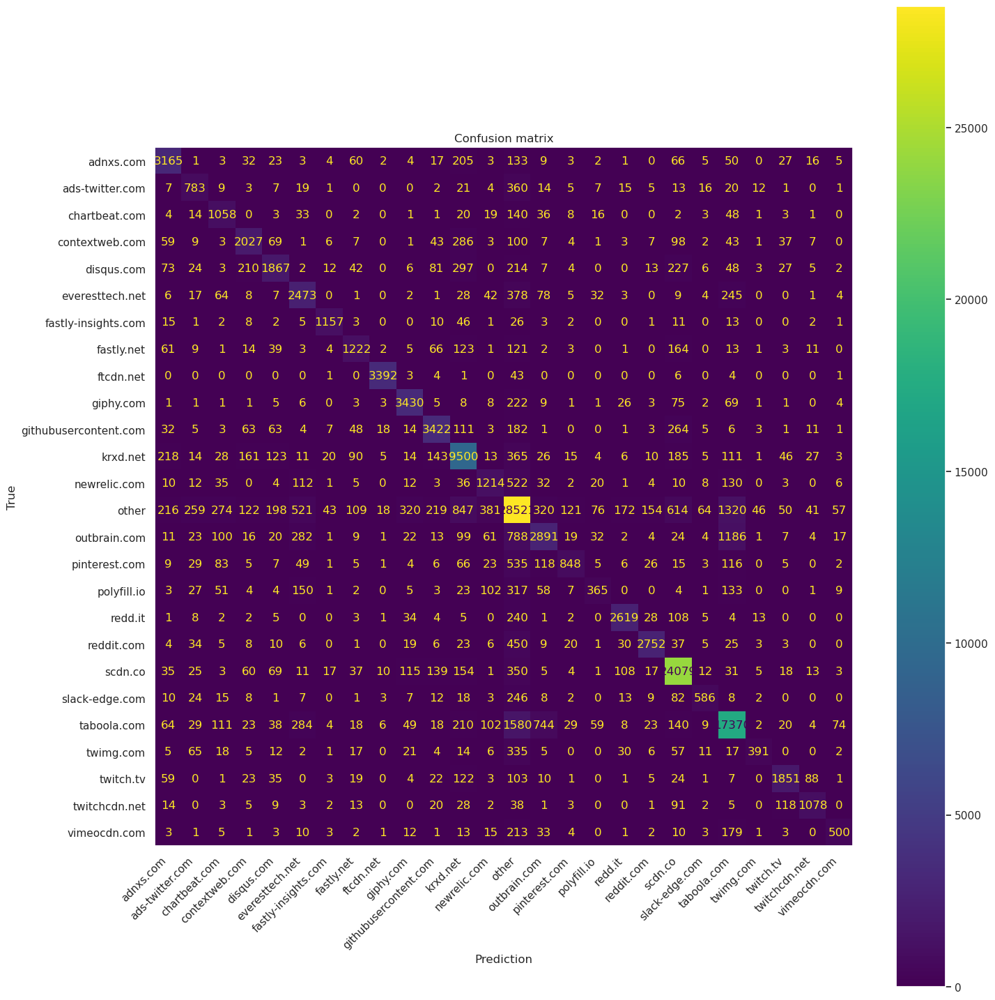

In [ ]:
confusion_train = confusion_matrix(y_train, y_pred)

cmp = ConfusionMatrixDisplay(confusion_train, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

### Testset performance

In [ ]:
y_pred = knn_model.predict(X_test.values)
print(classification_report(y_test, y_pred))

                       precision    recall  f1-score   support

            adnxs.com       0.45      0.52      0.48      2942
      ads-twitter.com       0.20      0.27      0.23      1135
        chartbeat.com       0.39      0.46      0.42      1717
       contextweb.com       0.35      0.40      0.37      2383
           disqus.com       0.29      0.21      0.24      3246
      everesttech.net       0.38      0.39      0.39      2894
  fastly-insights.com       0.35      0.70      0.46       686
           fastly.net       0.24      0.21      0.22      1455
            ftcdn.net       0.91      0.87      0.89      1607
            giphy.com       0.48      0.64      0.55      1730
githubusercontent.com       0.45      0.42      0.43      4477
             krxd.net       0.55      0.57      0.56     11171
         newrelic.com       0.31      0.29      0.30      1604
                other       0.60      0.57      0.58     34777
         outbrain.com       0.31      0.27      0.29  

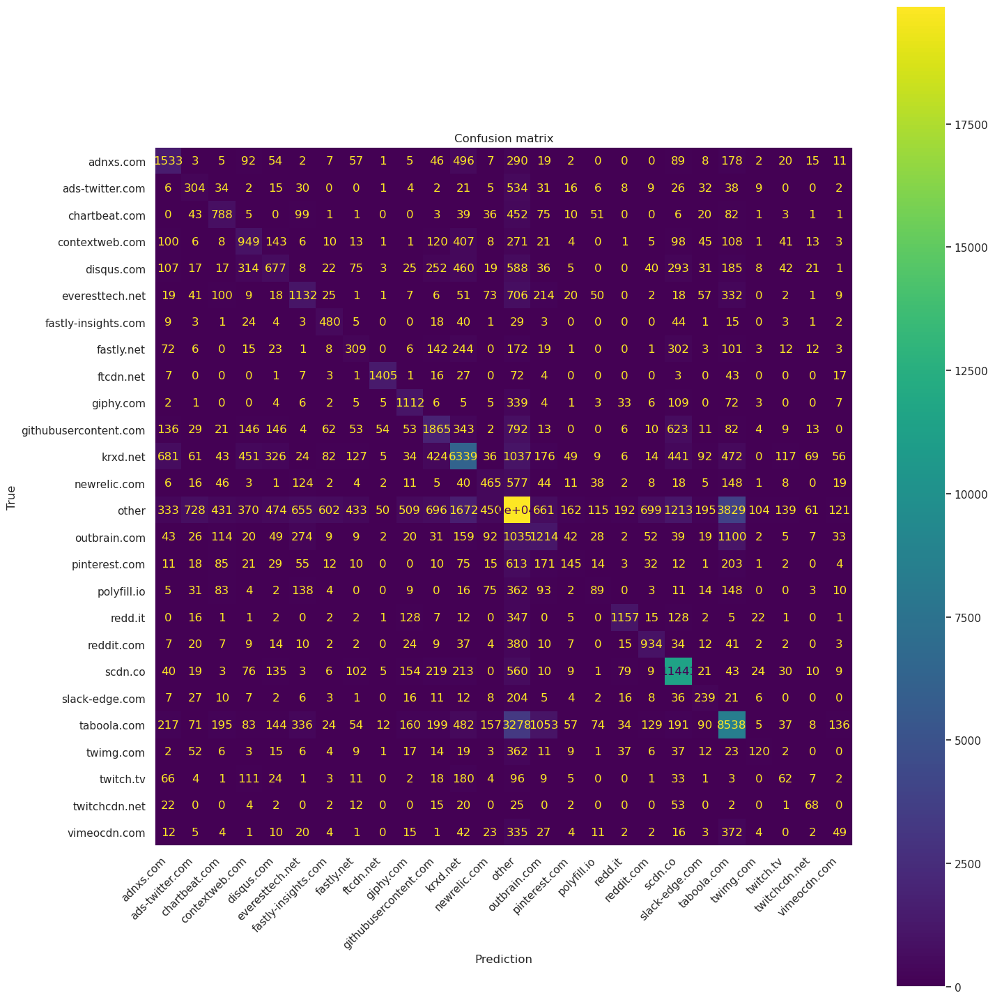

In [ ]:
confusion_test = confusion_matrix(y_test, y_pred)

cmp = ConfusionMatrixDisplay(confusion_test, display_labels=np.unique(y_test))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

### Cross Validation

In [ ]:
param_grid = {
    'n_neighbors': [3, 5, 7, 8, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]  # type of distance (1 Manhattan, 2 Euclidean)
}

label_encoder = LabelEncoder()

y_train_encoded = label_encoder.fit_transform(y_train)


grid_search = GridSearchCV(knn_model, param_grid, cv=5, scoring='accuracy', n_jobs = n_jobs)
grid_search.fit(X_train.values, y_train_encoded)

print("Migliori parametri:", grid_search.best_params_)

print("Miglior punteggio:", grid_search.best_score_)

#Best parameters : {'n_neighbors': 8, 'p': 1, 'weights': 'distance'}

In [ ]:
#### TEST TO NOT RE DO THE CROSS VALIDATION

Best_Hyperparameters_knn = {'n_neighbors': 8, 'p': 1, 'weights': 'distance'}
best_model_knn = KNeighborsClassifier(
    n_jobs=n_jobs,
    n_neighbors=Best_Hyperparameters_knn['n_neighbors'],
    p=Best_Hyperparameters_knn['p'],
    weights=Best_Hyperparameters_knn['weights'],
)

In [ ]:
label_encoder = LabelEncoder()

y_train_encoded = label_encoder.fit_transform(y_train)

best_model_knn.fit(X_train.values, y_train_encoded)

KNeighborsClassifier(n_jobs=-1, n_neighbors=8, p=1, weights='distance')

In [ ]:
y_pred_best = best_model_knn.predict(X_train.values)

y_pred_best_original = label_encoder.inverse_transform(y_pred_best)

print("Classification Report on Test Set:")
print(classification_report(y_train, y_pred_best_original))

Classification Report on Test Set:
                       precision    recall  f1-score   support

            adnxs.com       1.00      1.00      1.00      3839
      ads-twitter.com       1.00      1.00      1.00      1325
        chartbeat.com       1.00      1.00      1.00      1413
       contextweb.com       1.00      1.00      1.00      2824
           disqus.com       1.00      1.00      1.00      3173
      everesttech.net       1.00      1.00      1.00      3408
  fastly-insights.com       1.00      1.00      1.00      1309
           fastly.net       1.00      1.00      1.00      1869
            ftcdn.net       1.00      1.00      1.00      3455
            giphy.com       1.00      1.00      1.00      3886
githubusercontent.com       1.00      1.00      1.00      4271
             krxd.net       1.00      1.00      1.00     11144
         newrelic.com       1.00      1.00      1.00      2182
                other       1.00      1.00      1.00     35083
         outbrain.c

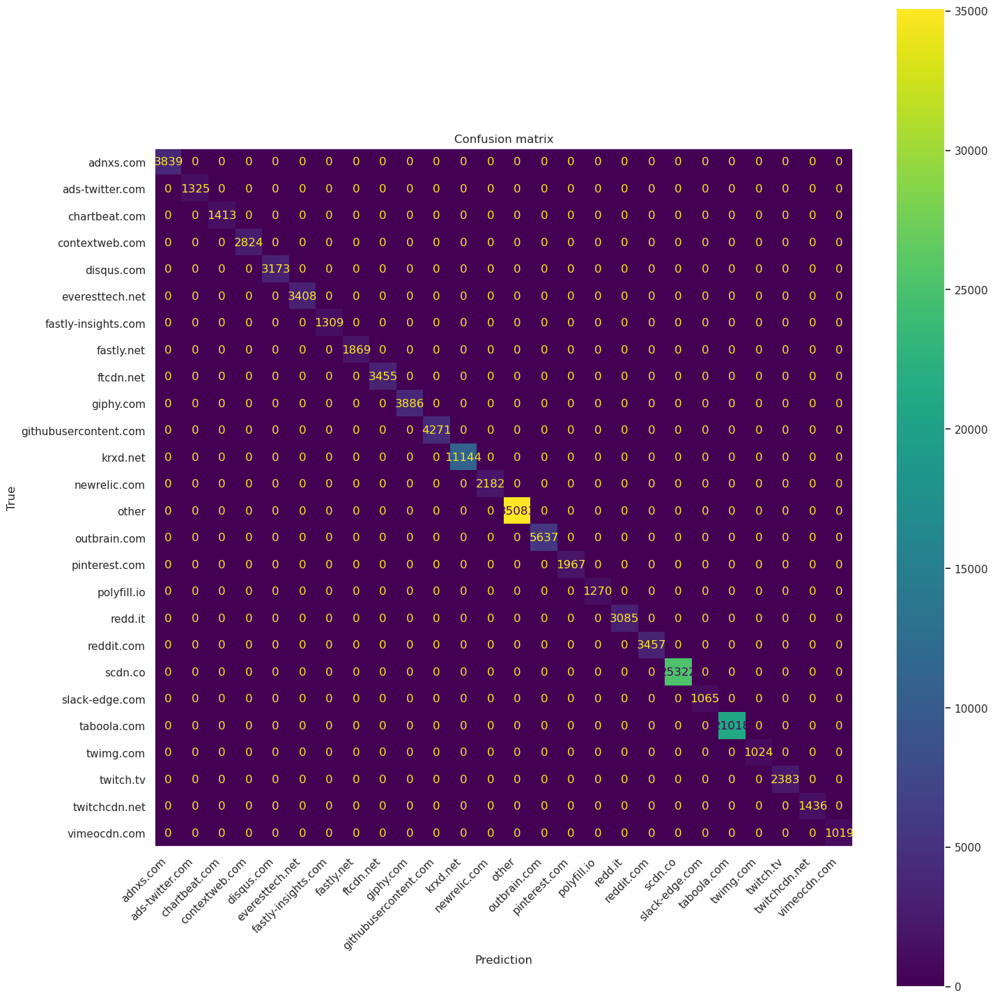

In [ ]:
confusion_best = confusion_matrix(y_train, y_pred_best_original)

cmp = ConfusionMatrixDisplay(confusion_best, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

In [ ]:
# Test set

In [ ]:
y_pred_best = best_model_knn.predict(X_test.values)
y_pred_best_original = label_encoder.inverse_transform(y_pred_best)

print("Classification Report on Test Set:")
print(classification_report(y_test, y_pred_best_original))

Classification Report on Test Set:
                       precision    recall  f1-score   support

            adnxs.com       0.61      0.58      0.60      2942
      ads-twitter.com       0.37      0.33      0.35      1135
        chartbeat.com       0.58      0.55      0.56      1717
       contextweb.com       0.53      0.48      0.50      2383
           disqus.com       0.48      0.27      0.34      3246
      everesttech.net       0.56      0.49      0.52      2894
  fastly-insights.com       0.65      0.73      0.69       686
           fastly.net       0.43      0.27      0.33      1455
            ftcdn.net       0.94      0.92      0.93      1607
            giphy.com       0.62      0.73      0.67      1730
githubusercontent.com       0.54      0.50      0.52      4477
             krxd.net       0.64      0.70      0.67     11171
         newrelic.com       0.46      0.41      0.43      1604
                other       0.66      0.64      0.65     34777
         outbrain.c

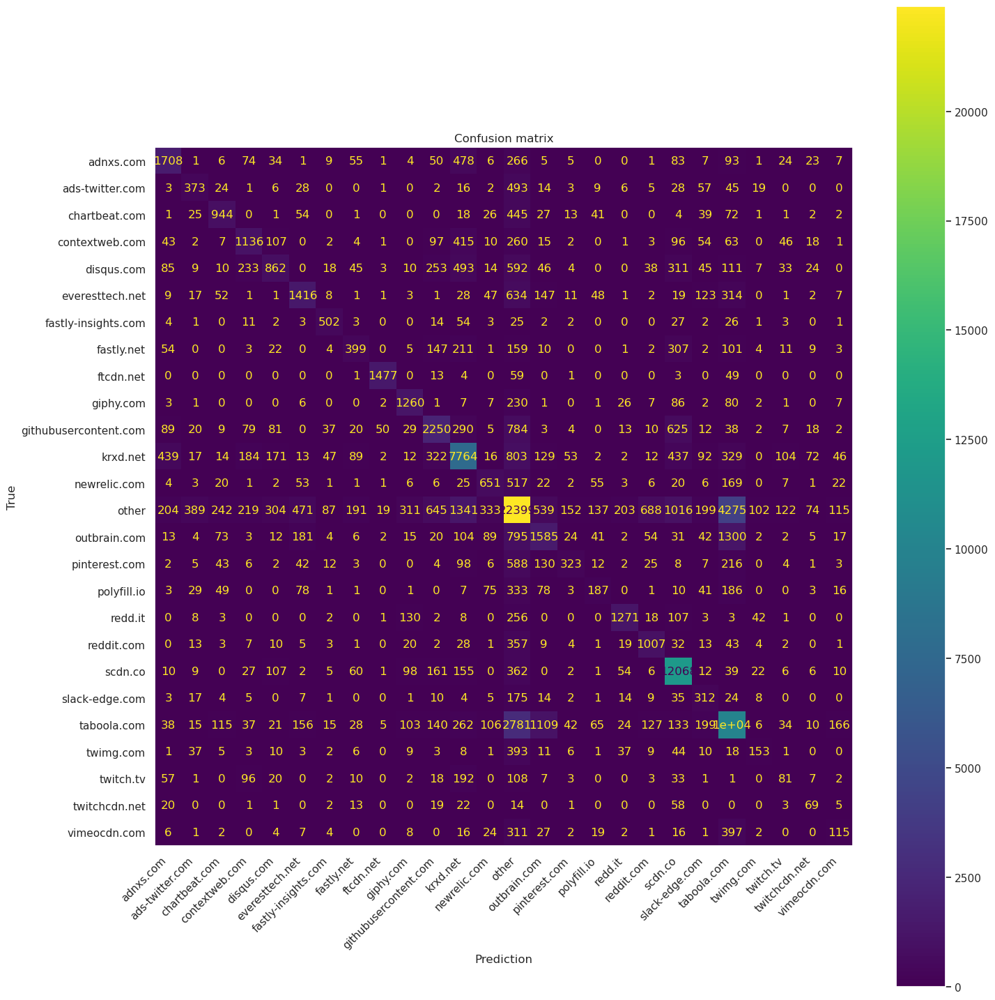

In [ ]:
confusion_best = confusion_matrix(y_test, y_pred_best_original)

cmp = ConfusionMatrixDisplay(confusion_best, display_labels=np.unique(y_test))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

### Learning Curve

In [ ]:
train_sizes, train_scores, test_scores = learning_curve(
    best_model_knn, X_train, y_train, cv=5, scoring='accuracy', n_jobs=n_jobs, random_state=42
)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

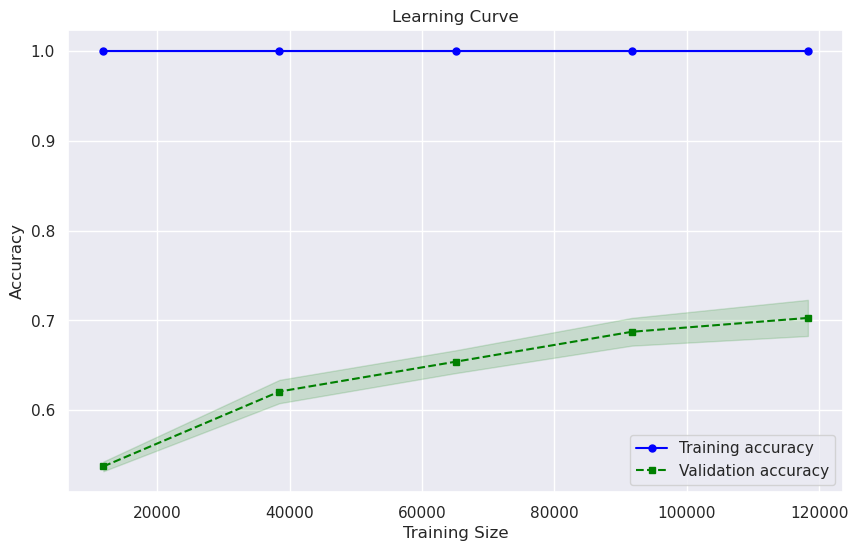

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training accuracy')
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, label='Validation accuracy')
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, alpha=0.15, color='green')

plt.title('Learning Curve')
plt.xlabel('Training Size')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

plt.grid(True)
plt.show()

### False Positve/Negatives

/opt/conda/lib/python3.11/site-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/opt/conda/lib/python3.11/site-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/opt/conda/lib/python3.11/site-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

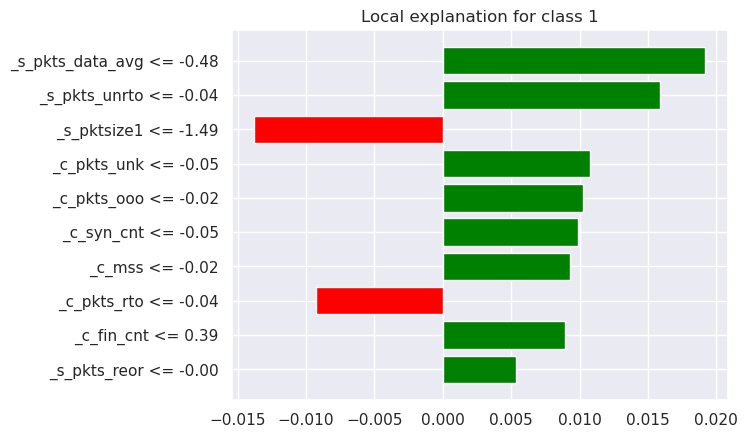

In [ ]:
# Create a LimeTabularExplainer
explainer = lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns)

# Choose a sample to explain
sample_index = 222290
sample = X_test.loc[sample_index]

# Explain the model's prediction for the selected sample
explanation = explainer.explain_instance(sample, best_model_knn.predict_proba)

exp_plot = explanation.as_pyplot_figure()
plt.show()

## Neural Network

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

label_encoder = LabelEncoder()

# label encoding
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.fit_transform(y_test)

# Neural Network creation
model = keras.Sequential([
    layers.Dense(128, activation='relu', input_shape=(len(X_train.columns),)),  # Dense layer with 128 neurons and ReLU activation function
    layers.Dropout(0.2),                                     # Dropout to prevent overfitting
    layers.Dense(y_train.nunique(), activation='softmax')                   # Output layer with 26 neurons (one for each class) and softmax as an activation function
])

model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',  # loss =  sparse_categorical_crossentropy because we have integer calsses as target
              metrics=['accuracy'])

# Training of the model
model.fit(X_train, y_train_encoded, epochs=10)

Epoch 1/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.5514 - accuracy: 0.5399
Epoch 2/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.2487 - accuracy: 0.6125
Epoch 3/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.1542 - accuracy: 0.6358
Epoch 4/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.0950 - accuracy: 0.6525
Epoch 5/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.0568 - accuracy: 0.6639
Epoch 6/10
4621/4621 [==============================] - 7s 2ms/step - loss: 1.0274 - accuracy: 0.6717
Epoch 7/10
4621/4621 [==============================] - 7s 2ms/step - loss: 1.0065 - accuracy: 0.6771
Epoch 8/10
4621/4621 [==============================] - 8s 2ms/step - loss: 0.9847 - accuracy: 0.6840
Epoch 9/10
4621/4621 [==============================] - 8s 2ms/step - loss: 0.9677 - accuracy: 0.6876
Epoch 10/10
4621/4621 [==============================] - 8s 2ms/step - loss: 0.953

In [ ]:
def create_model(optimizer='adam', activation='relu', dropout_rate=0.2):
    model = Sequential([
        Dense(128, activation=activation, input_shape=(len(X_train.columns),)),
        Dropout(dropout_rate),
        Dense(np.max(y_train_encoded) + 1, activation='softmax')
    ])
    model.compile(optimizer=optimizer,
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    return model

### Trainset Performance

In [ ]:
# Get prediction
y_pred = model.predict(X_train)

# index for the class with the highet probability
y_pred_classes = np.argmax(y_pred, axis=1)

y_pred_original = label_encoder.inverse_transform(y_pred_classes)
print(classification_report(y_train, y_pred_original))

4621/4621 [==============================] - 4s 845us/step
                       precision    recall  f1-score   support

            adnxs.com       0.73      0.67      0.70      3839
      ads-twitter.com       0.53      0.33      0.41      1325
        chartbeat.com       0.78      0.61      0.68      1413
       contextweb.com       0.77      0.74      0.76      2824
           disqus.com       0.71      0.47      0.57      3173
      everesttech.net       0.67      0.66      0.66      3408
  fastly-insights.com       0.96      0.77      0.85      1309
           fastly.net       0.79      0.49      0.60      1869
            ftcdn.net       0.95      0.97      0.96      3455
            giphy.com       0.77      0.81      0.79      3886
githubusercontent.com       0.75      0.73      0.74      4271
             krxd.net       0.67      0.85      0.75     11144
         newrelic.com       0.55      0.21      0.30      2182
                other       0.64      0.70      0.67     3

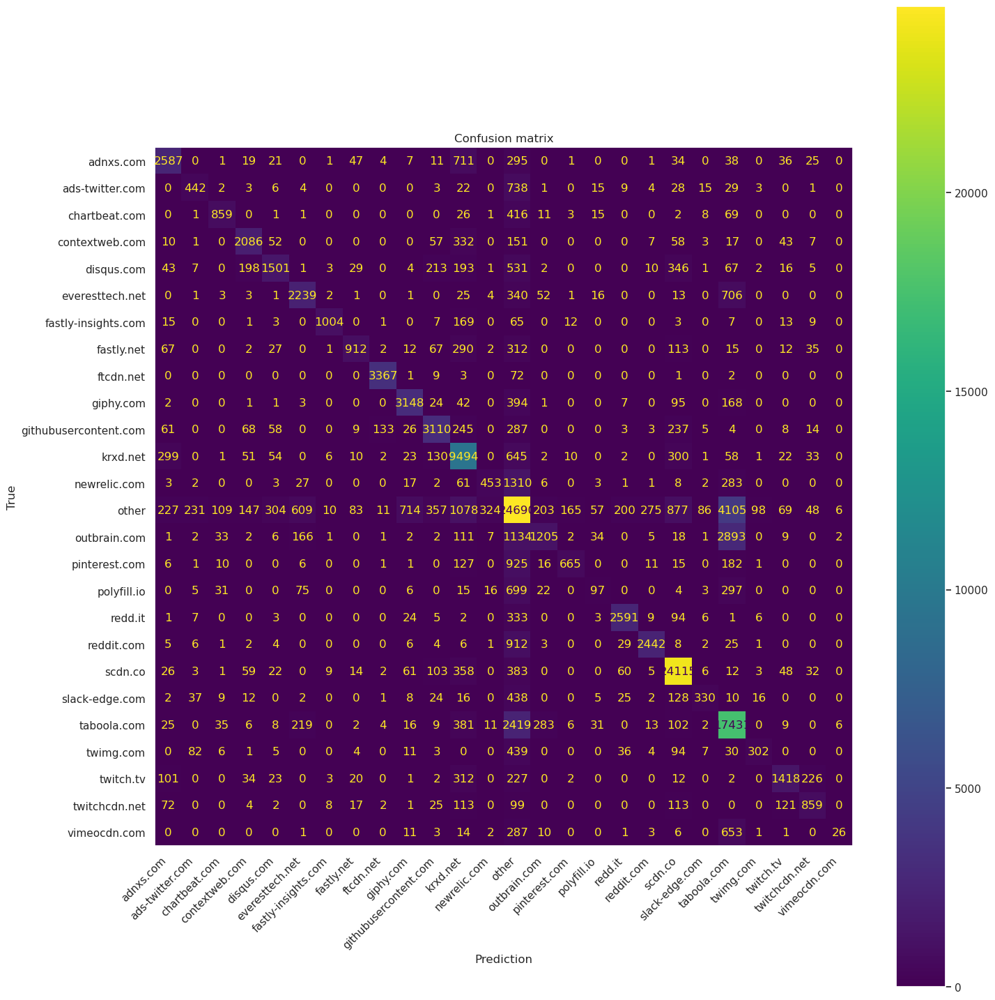

In [ ]:
confusion_train = confusion_matrix(y_train, y_pred_original)

cmp = ConfusionMatrixDisplay(confusion_train, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

### Testset Performance

In [ ]:
y_pred = model.predict(X_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_pred_original = label_encoder.inverse_transform(y_pred_classes)
print(classification_report(y_test, y_pred_original))

3581/3581 [==============================] - 3s 832us/step
                       precision    recall  f1-score   support

            adnxs.com       0.56      0.50      0.53      2942
      ads-twitter.com       0.40      0.25      0.31      1135
        chartbeat.com       0.82      0.59      0.68      1717
       contextweb.com       0.60      0.64      0.62      2383
           disqus.com       0.53      0.32      0.40      3246
      everesttech.net       0.64      0.56      0.59      2894
  fastly-insights.com       0.92      0.72      0.81       686
           fastly.net       0.68      0.36      0.47      1455
            ftcdn.net       0.94      0.91      0.92      1607
            giphy.com       0.60      0.70      0.64      1730
githubusercontent.com       0.59      0.67      0.63      4477
             krxd.net       0.59      0.76      0.67     11171
         newrelic.com       0.48      0.14      0.22      1604
                other       0.60      0.63      0.61     3

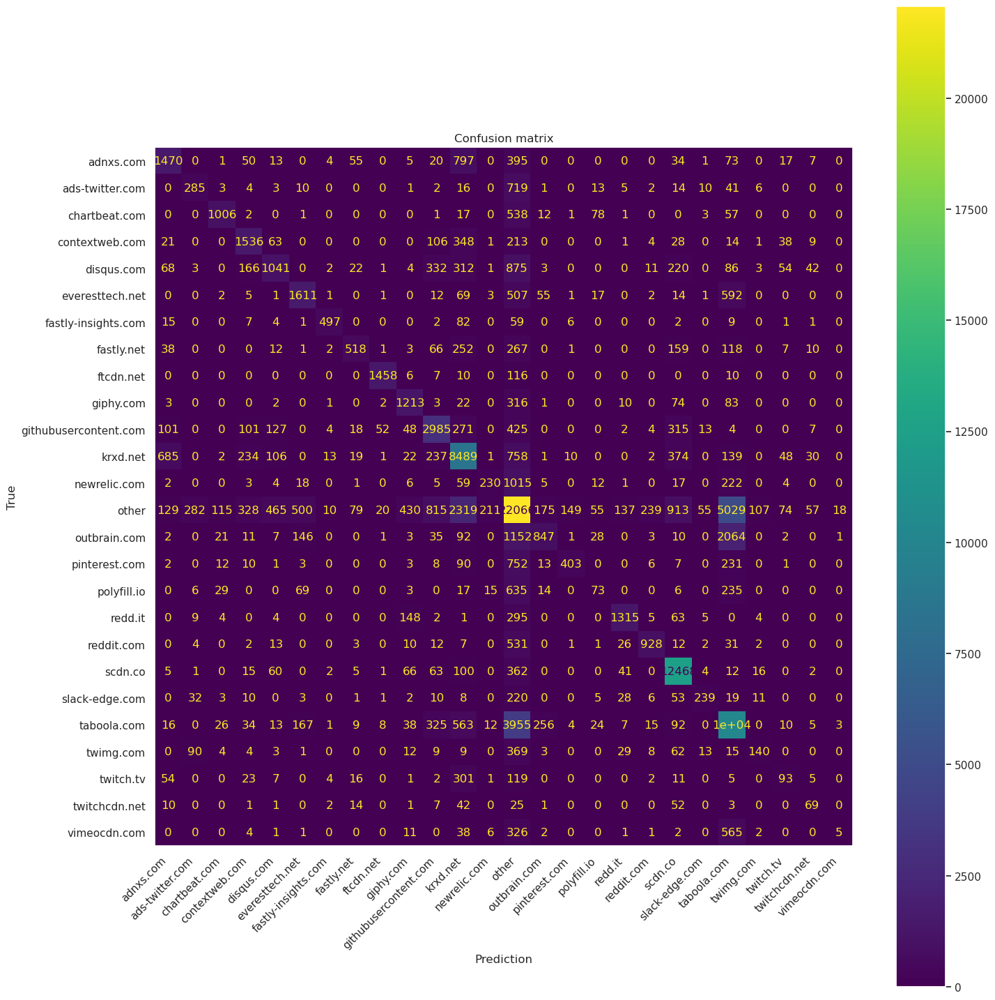

In [ ]:
confusion_train = confusion_matrix(y_test, y_pred_original)

cmp = ConfusionMatrixDisplay(confusion_train, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

### Cross Validation

Epoch 1/100
3697/3697 [==============================] - 8s 2ms/step - loss: 1.5973 - accuracy: 0.5279 - val_loss: 1.2861 - val_accuracy: 0.6060
Epoch 2/100
3697/3697 [==============================] - 7s 2ms/step - loss: 1.2837 - accuracy: 0.6002 - val_loss: 1.1589 - val_accuracy: 0.6351
Epoch 3/100
3697/3697 [==============================] - 7s 2ms/step - loss: 1.1874 - accuracy: 0.6255 - val_loss: 1.0873 - val_accuracy: 0.6590
Epoch 4/100
3697/3697 [==============================] - 7s 2ms/step - loss: 1.1242 - accuracy: 0.6436 - val_loss: 1.0335 - val_accuracy: 0.6737
Epoch 5/100
3697/3697 [==============================] - 7s 2ms/step - loss: 1.0790 - accuracy: 0.6559 - val_loss: 0.9925 - val_accuracy: 0.6849
Epoch 6/100
3697/3697 [==============================] - 7s 2ms/step - loss: 1.0435 - accuracy: 0.6656 - val_loss: 0.9701 - val_accuracy: 0.6933
Epoch 7/100
3697/3697 [==============================] - 7s 2ms/step - loss: 1.0188 - accuracy: 0.6735 - val_loss: 0.9636 - val_ac

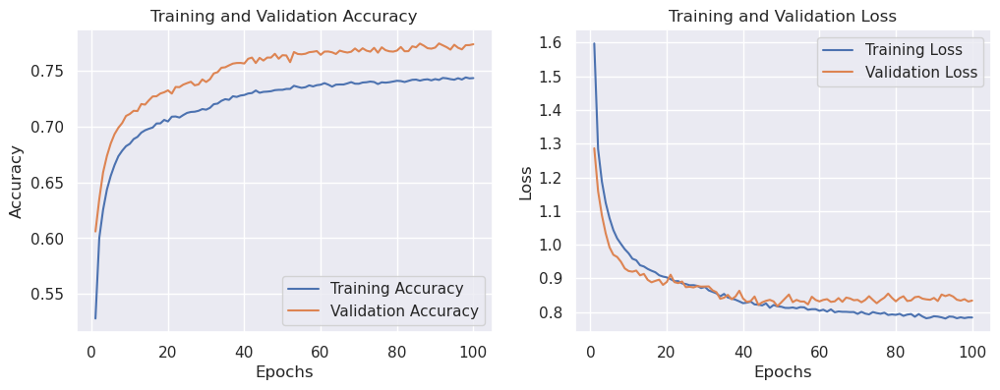

In [ ]:
X_train_s, X_val, y_train_s, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

num_epochs = 100

# Train the model with the training set and validate with the validation set
history = create_model().fit(X_train_s, y_train_s, epochs=num_epochs, validation_data=(X_val, y_val))

# Extract accuracy and loss values from the history object
train_acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
train_loss = history.history['loss']
val_loss = history.history['val_loss']

# Create an array of epochs
epochs = np.arange(1, num_epochs + 1)

# Plot the learning curve for accuracy
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(epochs, train_acc, label='Training Accuracy')
plt.plot(epochs, val_acc, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Plot the learning curve for loss
plt.subplot(1, 2, 2)
plt.plot(epochs, train_loss, label='Training Loss')
plt.plot(epochs, val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Show the plots
plt.show()

In [ ]:
#label encoding
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)

In [ ]:
# HyperParameter to look for
param_grid = {
    'optimizer': ['adam', 'sgd'],
    'activation': ['relu', 'tanh'],
    'dropout_rate': [0.2, 0.3]
}

# number of folds for the cross-validation
n_splits = 5
stratified_kfold = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

best_score = 0
best_params = {}

for optimizer in param_grid['optimizer']:
    for activation in param_grid['activation']:
        for dropout_rate in param_grid['dropout_rate']:
            scores = []

            for train_index, val_index in stratified_kfold.split(X_train, y_train_encoded):
                X_train_fold, X_val_fold = X_train.iloc[train_index], X_train.iloc[val_index]
                y_train_fold, y_val_fold = y_train_encoded[train_index], y_train_encoded[val_index]

                model = create_model(optimizer=optimizer, activation=activation, dropout_rate=dropout_rate)
                model.fit(X_train_fold, y_train_fold, epochs=5, verbose=0)

                _, score = model.evaluate(X_val_fold, y_val_fold, verbose=0)
                scores.append(score)

            avg_score = np.mean(scores)
            print(f'Mean validation accuracy for {optimizer}, {activation}, {dropout_rate}: {avg_score}')

            if avg_score > best_score:
                best_score = avg_score
                best_params = {'optimizer': optimizer, 'activation': activation, 'dropout_rate': dropout_rate}

print(f'Best parameters: {best_params}, Best validation accuracy: {best_score}')
# Best parameters: {'optimizer': 'adam', 'activation': 'relu', 'dropout_rate': 0.2}
# Best validation accuracy: 0.6803752303123474

Mean validation accuracy for adam, relu, 0.2: 0.6803752303123474
Mean validation accuracy for adam, relu, 0.3: 0.6745387792587281
Mean validation accuracy for adam, tanh, 0.2: 0.6480820655822754
Mean validation accuracy for adam, tanh, 0.3: 0.6343125462532043
Mean validation accuracy for sgd, relu, 0.2: 0.594478714466095
Mean validation accuracy for sgd, relu, 0.3: 0.5872085213661193
Mean validation accuracy for sgd, tanh, 0.2: 0.5633487820625305
Mean validation accuracy for sgd, tanh, 0.3: 0.5541308522224426
Best parameters: {'optimizer': 'adam', 'activation': 'relu', 'dropout_rate': 0.2}, Best validation accuracy: 0.6803752303123474
Epoch 1/5
4621/4621 [==============================] - 8s 2ms/step - loss: 1.5648 - accuracy: 0.5341
Epoch 2/5
4621/4621 [==============================] - 8s 2ms/step - loss: 1.2464 - accuracy: 0.6108
Epoch 3/5
4621/4621 [==============================] - 8s 2ms/step - loss: 1.1477 - accuracy: 0.6383
Epoch 4/5
4621/4621 [==============================] -

In [ ]:
## FROM THE CROSS VALIDATION
best_params = {'optimizer': 'adam', 'activation': 'relu', 'dropout_rate': 0.2}

In [ ]:
final_model = create_model(**best_params)
final_model.fit(X_train, y_train_encoded, epochs=10)

Epoch 1/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.5583 - accuracy: 0.5376
Epoch 2/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.2442 - accuracy: 0.6110
Epoch 3/10
4621/4621 [==============================] - 7s 2ms/step - loss: 1.1432 - accuracy: 0.6387
Epoch 4/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.0846 - accuracy: 0.6544
Epoch 5/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.0470 - accuracy: 0.6647
Epoch 6/10
4621/4621 [==============================] - 8s 2ms/step - loss: 1.0146 - accuracy: 0.6736
Epoch 7/10
4621/4621 [==============================] - 8s 2ms/step - loss: 0.9976 - accuracy: 0.6787
Epoch 8/10
4621/4621 [==============================] - 8s 2ms/step - loss: 0.9805 - accuracy: 0.6836
Epoch 9/10
4621/4621 [==============================] - 8s 2ms/step - loss: 0.9711 - accuracy: 0.6871
Epoch 10/10
4621/4621 [==============================] - 8s 2ms/step - loss: 0.958

In [ ]:
y_pred = final_model.predict(X_train)

y_pred_classes = np.argmax(y_pred, axis=1)

y_pred_original = label_encoder.inverse_transform(y_pred_classes)
print(classification_report(y_train, y_pred_original))

4621/4621 [==============================] - 4s 828us/step
                       precision    recall  f1-score   support

            adnxs.com       0.84      0.54      0.66      3839
      ads-twitter.com       0.59      0.13      0.21      1325
        chartbeat.com       0.73      0.53      0.61      1413
       contextweb.com       0.79      0.70      0.74      2824
           disqus.com       0.70      0.51      0.59      3173
      everesttech.net       0.65      0.67      0.66      3408
  fastly-insights.com       0.95      0.78      0.85      1309
           fastly.net       0.71      0.37      0.49      1869
            ftcdn.net       0.96      0.97      0.96      3455
            giphy.com       0.83      0.78      0.80      3886
githubusercontent.com       0.81      0.67      0.73      4271
             krxd.net       0.66      0.85      0.75     11144
         newrelic.com       0.63      0.13      0.21      2182
                other       0.62      0.74      0.68     3

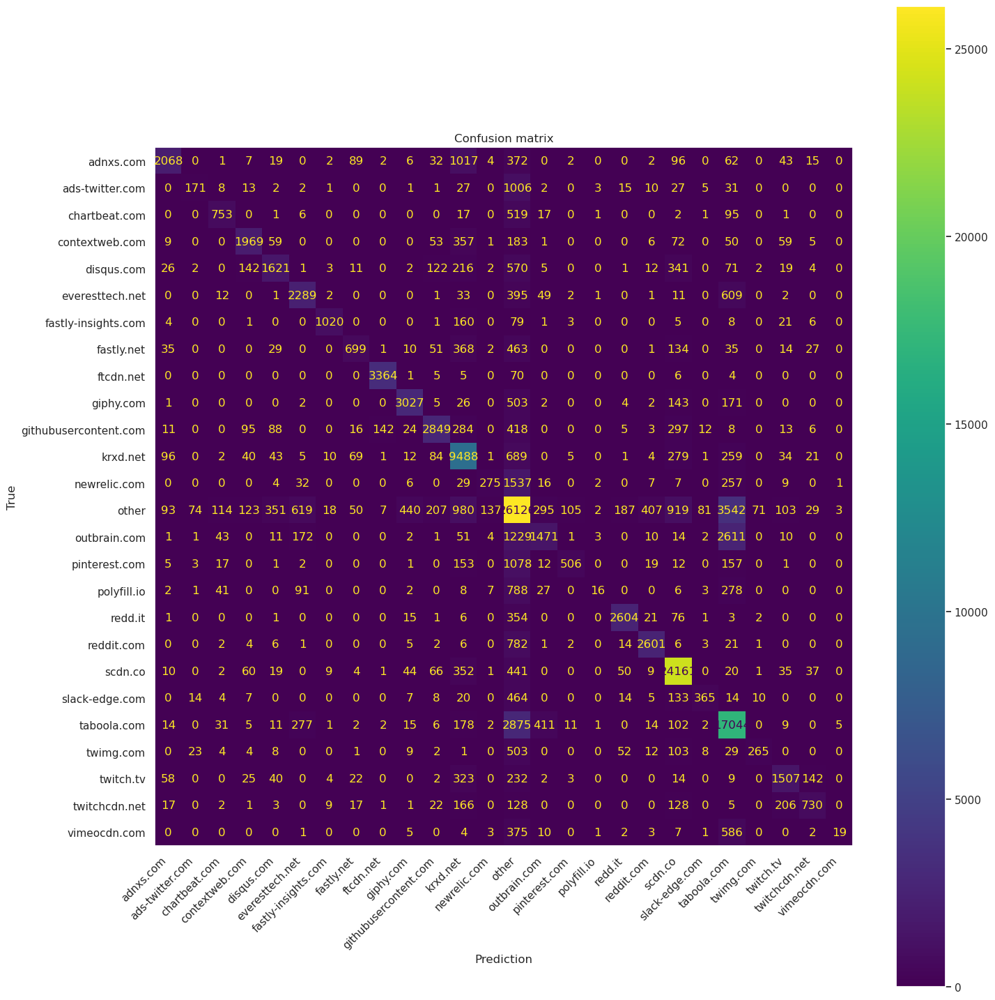

In [ ]:
confusion_train = confusion_matrix(y_train, y_pred_original)

cmp = ConfusionMatrixDisplay(confusion_train, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

In [ ]:
y_pred = final_model.predict(X_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_pred_original = label_encoder.inverse_transform(y_pred_classes)
print(classification_report(y_test, y_pred_original))

3581/3581 [==============================] - 3s 837us/step
                       precision    recall  f1-score   support

            adnxs.com       0.76      0.41      0.53      2942
      ads-twitter.com       0.50      0.09      0.15      1135
        chartbeat.com       0.78      0.54      0.64      1717
       contextweb.com       0.64      0.59      0.61      2383
           disqus.com       0.51      0.35      0.41      3246
      everesttech.net       0.61      0.56      0.58      2894
  fastly-insights.com       0.91      0.72      0.81       686
           fastly.net       0.60      0.27      0.37      1455
            ftcdn.net       0.95      0.90      0.93      1607
            giphy.com       0.68      0.67      0.67      1730
githubusercontent.com       0.66      0.49      0.56      4477
             krxd.net       0.61      0.76      0.67     11171
         newrelic.com       0.50      0.08      0.15      1604
                other       0.58      0.68      0.62     3

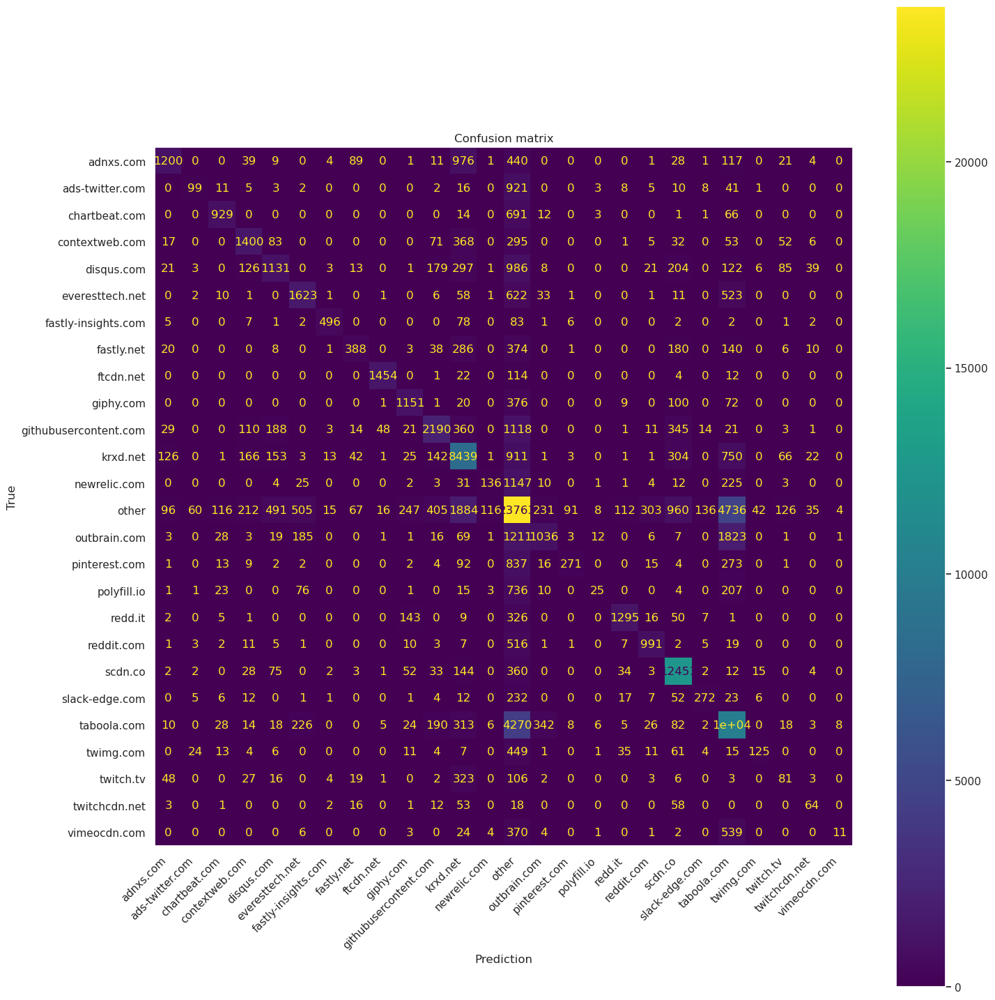

In [ ]:
confusion_train = confusion_matrix(y_test, y_pred_original)

cmp = ConfusionMatrixDisplay(confusion_train, display_labels=np.unique(y_train))
fig, ax = plt.subplots(figsize=(15,15))
cmp.plot(ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
plt.xlabel('Prediction')
plt.ylabel('True')
plt.title('Confusion matrix')
plt.tight_layout()
plt.grid(visible=None)
plt.show()

# Clustering

In [ ]:
X = domain
y = domain.index
domain

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,_c_fin_cnt,...,_s_seg_cnt,_s_sit1,_s_sit_avg,_s_sit_std,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_tls_session_stat
label,,,,,,,,,,,,,,,,,,,,,
adnxs.com,-0.103308,-0.101261,-0.517418,-0.096652,-0.027933,-0.027834,0.629761,-0.110805,-0.091699,0.386011,...,-0.089534,-0.073680,-0.339835,-0.526632,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787
ads-twitter.com,-0.102244,-0.101261,0.574035,-0.091307,-0.029066,-0.028847,0.629761,-0.144258,-0.358126,0.386011,...,-0.089534,-0.073680,-0.039700,-0.094594,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787
chartbeat.com,-0.100117,-0.101261,0.742568,-0.091899,-0.027420,-0.027284,0.629761,-0.144258,-0.358126,0.386011,...,-0.088846,-0.073680,0.129206,-0.025911,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787
contextweb.com,-0.104372,-0.102390,0.742568,-0.089550,-0.026081,-0.025927,0.629761,-0.060953,-0.091699,0.386011,...,-0.089877,-0.073680,-0.132122,-0.278361,-0.903455,0.081361,0.108048,-0.088659,0.903467,0.608787
disqus.com,-0.100117,-0.100132,0.742568,-0.091437,-0.024763,-0.024735,0.629761,-0.049474,-0.091699,0.386011,...,-0.089534,-0.073680,-0.232699,-0.360901,1.106862,0.081361,0.108048,-0.088372,-1.106843,0.608787
everesttech.net,-0.100117,-0.100132,0.742568,-0.086235,-0.026936,-0.026748,0.629761,-0.098670,-0.358126,0.386011,...,-0.088502,-0.073680,-0.218059,-0.256944,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.608787
fastly-insights.com,-0.106500,-0.102390,0.742568,-0.073689,-0.028731,-0.028490,0.629761,-0.138027,0.769064,0.386011,...,-0.089534,-0.073680,-0.376984,-0.533358,-0.903455,-4.137310,-2.996564,-0.089228,0.903467,0.608787
fastly.net,-0.093733,-0.093358,0.742568,-0.088286,-0.027363,-0.027141,0.629761,-0.121956,-0.091699,0.386011,...,-0.084033,-0.073680,-0.326540,-0.438533,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.608787
ftcdn.net,-0.105436,-0.100132,-1.709188,-0.104993,-0.030583,-0.030354,0.144324,-0.166232,-0.501587,0.386011,...,-0.087815,-0.072187,-0.377350,-0.533615,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.608787


## LASSO feature selection

In [ ]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Apply LASSO regression for feature selection
lasso = Lasso(alpha=0.1)  # You can adjust the alpha parameter for the desired level of regularization
lasso.fit(X, y_encoded)

# Get the feature selection mask
feature_mask = lasso.coef_ != 0

domain_lasso = domain.loc[:, feature_mask]
domain_lasso

,_c_appdataB,_c_cwin_ini,_c_msgsize1,_c_mss_min,_c_pkts_data_avg,_c_pktsize1,_c_rst_cnt,_c_rtt_std,_c_ttl_max,_c_win_min,_s_appdataB,_s_msgsize1,_s_mss_max,_s_pkts_data_avg,_s_pktsize1,_s_sit_std,_tls_session_stat
label,,,,,,,,,,,,,,,,,
adnxs.com,-0.517418,0.629761,0.630474,-0.306851,0.186730,0.630490,0.536672,-0.751711,0.912331,0.562684,-1.106620,0.497891,0.433471,0.426124,0.655572,-0.526632,0.608787
ads-twitter.com,0.574035,0.629761,0.630474,-0.169343,-0.721099,0.630490,0.536672,0.748965,0.912331,0.562684,0.277313,0.036789,0.433471,-0.577446,0.676595,-0.094594,0.608787
chartbeat.com,0.742568,0.629761,0.630474,-0.306851,-0.737063,0.630490,0.536672,0.763559,0.912331,-0.900335,0.987610,0.874949,0.401868,-0.662218,0.655572,-0.025911,0.608787
contextweb.com,0.742568,0.629761,0.630474,0.086029,0.423305,0.630490,0.536672,0.296446,0.912331,0.562684,0.323491,0.086834,0.401868,-0.154541,0.655572,-0.278361,0.608787
disqus.com,0.742568,0.629761,0.630474,-0.306851,0.436768,0.630490,0.536672,0.585652,-1.059833,0.562684,0.199410,0.020744,0.401868,-0.104049,0.655572,-0.360901,0.608787
everesttech.net,0.742568,0.629761,0.630474,-0.169343,-0.417977,0.630490,0.536672,0.775905,0.912331,0.562684,1.455031,1.313130,0.433471,-0.435363,0.676595,-0.256944,0.608787
fastly-insights.com,0.742568,0.629761,0.630474,0.911077,0.446385,0.630490,-1.863337,-0.755256,0.881026,0.562684,0.810653,0.608678,0.433471,0.063479,0.676595,-0.533358,0.608787
fastly.net,0.742568,0.629761,0.630474,0.086029,0.304537,0.630490,0.536672,-0.746830,0.818418,0.562684,0.535347,0.384812,0.401868,0.650315,0.655572,-0.438533,0.608787
ftcdn.net,-1.709188,0.144324,0.144882,-0.306851,0.002087,0.144945,-1.863337,-0.754933,0.943635,0.562684,-1.114727,-1.373261,0.401868,0.668155,-1.529087,-0.533615,0.608787


In [ ]:
X = domain_lasso
y = domain_lasso.index

In [ ]:
selected_features = domain.columns[feature_mask]
print("Selected Features:", selected_features)

Selected Features: Index(['_c_appdataB', '_c_cwin_ini', '_c_msgsize1', '_c_mss_min',
       '_c_pkts_data_avg', '_c_pktsize1', '_c_rst_cnt', '_c_rtt_std',
       '_c_ttl_max', '_c_win_min', '_s_appdataB', '_s_msgsize1', '_s_mss_max',
       '_s_pkts_data_avg', '_s_pktsize1', '_s_sit_std', '_tls_session_stat'],
      dtype='object')


## KMeans

In [ ]:
inertia_values_kmeanspp = []
silhouette_scores_kmeanspp = []
inertia_values_random = []
silhouette_scores_random = []

for i in range(2, 24):
    # KMeans inizialization 'k-means++'
    kmeans_pp = KMeans(n_clusters=i, random_state=42, n_init='auto', init='k-means++')
    kmeans_pp.fit(X)

    # inertia and silhouette for 'k-means++'
    inertia_values_kmeanspp.append(kmeans_pp.inertia_)
    silhouette_scores_kmeanspp.append(silhouette_score(X, kmeans_pp.labels_))

    # inizializzation with 'random'
    kmeans_random = KMeans(n_clusters=i, random_state=42, n_init='auto', init='random')
    kmeans_random.fit(X)

    # inertia and silhouette for 'random'
    inertia_values_random.append(kmeans_random.inertia_)
    silhouette_scores_random.append(silhouette_score(X, kmeans_random.labels_))

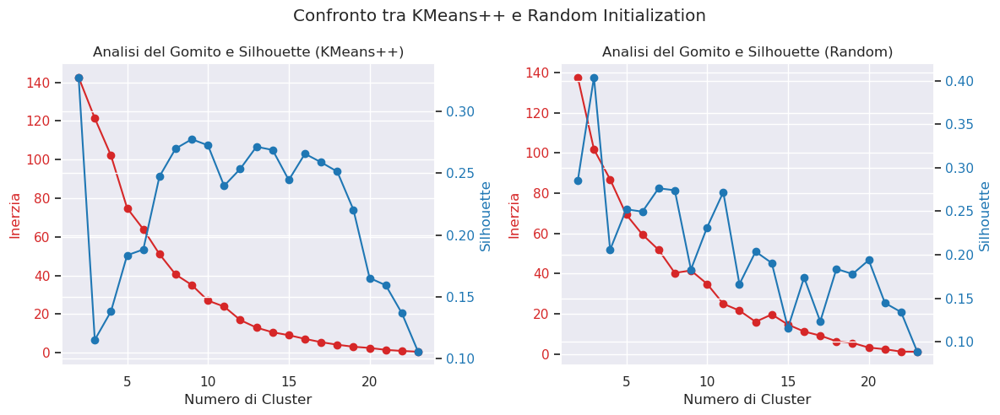

In [ ]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

color = 'tab:red'
ax1.set_xlabel('Numero di Cluster')
ax1.set_ylabel('Inerzia', color=color)
ax1.plot(range(2, 24), inertia_values_kmeanspp, marker='o', color=color)
ax1.tick_params(axis='y', labelcolor=color)
ax1_twin = ax1.twinx()
color = 'tab:blue'
ax1_twin.set_ylabel('Silhouette', color=color)
ax1_twin.plot(range(2, 24), silhouette_scores_kmeanspp, marker='o', color=color)
ax1_twin.tick_params(axis='y', labelcolor=color)
ax1.set_title('Analisi del Gomito e Silhouette (KMeans++)')

color = 'tab:red'
ax2.set_xlabel('Numero di Cluster')
ax2.set_ylabel('Inerzia', color=color)
ax2.plot(range(2, 24), inertia_values_random, marker='o', color=color)
ax2.tick_params(axis='y', labelcolor=color)
ax2_twin = ax2.twinx()
color = 'tab:blue'
ax2_twin.set_ylabel('Silhouette', color=color)
ax2_twin.plot(range(2, 24), silhouette_scores_random, marker='o', color=color)
ax2_twin.tick_params(axis='y', labelcolor=color)
ax2.set_title('Analisi del Gomito e Silhouette (Random)')

plt.suptitle('Confronto tra KMeans++ e Random Initialization')
# Regolazione del layout per evitare sovrapposizioni
plt.tight_layout()
plt.show()

In [ ]:
# Values of parameters
n_cluster_values = [3, 4, 5, 6, 7, 8, 9, 10]  # Aggiunto per n_cluster
init_values = ['k-means++', 'random']
n_init_values = [10, 30, 50]
max_iter_values = [300, 500, 1000]
tol_values = [1e-3, 1e-4, 1e-5, 1e-6]
algorithm_values = ['lloyd', 'elkan']


parameter_combinations = product(n_cluster_values, init_values, n_init_values, max_iter_values, tol_values, algorithm_values)

best_silhouette = float('-inf')
best_params = {}

for params in parameter_combinations:
    n_cluster_value, init_method, n_init_value, max_iter_value, tol_value, algorithm_method = params

    kmeans = KMeans(
        n_clusters=n_cluster_value,
        init=init_method,
        n_init=n_init_value,
        max_iter=max_iter_value,
        tol=tol_value,
        algorithm=algorithm_method,
        random_state=42
    )
    kmeans.fit(X)
    silhouette = silhouette_score(X, kmeans.labels_)

    # Update best parameter
    if silhouette > best_silhouette:
        best_silhouette = silhouette
        best_params = {
            'n_clusters': n_cluster_value,
            'init': init_method,
            'n_init': n_init_value,
            'max_iter': max_iter_value,
            'tol': tol_value,
            'algorithm': algorithm_method
        }

print("Migliori parametri:", best_params)
print("Miglior punteggio silhouette:", best_silhouette)

# Best parameters: {'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.001, 'algorithm': 'lloyd'}
# Best silhouette score: 0.40396646567546524

Migliori parametri: {'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.001, 'algorithm': 'lloyd'}
Miglior punteggio silhouette: 0.40396646567546524


In [ ]:
## TEST PER NON RIEFFETTUARE CROSS VALIDATION

best_params = {'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.001, 'algorithm': 'lloyd'}

best_kmeans = KMeans(
        n_clusters=best_params['n_clusters'],
        init=best_params['init'],
        n_init=best_params['n_init'],
        max_iter=best_params['max_iter'],
        tol=best_params['tol'],
        algorithm=best_params['algorithm'],
        random_state=42
)

In [ ]:
labels = best_kmeans.fit_predict(X)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


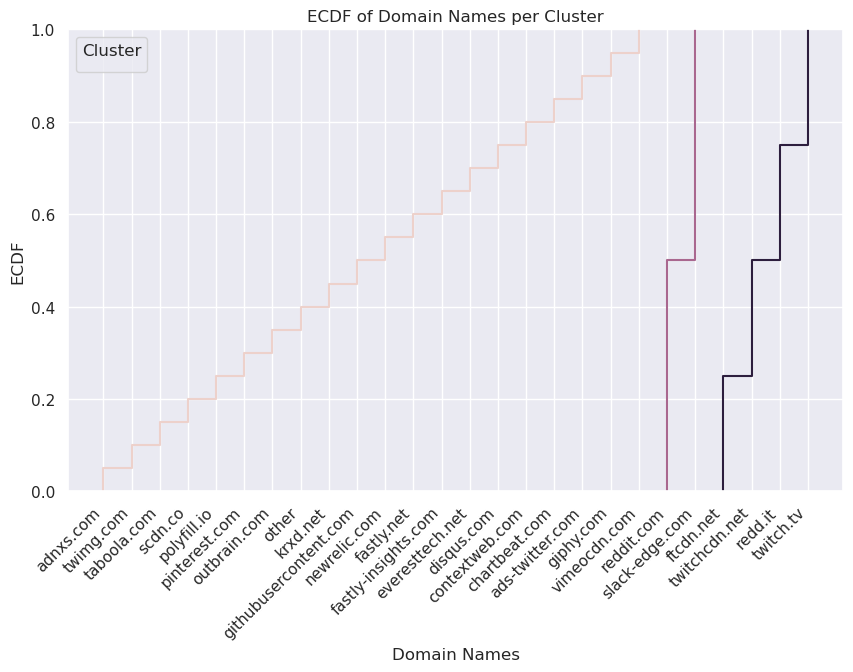

In [ ]:
domain_kmeans = X.copy()
domain_kmeans['Cluster'] = labels
domain_kmeans = domain_kmeans.sort_values(by=['Cluster'])

plt.figure(figsize=(10, 6))

sns.ecdfplot(data=domain_kmeans, x=domain_kmeans.index, hue='Cluster')

plt.xlabel('Domain Names')
plt.ylabel('ECDF')
plt.title('ECDF of Domain Names per Cluster')
plt.xticks(rotation=45, ha="right")
plt.legend(title='Cluster')
plt.show()

In [ ]:
pca_clustering = PCA(n_components=2, random_state=42)
pca_clustering.fit(X)
pca_result_clustering = pca_clustering.transform(X)

In [ ]:
# describe how much of the dataset variability is indicated by a given amount of features
explained_variance_clustering = pca_clustering.explained_variance_ratio_

# evaluate the total dataset variability while increasing the variables
cumul_exp_var_clustering = np.cumsum(explained_variance_clustering)

# percentage value to better understand the best number of components
perc_cumul_exp_var_clustering = cumul_exp_var_clustering * 100

print(f'2 PCs explain {round(perc_cumul_exp_var_clustering[1], 2)}% of variance')

2 PCs explain 54.09% of variance


In [ ]:
pca_df_result_clustering = pd.DataFrame(pca_result_clustering, columns=['component_' + str(i) for i in range(1, 3)])
pca_df_result_clustering.index = y
pca_df_result_clustering['cluster'] = labels
pca_df_result_clustering

,component_1,component_2,cluster
label,,,
adnxs.com,0.223227,-1.177387,0
ads-twitter.com,-0.747108,-0.205735,0
chartbeat.com,-1.544019,0.276410,0
contextweb.com,-0.727528,-0.431550,0
disqus.com,-0.402100,0.462462,0
everesttech.net,-1.840461,0.468406,0
fastly-insights.com,-0.868509,-0.856337,0
fastly.net,-0.815146,-0.531481,0
ftcdn.net,2.734366,-2.424966,2


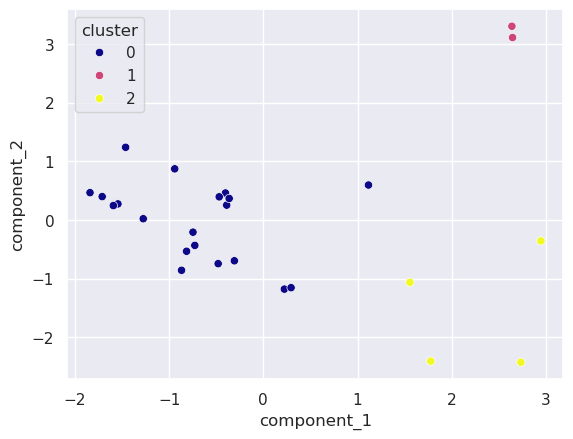

In [ ]:
sns.scatterplot(data=pca_df_result_clustering, x='component_1', y='component_2', hue='cluster', palette="plasma")
plt.show()

In [ ]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

print(f'Davies Bouldin score: {davies_bouldin_score(X, labels)}')
print(f'Silhouette score: {silhouette_score(X, labels)}')
print(f'Calinski Harabasz score: {calinski_harabasz_score(X, labels)}')
print(f'Adjusted random score: {adjusted_rand_score(y, labels)}')
print(f"Jaccard score: {jaccard_score(y_encoded, labels, average='micro')}")
print(f'Fowlkes Mallows score: {fowlkes_mallows_score(y, labels)}')

Davies Bouldin score: 1.0581546277061933
Silhouette score: 0.40396646567546524
Calinski Harabasz score: 9.123843297228461
Adjusted random score: 0.0
Jaccard score: 0.0196078431372549
Fowlkes Mallows score: 0.0


/opt/conda/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/tmp/ipykernel_2906/3693349438.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


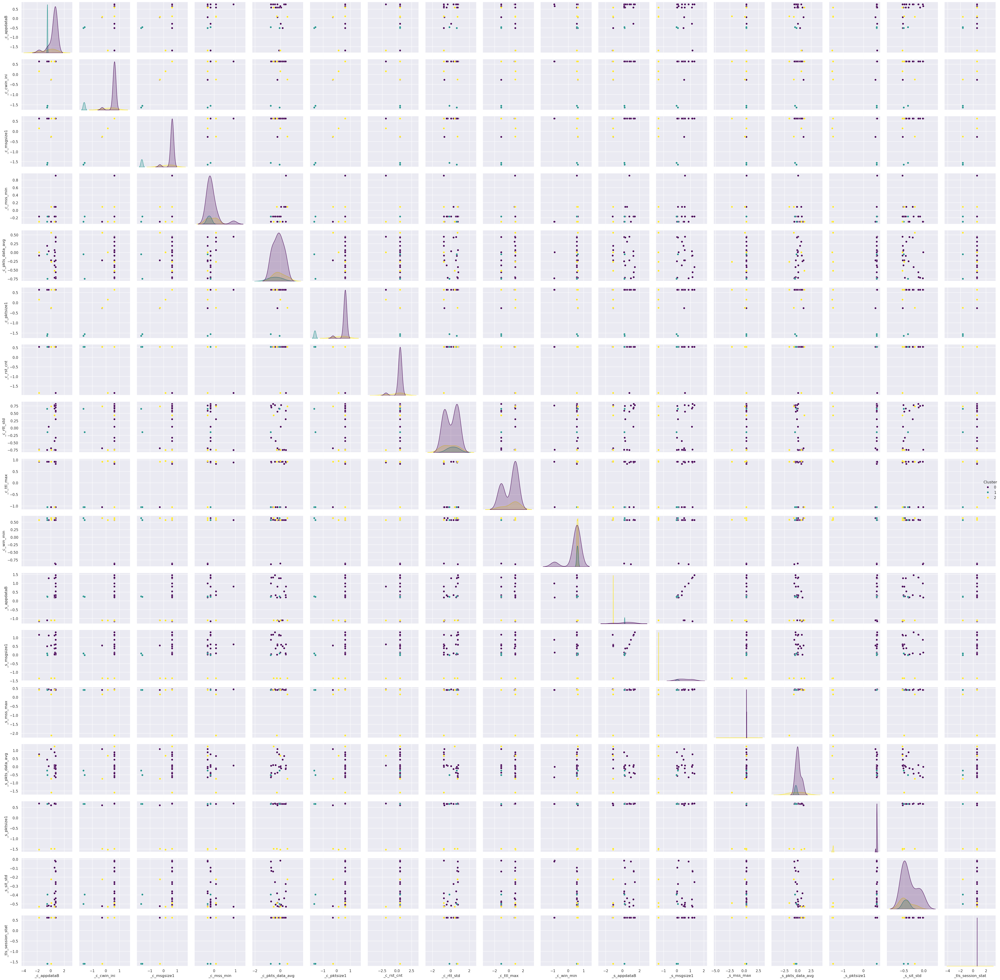

In [ ]:
sns.pairplot(domain_kmeans, hue='Cluster', palette='viridis', diag_kind='kde')
plt.tight_layout()
plt.show()

## Spectral Clustering

In [ ]:
silhouette_scores = []
k_values = range(2, 26)

# Computes silhouette for each value of k
for k in k_values:
    model = SpectralClustering(n_clusters=k, random_state=42)
    labels = model.fit_predict(X)
    silhouette_scores.append(silhouette_score(X, labels))  # Per il punteggio di silhouette

# Create an instance of OptimalK for Gap statistic
optimal_k = OptimalK(parallel_backend='joblib')
n_clusters_gap = optimal_k(X, cluster_array=k_values)

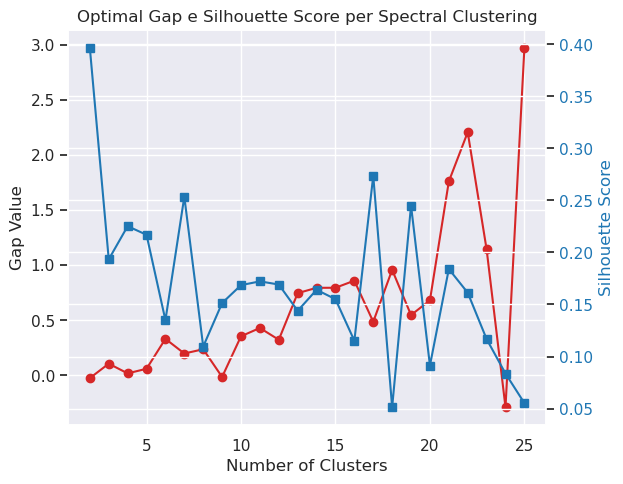

In [ ]:
# Plot Elbow Method e Silhouette Score
fig, ax1 = plt.subplots()

color = 'tab:red'
# Plot Gap statistic results
ax1.plot(optimal_k.gap_df.n_clusters, optimal_k.gap_df.gap_value, marker='o', color=color)
ax1.set_xlabel('Number of Clusters')
ax1.set_ylabel('Gap Value')

ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Silhouette Score', color=color)
ax2.plot(k_values, silhouette_scores, 's-', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()
plt.title('Optimal Gap e Silhouette Score per Spectral Clustering')
plt.show()

In [ ]:
from itertools import product
from sklearn.cluster import SpectralClustering
from sklearn.metrics import silhouette_score

#Best parameters
n_clusters_values = np.arange(2, 25)
n_init_values = [10, 30, 50]
gamma_values = [0.1, 1.0, 10.0]
affinity_values = ['nearest_neighbors', 'rbf', 'nearest_neighbors']
assign_labels_values = ['discretize']

parameter_combinations = product(n_clusters_values, n_init_values, gamma_values, affinity_values, assign_labels_values)

best_silhouette = float('-inf')
best_params = {}

for params in parameter_combinations:
    n_clusters_value, n_init_value, gamma_value, affinity_method, assign_labels_method = params

    spectral = SpectralClustering(
        n_clusters=n_clusters_value,
        n_init=n_init_value,
        gamma=gamma_value,
        affinity=affinity_method,
        assign_labels=assign_labels_method,
        random_state=42
    )
    labels = spectral.fit_predict(X)
    silhouette = silhouette_score(X, labels)

    # Update best parameters
    if silhouette > best_silhouette:
        best_silhouette = silhouette
        best_params = {
            'n_clusters': n_clusters_value,
            'n_init': n_init_value,
            'gamma': gamma_value,
            'affinity': affinity_method,
            'assign_labels': assign_labels_method
        }

print("Migliori parametri:", best_params)
print("Miglior punteggio silhouette:", best_silhouette)

# Best parameters: {'n_clusters': 2, 'n_init': 10, 'gamma': 1.0, 'affinity': 'rbf', 'assign_labels': 'discretize'}
# Best silhouette score: 0.39640900552644964

Migliori parametri: {'n_clusters': 2, 'n_init': 10, 'gamma': 1.0, 'affinity': 'rbf', 'assign_labels': 'discretize'}
Miglior punteggio silhouette: 0.39640900552644964


In [ ]:
## TEST FROM CROSS VALIDATION

best_params = {'n_clusters': 2, 'n_init': 10, 'gamma': 1.0, 'affinity': 'rbf', 'assign_labels': 'discretize'}

best_spectral = SpectralClustering(
        n_clusters=best_params['n_clusters'],
        gamma=best_params['gamma'],
        affinity=best_params['affinity'],
        assign_labels=best_params['assign_labels'],
        random_state=42
)

In [ ]:
labels_spectral = best_spectral.fit_predict(X)

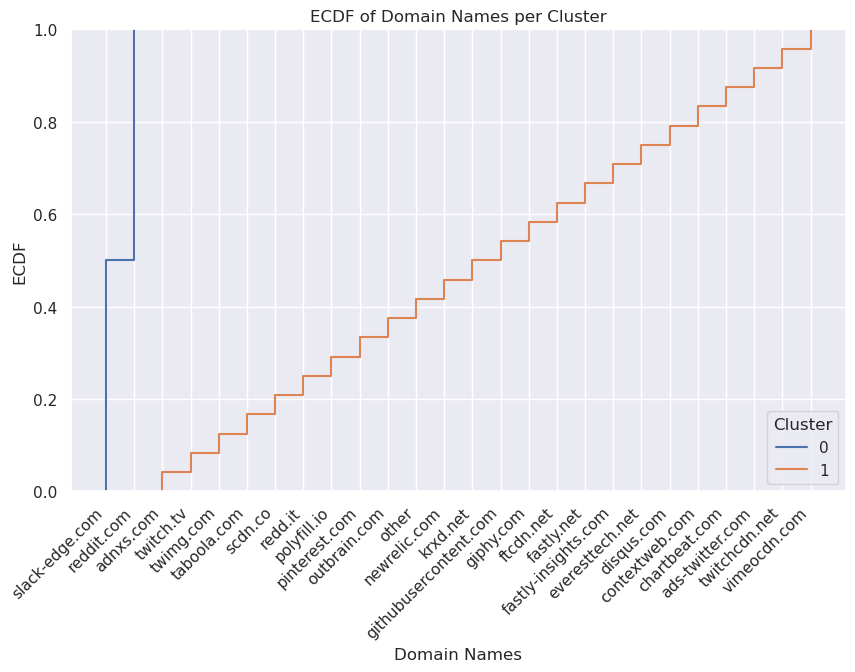

In [ ]:
domain_spectral = X.copy()
domain_spectral['Cluster'] = labels_spectral
domain_spectral = domain_spectral.sort_values(by=['Cluster'])

plt.figure(figsize=(10, 6))

sns.ecdfplot(data=domain_spectral, x=domain_spectral.index, hue='Cluster')

plt.xlabel('Domain Names')
plt.ylabel('ECDF')
plt.title('ECDF of Domain Names per Cluster')
plt.xticks(rotation=45, ha="right")
plt.show()

In [ ]:
pca_df_result_clustering_spectral = pd.DataFrame(pca_result_clustering, columns=['component_' + str(i) for i in range(1, 3)])
pca_df_result_clustering_spectral.index = y
pca_df_result_clustering_spectral['cluster'] = labels_spectral
pca_df_result_clustering_spectral

,component_1,component_2,cluster
label,,,
adnxs.com,0.223227,-1.177387,1
ads-twitter.com,-0.747108,-0.205735,1
chartbeat.com,-1.544019,0.276410,1
contextweb.com,-0.727528,-0.431550,1
disqus.com,-0.402100,0.462462,1
everesttech.net,-1.840461,0.468406,1
fastly-insights.com,-0.868509,-0.856337,1
fastly.net,-0.815146,-0.531481,1
ftcdn.net,2.734366,-2.424966,1


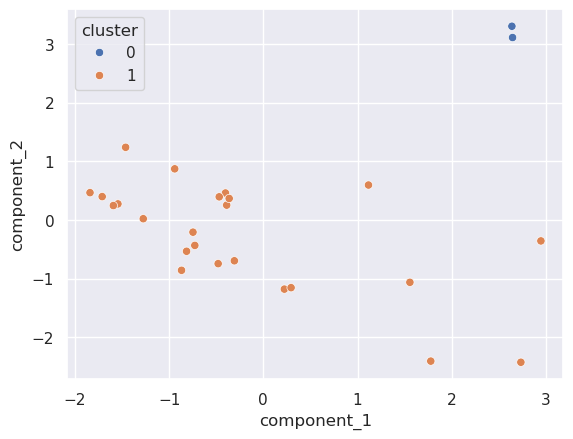

In [ ]:
sns.scatterplot(data=pca_df_result_clustering_spectral, x='component_1', y='component_2', hue='cluster')
plt.show()

In [ ]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

print(f'Davies Bouldin score: {davies_bouldin_score(X, labels_spectral)}')
print(f'Silhouette score: {silhouette_score(X, labels_spectral)}')
print(f'Calinski Harabasz score: {calinski_harabasz_score(X, labels_spectral)}')
print(f'Adjusted random score: {adjusted_rand_score(y, labels_spectral)}')
print(f"Jaccard score: {jaccard_score(y_encoded, labels_spectral, average='micro')}")
print(f'Fowlkes Mallows score: {fowlkes_mallows_score(y, labels_spectral)}')

Davies Bouldin score: 0.6180228930778464
Silhouette score: 0.39640900552644964
Calinski Harabasz score: 6.531913561493328
Adjusted random score: 0.0
Jaccard score: 0.0196078431372549
Fowlkes Mallows score: 0.0


/opt/conda/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/tmp/ipykernel_2906/1496109469.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


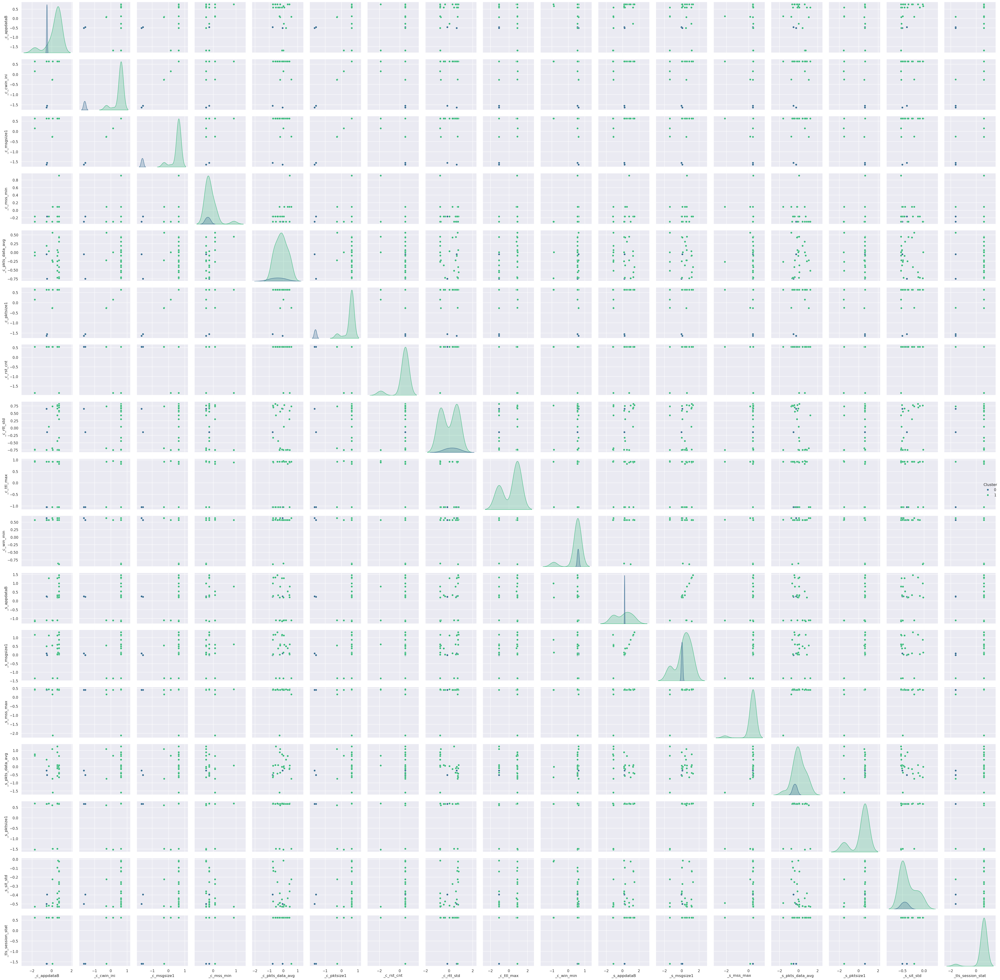

In [ ]:
sns.pairplot(domain_spectral, hue='Cluster', palette='viridis', diag_kind='kde')
plt.tight_layout()
plt.show()

### Removing distant points

The best silhoutte method gived us only 2 clusters, we can observe from the PCA graph that those points are correctly distant from the other points. But we also notice that the other points are quite sparse.
It might be interesing to re-run the cluster algorithm on the first cluster to see if we obeserve some separation

In [ ]:
index_to_drop = ['reddit.com', 'slack-edge.com']
X_removed = X.drop(index_to_drop)
y_removed = y.drop(index_to_drop)

In [ ]:
silhouette_scores_removed = []
k_values = range(2, 24)

for k in k_values:
    model = SpectralClustering(n_clusters=k, random_state=42)
    labels = model.fit_predict(X_removed)
    silhouette_scores_removed.append(silhouette_score(X_removed, labels))  # Per il punteggio di silhouette

# Create an instance of OptimalK for Gap statistic
optimal_k_removed = OptimalK(parallel_backend='joblib')
n_clusters_gap_removed = optimal_k_removed(X_removed, cluster_array=k_values)

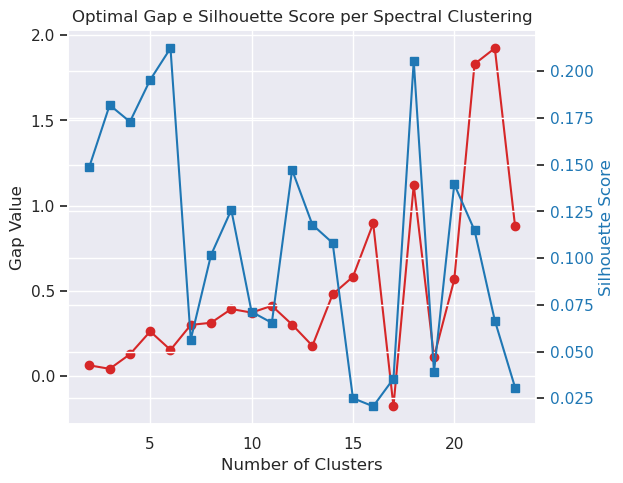

In [ ]:
fig, ax1 = plt.subplots()

color = 'tab:red'
ax1.plot(optimal_k_removed.gap_df.n_clusters, optimal_k_removed.gap_df.gap_value, marker='o', color=color)
ax1.set_xlabel('Number of Clusters')
ax1.set_ylabel('Gap Value')

ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Silhouette Score', color=color)
ax2.plot(k_values, silhouette_scores_removed, 's-', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()
plt.title('Optimal Gap e Silhouette Score per Spectral Clustering')
plt.show()

In [ ]:
from itertools import product
from sklearn.cluster import SpectralClustering
from sklearn.metrics import silhouette_score

n_clusters_values_removed = np.arange(2,23)
n_init_values_removed = [10, 30, 50]
gamma_values_removed = [0.1, 1.0, 10.0]
affinity_values_removed = ['nearest_neighbors', 'rbf', 'nearest_neighbors']
assign_labels_values_removed = ['discretize']

parameter_combinations_removed = product(n_clusters_values_removed, n_init_values_removed, gamma_values_removed, affinity_values_removed, assign_labels_values_removed)

best_silhouette_removed = float('-inf')
best_params_removed = {}

for params in parameter_combinations_removed:
    n_clusters_value_removed, n_init_value_removed, gamma_value_removed, affinity_method_removed, assign_labels_method_removed = params

    spectral_removed = SpectralClustering(
        n_clusters=n_clusters_value_removed,
        n_init=n_init_value_removed,
        gamma=gamma_value_removed,
        affinity=affinity_method_removed,
        assign_labels=assign_labels_method_removed,
        random_state=42
    )
    labels_removed = spectral_removed.fit_predict(X_removed)
    silhouette_removed = silhouette_score(X_removed, labels_removed)

    if silhouette_removed > best_silhouette_removed:
        best_silhouette_removed = silhouette_removed
        best_params_removed = {
            'n_clusters': n_clusters_value_removed,
            'n_init': n_init_value_removed,
            'gamma': gamma_value_removed,
            'affinity': affinity_method_removed,
            'assign_labels': assign_labels_method_removed
        }

print("Migliori parametri:", best_params_removed)
print("Miglior punteggio silhouette:", best_silhouette_removed)

# Migliori parametri: {'n_clusters': 2, 'n_init': 10, 'gamma': 0.1, 'affinity': 'rbf', 'assign_labels': 'discretize'}
# Miglior punteggio silhouette: 0.3008403329947371

Migliori parametri: {'n_clusters': 2, 'n_init': 10, 'gamma': 0.1, 'affinity': 'rbf', 'assign_labels': 'discretize'}
Miglior punteggio silhouette: 0.3008403329947371


In [ ]:
## TEST FROM CROSS VALIDATION

best_params_removed = {'n_clusters': 2, 'n_init': 10, 'gamma': 0.1, 'affinity': 'rbf', 'assign_labels': 'discretize'}

best_spectral_removed = SpectralClustering(
        n_clusters=best_params_removed['n_clusters'],
        gamma=best_params_removed['gamma'],
        affinity=best_params_removed['affinity'],
        assign_labels=best_params_removed['assign_labels'],
        random_state=42
)

In [ ]:
labels_spectral_removed = best_spectral_removed.fit_predict(X_removed)

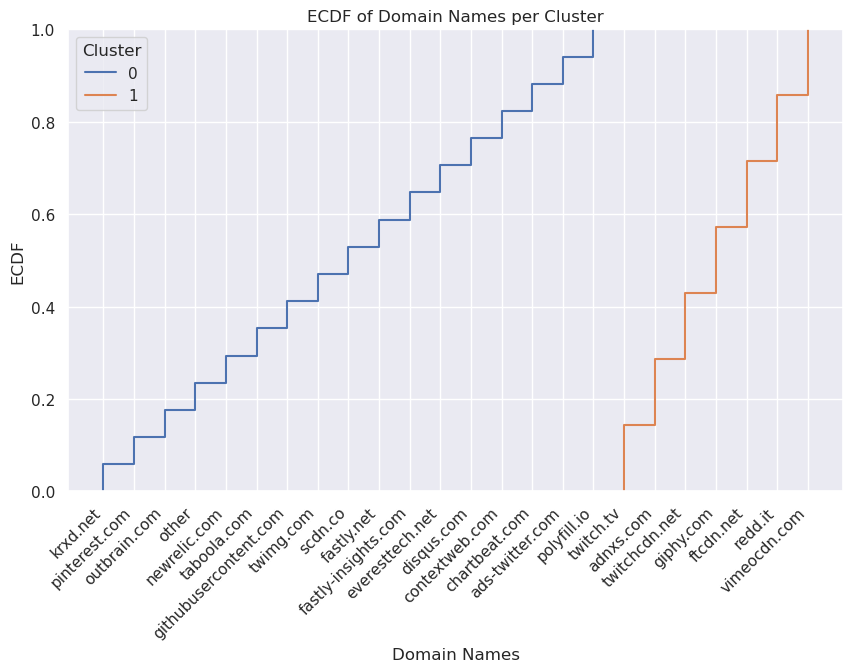

In [ ]:
domain_spectral_removed = X_removed.copy()
domain_spectral_removed['Cluster'] = labels_spectral_removed
domain_spectral_removed = domain_spectral_removed.sort_values(by=['Cluster'])

plt.figure(figsize=(10, 6))

sns.ecdfplot(data=domain_spectral_removed, x=domain_spectral_removed.index, hue='Cluster')

plt.xlabel('Domain Names')
plt.ylabel('ECDF')
plt.title('ECDF of Domain Names per Cluster')
plt.xticks(rotation=45, ha="right")
plt.show()

In [ ]:
pca_clustering_removed = PCA(n_components=2, random_state=42)
pca_clustering_removed.fit(X_removed)
pca_result_clustering_removed = pca_clustering_removed.transform(X_removed)

In [ ]:
# describe how much of the dataset variability is indicated by a given amount of features
explained_variance_clustering_removed = pca_clustering_removed.explained_variance_ratio_

# evaluate the total dataset variability while increasing the variables
cumul_exp_var_clustering_removed = np.cumsum(explained_variance_clustering_removed)

# percentage value to better understand the best number of components
perc_cumul_exp_var_clustering_removed = cumul_exp_var_clustering_removed * 100

print(f'2 PCs explain {round(perc_cumul_exp_var_clustering_removed[1], 2)}% of variance')

2 PCs explain 53.2% of variance


In [ ]:
pca_df_result_clustering_spectral_removed = pd.DataFrame(pca_result_clustering_removed, columns=['component_' + str(i) for i in range(1, 3)])
pca_df_result_clustering_spectral_removed.index = y_removed
pca_df_result_clustering_spectral_removed['cluster'] = labels_spectral_removed
pca_df_result_clustering_spectral_removed

,component_1,component_2,cluster
label,,,
adnxs.com,0.811427,-0.508382,1
ads-twitter.com,-0.500506,-0.565415,0
chartbeat.com,-1.440132,-0.733599,0
contextweb.com,-0.371944,-0.583307,0
disqus.com,-0.467645,1.253830,0
everesttech.net,-1.800947,-0.891776,0
fastly-insights.com,-0.325971,-1.232792,0
fastly.net,-0.402982,-0.383187,0
ftcdn.net,3.596001,-0.858036,1


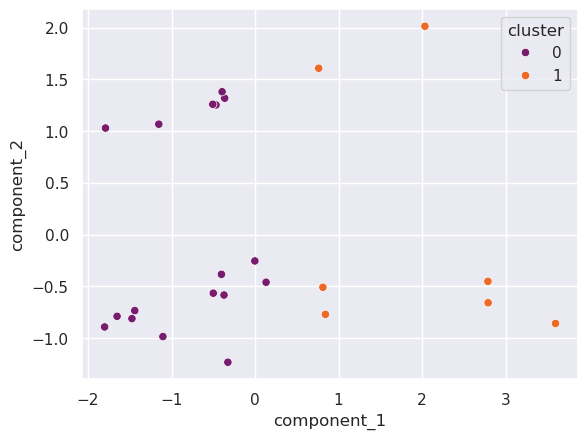

In [ ]:
sns.scatterplot(data=pca_df_result_clustering_spectral_removed, x='component_1', y='component_2', hue='cluster', palette='inferno')
plt.show()

In [ ]:
label_encoder_removed = LabelEncoder()
y_encoded_removed = label_encoder.fit_transform(y_removed)

print(f'Davies Bouldin score: {davies_bouldin_score(X_removed, labels_spectral_removed)}')
print(f'Silhouette score: {silhouette_score(X_removed, labels_spectral_removed)}')
print(f'Calinski Harabasz score: {calinski_harabasz_score(X_removed, labels_spectral_removed)}')
print(f'Adjusted random score: {adjusted_rand_score(y_removed, labels_spectral_removed)}')
print(f"Jaccard score: {jaccard_score(y_encoded_removed, labels_spectral_removed, average='micro')}")
print(f'Fowlkes Mallows score: {fowlkes_mallows_score(y_removed, labels_spectral_removed)}')

Davies Bouldin score: 1.5755885690001772
Silhouette score: 0.3008403329947371
Calinski Harabasz score: 8.260467782751327
Adjusted random score: 0.0
Jaccard score: 0.0
Fowlkes Mallows score: 0.0


/opt/conda/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/tmp/ipykernel_2906/611580154.py:3: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


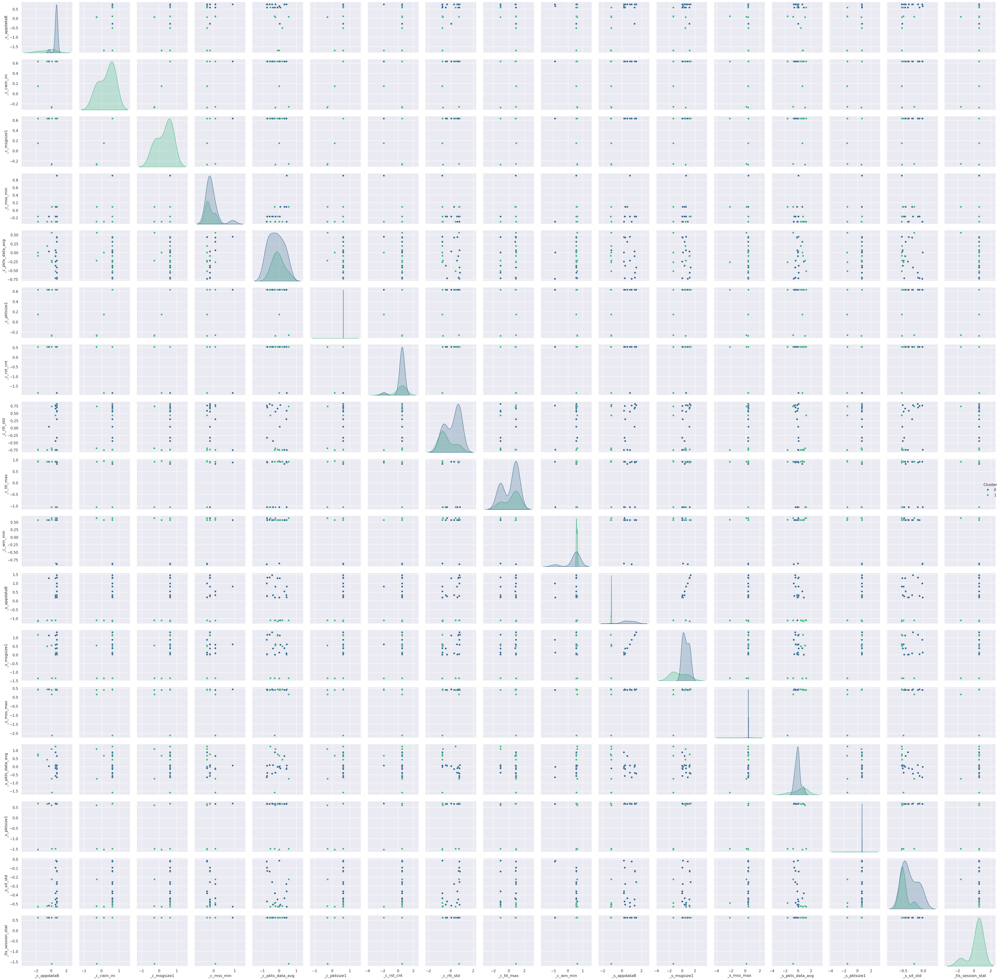

In [ ]:
sns.pairplot(domain_spectral_removed, hue='Cluster', palette='viridis', diag_kind='kde')
plt.tight_layout()
plt.show()

## OPTICS-DBSCAN

OPTICS-DBSCAN doesn't take number of cluster as a input, we use this to compare the difference from our choice

In [ ]:
from sklearn.cluster import cluster_optics_dbscan, compute_optics_graph

ordering, core_distances, reachability, predecessor = compute_optics_graph(
     domain_lasso.values,
     min_samples=2,
     max_eps= 3.0,
     metric="minkowski",
     p=2,
     metric_params=None,
     algorithm="auto",
     leaf_size=30,
     n_jobs=-1,
 )


eps = 3.0


labels = cluster_optics_dbscan(
     reachability=reachability,
     core_distances=core_distances,
     ordering=ordering,
     eps=eps,
 )

In [ ]:
domain_odb = domain_lasso.copy()
domain_odb['Cluster'] = labels
domain_odb = domain_odb.sort_values(by=['Cluster'])
domain_odb

,_c_appdataB,_c_cwin_ini,_c_msgsize1,_c_mss_min,_c_pkts_data_avg,_c_pktsize1,_c_rst_cnt,_c_rtt_std,_c_ttl_max,_c_win_min,_s_appdataB,_s_msgsize1,_s_mss_max,_s_pkts_data_avg,_s_pktsize1,_s_sit_std,_tls_session_stat,Cluster
label,,,,,,,,,,,,,,,,,,
twitch.tv,0.080473,-0.261414,-0.260985,0.086029,0.560505,-0.260885,0.536672,0.732812,0.912331,0.627216,-1.111907,-1.364474,0.154310,-0.753000,-1.488793,-0.225867,-1.606309,-1
redd.it,0.574035,0.629761,0.630474,-0.306851,-0.522993,0.630490,0.536672,0.428067,-1.059833,0.627216,-1.106620,-1.364474,0.401868,1.240558,-1.488793,-0.533622,0.608787,-1
ftcdn.net,-1.709188,0.144324,0.144882,-0.306851,0.002087,0.144945,-1.863337,-0.754933,0.943635,0.562684,-1.114727,-1.373261,0.401868,0.668155,-1.529087,-0.533615,0.608787,-1
twitchcdn.net,0.108562,0.629761,0.630474,0.086029,-0.269108,0.630490,0.536672,-0.752582,0.912331,0.572774,-1.117900,-1.364474,-2.126382,-1.601875,-1.488793,-0.492346,0.608787,-1
adnxs.com,-0.517418,0.629761,0.630474,-0.306851,0.186730,0.630490,0.536672,-0.751711,0.912331,0.562684,-1.106620,0.497891,0.433471,0.426124,0.655572,-0.526632,0.608787,0
twimg.com,0.742568,0.629761,0.630474,-0.169343,-0.722473,0.630490,0.536672,-0.335248,-1.059833,0.627216,0.252638,0.013485,0.401868,0.049937,0.655572,-0.474515,0.608787,0
taboola.com,-0.288694,0.629761,0.630474,-0.169343,0.032861,0.630490,0.536672,0.039741,0.912331,0.562684,1.282304,1.125938,0.433471,0.025482,0.676595,-0.521444,0.608787,0
scdn.co,0.574035,0.629761,0.630474,-0.306851,-0.252759,0.630490,0.536672,-0.751693,0.912331,0.568065,0.187072,0.007373,0.401868,0.880790,0.655572,-0.382796,0.608787,0
polyfill.io,0.742568,0.629761,0.630474,-0.169343,-0.704339,0.630490,0.536672,0.697384,0.881026,0.562684,1.318964,1.165669,0.401868,-0.394064,0.655572,-0.131109,0.608787,0


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


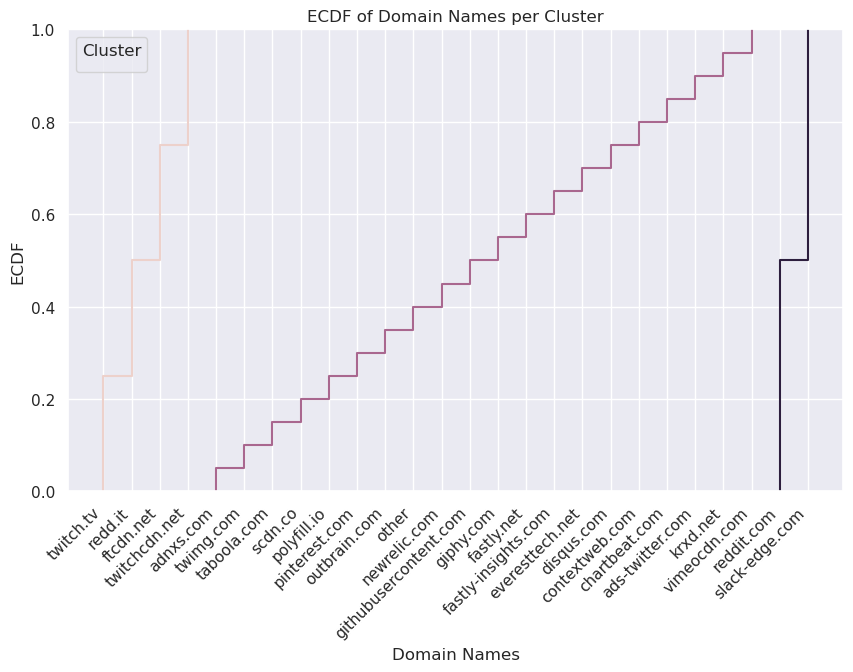

In [ ]:
plt.figure(figsize=(10, 6))

sns.ecdfplot(data=domain_odb, x=domain_odb.index, hue='Cluster')

plt.xlabel('Domain Names')
plt.ylabel('ECDF')
plt.title('ECDF of Domain Names per Cluster')
plt.xticks(rotation=45, ha="right")
plt.legend(title='Cluster')
plt.show()

In [ ]:
pca_df_result_clustering_odb = pd.DataFrame(pca_result_clustering, columns=['component_' + str(i) for i in range(1, 3)])
pca_df_result_clustering_odb.index = y
pca_df_result_clustering_odb['cluster'] = labels
pca_df_result_clustering_odb

,component_1,component_2,cluster
label,,,
adnxs.com,0.223227,-1.177387,0
ads-twitter.com,-0.747108,-0.205735,0
chartbeat.com,-1.544019,0.276410,0
contextweb.com,-0.727528,-0.431550,0
disqus.com,-0.402100,0.462462,0
everesttech.net,-1.840461,0.468406,0
fastly-insights.com,-0.868509,-0.856337,0
fastly.net,-0.815146,-0.531481,0
ftcdn.net,2.734366,-2.424966,-1


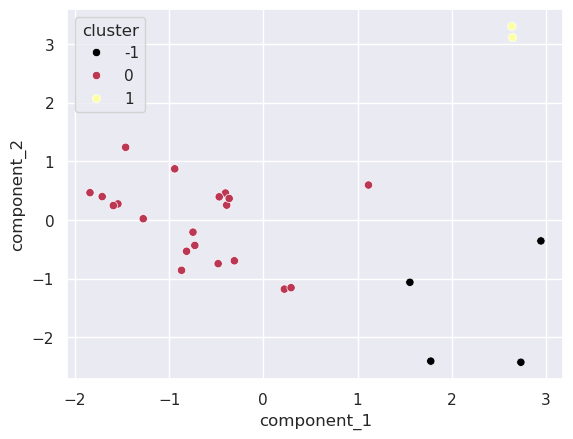

In [ ]:
sns.scatterplot(data=pca_df_result_clustering_odb, x='component_1', y='component_2', hue='cluster', palette='inferno')
plt.show()

In [ ]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

print(f'Davies Bouldin score: {davies_bouldin_score(X, labels)}')
print(f'Silhouette score: {silhouette_score(X, labels)}')
print(f'Calinski Harabasz score: {calinski_harabasz_score(X, labels)}')
print(f'Adjusted random score: {adjusted_rand_score(y, labels)}')
print(f"Jaccard score: {jaccard_score(y_encoded, labels, average='micro')}")
print(f'Fowlkes Mallows score: {fowlkes_mallows_score(y, labels)}')

Davies Bouldin score: 1.0581546277061933
Silhouette score: 0.40396646567546524
Calinski Harabasz score: 9.123843297228461
Adjusted random score: 0.0
Jaccard score: 0.0196078431372549
Fowlkes Mallows score: 0.0


# Regression

## _s_bytes_all

### Preparation

In [ ]:
regression_df = df_norm_scaled.drop(columns=['c_ip', '_s_bytes_uniq'])
start_test_index = df_training.index[-1] + 1
regression_df

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,label
0,-0.107564,-0.102390,0.574035,0.167195,-0.024507,-0.053287,-0.024250,0.629761,-0.120316,-0.091699,...,-0.457002,-0.069715,1.106862,0.081361,0.108048,-0.088372,-1.106843,0.193998,0.608787,krxd.net
1,-0.105436,-0.099003,-0.605697,-0.084394,-0.031887,-0.053287,-0.031646,-1.804669,-0.195093,-1.116417,...,-0.533046,-0.069715,1.106862,0.081361,0.108048,-0.089836,-1.106843,-5.154702,-1.606309,other
2,-0.108628,-0.103519,0.574035,-0.047634,-0.012732,-0.053287,-0.012449,0.629761,0.156819,-0.091699,...,-0.533901,-0.069715,1.106862,0.081361,0.108048,-0.085807,-1.106843,0.193998,0.608787,contextweb.com
3,-0.107564,-0.103519,0.108562,-0.100397,-0.029593,-0.053287,-0.029347,-0.210697,-0.131139,-1.116417,...,-0.533901,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,-1.606309,twitchcdn.net
4,-0.109692,-0.104649,-1.709188,-0.104993,-0.033197,-0.053287,-0.032959,-0.210697,-0.182303,-1.116417,...,-0.533901,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,-1.606309,twitchcdn.net
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262438,-0.087350,-0.099003,0.742568,-0.096643,-0.015297,-0.037376,-0.015112,0.629761,0.472328,-0.358126,...,2.968682,-0.069715,-0.903455,0.081361,0.108048,-0.085379,0.903467,0.193998,0.608787,other
262439,-0.102244,-0.104649,0.574035,-0.099774,-0.026266,-0.045944,-0.026056,0.629761,-0.017989,-0.091699,...,3.385088,-0.069715,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.193998,0.608787,krxd.net
262440,-0.108628,-0.103519,0.742568,-0.092478,-0.029315,-0.053287,-0.029069,0.629761,-0.144258,0.769064,...,-0.533145,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787,other
262441,-0.108628,-0.103519,-1.709188,-0.104993,-0.032072,-0.053287,-0.031831,0.629761,-0.144258,0.769064,...,-0.533847,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,0.608787,krxd.net


In [ ]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(regression_df['label'])
regression_df['label'] = y_encoded

features = regression_df.drop(columns=['_s_bytes_all'])
target = regression_df['_s_bytes_all']

In [ ]:
corr_matrix = features.corr()
corr_matrix

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,label
_c_ack_cnt,1.000000,0.993449,0.013663,-0.000708,0.160441,0.095049,0.160130,-0.014046,0.102324,-0.000205,...,-0.023120,-0.001840,0.012506,0.000886,-0.008931,0.001941,-0.012505,0.011374,-0.012943,0.024507
_c_ack_cnt_p,0.993449,1.000000,0.011032,-0.000810,0.057200,0.061015,0.056935,-0.015632,0.027541,0.001483,...,-0.024215,-0.001588,0.014478,0.000623,-0.008947,0.000844,-0.014478,0.011114,-0.014243,0.023768
_c_appdataB,0.013663,0.011032,1.000000,0.052234,0.011842,0.016640,0.011764,0.363557,0.051410,-0.190298,...,0.239375,-0.025742,0.044127,-0.010387,-0.012193,-0.025000,-0.044112,-0.007169,0.294299,0.012269
_c_appdataT,-0.000708,-0.000810,0.052234,1.000000,0.000322,0.006594,0.000285,-0.006259,0.003401,0.016494,...,0.018741,0.114458,-0.001968,-0.002534,-0.015552,0.109056,0.001969,0.015409,-0.000957,-0.007560
_c_bytes_all,0.160441,0.057200,0.011842,0.000322,1.000000,0.252737,0.999985,0.005460,0.839603,-0.005872,...,-0.005477,-0.001146,-0.004450,0.001247,-0.001730,0.012502,0.004450,0.001072,0.002688,0.005330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
_s_win_max,0.001941,0.000844,-0.025000,0.109056,0.012502,0.009135,0.012468,-0.003319,0.011334,0.036275,...,-0.021006,0.816028,0.012510,0.002640,-0.037047,1.000000,-0.012617,0.020415,0.000582,0.009406
_s_win_min,-0.012505,-0.014478,-0.044112,0.001969,0.004450,-0.006216,0.004492,0.097558,-0.011720,0.044850,...,0.160716,-0.021953,-0.999990,-0.006991,0.009858,-0.012617,1.000000,0.226137,0.029549,0.029121
_s_win_scl,0.011374,0.011114,-0.007169,0.015409,0.001072,0.008556,0.001025,-0.010211,-0.013358,0.060236,...,0.094080,0.014364,-0.226140,-0.008075,-0.016186,0.020415,0.226137,1.000000,-0.043601,-0.003501
_tls_session_stat,-0.012943,-0.014243,0.294299,-0.000957,0.002688,0.006407,0.002656,0.848864,0.008710,-0.035391,...,0.091889,-0.000260,-0.029555,-0.021579,-0.015188,0.000582,0.029549,-0.043601,1.000000,-0.118489


In [ ]:
# extract features having a correlation > 0.8
c = corr_matrix[corr_matrix>0.8]
s = c.unstack()
so = s.sort_values(ascending=False).reset_index()

# get strongly correlatead features removing pairs having correlation = 1 because of the diagonal, i.e., correlation between one feature and itself
so = so[(so[0].isnull()==False) & (so["level_0"] != so["level_1"])]

to_be_deleted = []
candidates = list(so["level_0"])

# get the unique set of features to be deleted. Notice that we discard one feature per time considering the case where a feature is strongly correlated with multiple features
subset_so = so
for candidate in candidates:
    if (candidate in list(subset_so["level_0"])):
        to_be_deleted.append(candidate)
        subset_so = subset_so[(subset_so["level_0"] != candidate) & (subset_so["level_1"] != candidate)]

# to_be_deleted contains the index of columns that you need to remove from both training and test sets
print(len(to_be_deleted), 'features are removed')

# remove the correlated features from bot sets
to_be_deleted.append('label')
features = regression_df.drop(columns=to_be_deleted)
labels = regression_df['label']

X_train = features.loc[:start_test_index]
y_train = target.loc[:start_test_index]
X_test = features.loc[start_test_index:]
y_test = target.loc[start_test_index:]

45 features are removed


### Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [ ]:
dtBytes = DecisionTreeRegressor(random_state=42)
dtBytes.fit(X_train,y_train)

DecisionTreeRegressor(random_state=42)

In [ ]:
y_train_pred = dtBytes.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 2.3240077267235932e-17
Training Mean Absolute Error: 1.8678682644439792e-10


In [ ]:
y_test_pred = dtBytes.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 3.074834214833346
Test Mean Absolute Error: 0.00784147904383885


In [ ]:
from sklearn.model_selection import cross_validate


MSE_dt_train_means = []
MSE_dt_train_maxs = []
MSE_dt_train_mins = []
MSE_dt_val_means = []
MSE_dt_val_maxs = []
MSE_dt_val_mins = []

combinations = []

for max_depth in [4, 6, 8, None]:
    for min_samples_split in [2, 3, 4]:
        for min_samples_leaf in [1, 2, 3]:
            dt = DecisionTreeRegressor(max_depth=max_depth, min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf)
            scores = cross_validate(dt, X_train, y_train, cv=5, scoring='neg_mean_squared_error', return_train_score=True, n_jobs=n_jobs)

            MSE_dt_train_means.append(-1 * (scores['train_score'].mean()))
            MSE_dt_train_maxs.append(-1 * (scores['train_score'].max()))
            MSE_dt_train_mins.append(-1 * (scores['train_score'].min()))
            MSE_dt_val_means.append(-1 * (scores['test_score'].mean()))
            MSE_dt_val_maxs.append(-1 * (scores['test_score'].max()))
            MSE_dt_val_mins.append(-1 * (scores['test_score'].min()))

            comb = f'max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}'
            combinations.append(comb)
            print(comb)

max_depth: 4, min_samples_split: 2, min_samples_leaf: 1
max_depth: 4, min_samples_split: 2, min_samples_leaf: 2
max_depth: 4, min_samples_split: 2, min_samples_leaf: 3
max_depth: 4, min_samples_split: 3, min_samples_leaf: 1
max_depth: 4, min_samples_split: 3, min_samples_leaf: 2
max_depth: 4, min_samples_split: 3, min_samples_leaf: 3
max_depth: 4, min_samples_split: 4, min_samples_leaf: 1
max_depth: 4, min_samples_split: 4, min_samples_leaf: 2
max_depth: 4, min_samples_split: 4, min_samples_leaf: 3
max_depth: 6, min_samples_split: 2, min_samples_leaf: 1
max_depth: 6, min_samples_split: 2, min_samples_leaf: 2
max_depth: 6, min_samples_split: 2, min_samples_leaf: 3
max_depth: 6, min_samples_split: 3, min_samples_leaf: 1
max_depth: 6, min_samples_split: 3, min_samples_leaf: 2
max_depth: 6, min_samples_split: 3, min_samples_leaf: 3
max_depth: 6, min_samples_split: 4, min_samples_leaf: 1
max_depth: 6, min_samples_split: 4, min_samples_leaf: 2
max_depth: 6, min_samples_split: 4, min_samples_

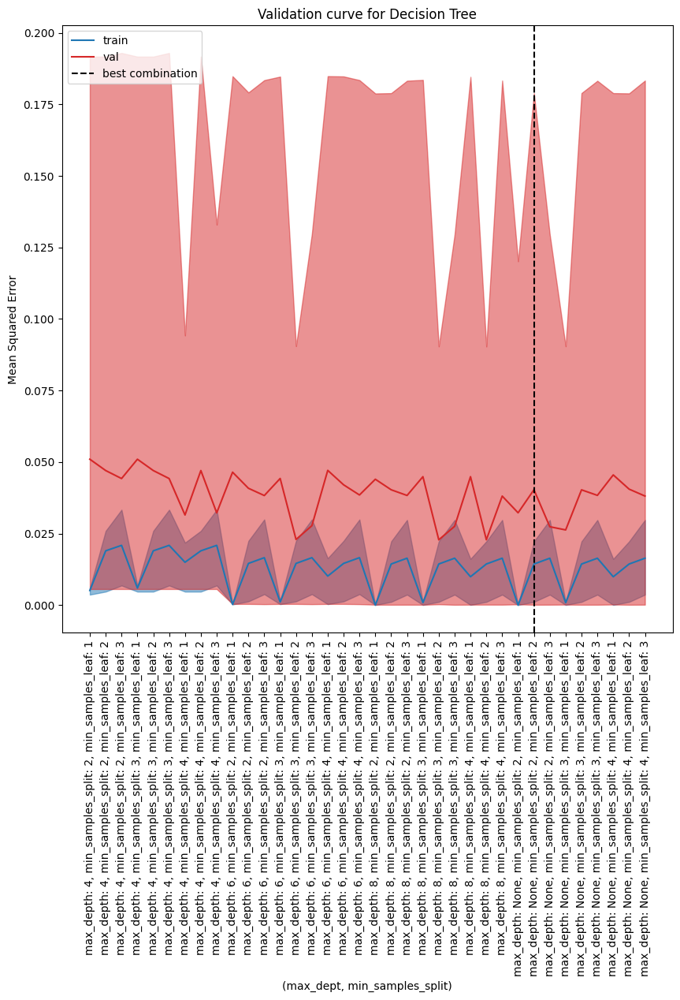

In [ ]:
plt.figure(figsize=(10,10))
x = list(range(len(combinations)))
plt.plot(x, MSE_dt_train_means, color='tab:blue', label='train')
plt.fill_between(x, MSE_dt_train_mins, MSE_dt_train_maxs, alpha=0.5, color='tab:blue')
plt.plot(x, MSE_dt_val_means, color='tab:red', label='val')
plt.fill_between(x, MSE_dt_val_mins, MSE_dt_val_maxs, alpha=0.5, color='tab:red')
plt.xlabel('(max_dept, min_samples_split)')
plt.axvline(x=28, color='black', linestyle='--', label='best combination')

plt.ylabel('Mean Squared Error')
plt.legend()
plt.title("Validation curve for Decision Tree")
plt.xticks([i for i in range(len(combinations))], combinations, rotation=90)
plt.show()

In [ ]:
best_dt = DecisionTreeRegressor(max_depth=None, min_samples_split=2, min_samples_leaf=2)
best_dt.fit(X_train,y_train)

DecisionTreeRegressor(min_samples_leaf=2)

In [ ]:
y_train_pred = best_dt.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 0.00705040631141969
Training Mean Absolute Error: 0.0004826712581164055


In [ ]:
y_test_pred = best_dt.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 2.892579581854625
Test Mean Absolute Error: 0.00759173424402544


### Lasso Regressor

In [ ]:
lassoBytes = Lasso(random_state=42)
lassoBytes.fit(X_train,y_train)

Lasso(random_state=42)

In [ ]:
y_train_pred = lassoBytes.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 0.9999932898063151
Training Mean Absolute Error: 0.1490886009289411


In [ ]:
y_test_pred = lassoBytes.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 5.3547344179291825
Test Mean Absolute Error: 0.15082876616230703


In [ ]:
MAE_train_means = []
MAE_train_maxs = []
MAE_train_mins = []
MAE_val_means = []
MAE_val_maxs = []
MAE_val_mins = []

alphas=[]

for alpha in np.linspace(0,0.3,5):
    lasso = Lasso(alpha=alpha)
    scores = cross_validate(lasso, X_train, y_train, cv=5, scoring='neg_mean_absolute_error', return_train_score=True,n_jobs=n_jobs)
    MAE_train_means.append(-1*(scores['train_score'].mean()))
    MAE_train_maxs.append(-1*(scores['train_score'].max()))
    MAE_train_mins.append(-1*(scores['train_score'].min()))
    MAE_val_means.append(-1*(scores['test_score'].mean()))
    MAE_val_maxs.append(-1*(scores['test_score'].max()))
    MAE_val_mins.append(-1*(scores['test_score'].min()))

    alphas.append(alpha)

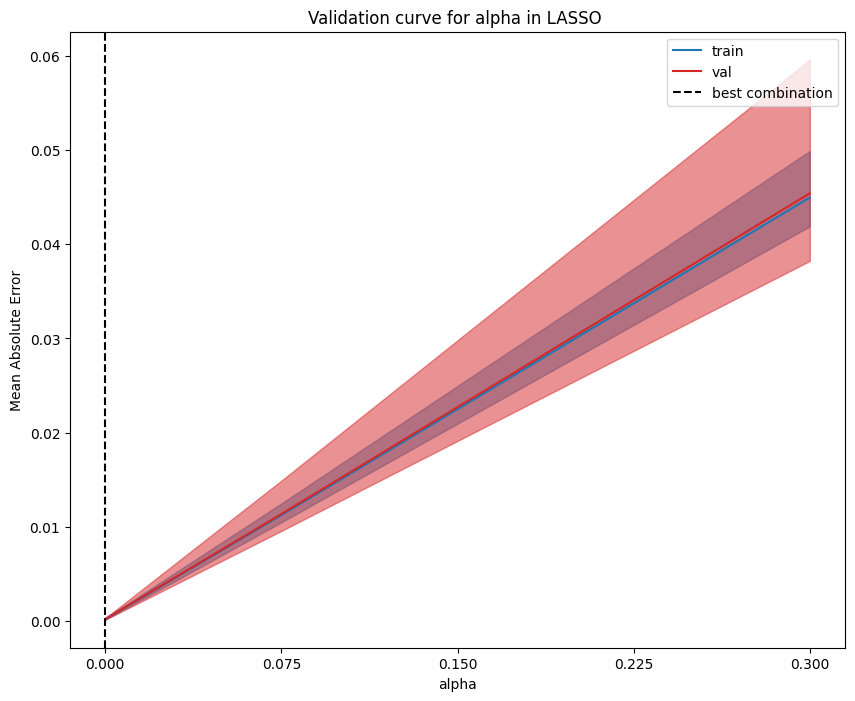

In [ ]:
plt.figure(figsize=(10,8))
x = list(np.linspace(0,0.3,5))
plt.plot(x, MAE_train_means, color='tab:blue', label='train')
plt.fill_between(x, MAE_train_mins, MAE_train_maxs, alpha=0.5, color='tab:blue')
plt.plot(x, MAE_val_means, color='tab:red', label='val')
plt.fill_between(x, MAE_val_mins, MAE_val_maxs, alpha=0.5, color='tab:red')
plt.xlabel('alpha')
plt.axvline(x=0, color='black', linestyle='--', label='best combination')

plt.xticks(alphas)
plt.ylabel('Mean Absolute Error')
plt.legend()
plt.title("Validation curve for alpha in LASSO ")
plt.show()

In [ ]:
best_lasso = Lasso(random_state=42, alpha=0)
best_lasso.fit(X_train,y_train)

C:\Users\franc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:1152: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  return fit_method(estimator, *args, **kwargs)
C:\Users\franc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\linear_model\_coordinate_descent.py:628: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(


Lasso(alpha=0, random_state=42)

In [ ]:
y_train_pred = best_lasso.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 8.98079989634649e-08
Training Mean Absolute Error: 0.00017845756830030404


In [ ]:
y_test_pred = best_lasso.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 9.454402711008185e-08
Test Mean Absolute Error: 0.00017751873907804886


### Neural Network

In [ ]:
model = tf.keras.Sequential([
    tf.keras.layers.Dense(10, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(1)
])

# Compiliamo il modello
model.compile(optimizer='adam', loss='mean_squared_error')

initial_weights = model.get_weights()

model.fit(X_train, y_train, epochs=10, verbose=0)

In [ ]:
y_train_pred = model.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

4621/4621 [==============================] - 4s 823us/step
Training Mean Squared Error: 0.00607268733143582
Training Mean Absolute Error: 0.012592351367913578


In [ ]:
y_test_pred = model.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

3581/3581 [==============================] - 3s 815us/step
Test Mean Squared Error: 0.00322400058691886
Test Mean Absolute Error: 0.01182281137970462


In [ ]:
import numpy as np
import tensorflow as tf
from sklearn.model_selection import cross_validate, KFold

# Define model with regularization L2
model = tf.keras.Sequential([
    tf.keras.layers.Dense(10, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01), input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(1)
])

model.compile(optimizer='adam', loss='mean_squared_error')

# Lists for cross validation
MSE_train_means = []
MSE_train_maxs = []
MSE_train_mins = []
MSE_val_means = []
MSE_val_maxs = []
MSE_val_mins = []

# Definisci gli alpha (parametro di regolarizzazione L2)
alphas = [0.001, 0.01, 0.1, 1.0]

# Esegui la cross validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

for alpha in alphas:
    model.layers[0].kernel_regularizer = tf.keras.regularizers.l2(alpha)

    train_mse = []
    val_mse = []

    for train_index, val_index in kf.split(X_train.values):
        X_train_fold, X_val_fold = X_train.values[train_index], X_train.values[val_index]
        y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]

        model.set_weights(initial_weights)


        model.fit(X_train_fold, y_train_fold, epochs=10, verbose=0)

        train_mse.append(model.evaluate(X_train_fold, y_train_fold, verbose=0))

        val_mse.append(model.evaluate(X_val_fold, y_val_fold, verbose=0))

    MSE_train_means.append(np.mean(train_mse))
    MSE_train_maxs.append(np.max(train_mse))
    MSE_train_mins.append(np.min(train_mse))
    MSE_val_means.append(np.mean(val_mse))
    MSE_val_maxs.append(np.max(val_mse))
    MSE_val_mins.append(np.min(val_mse))

    print(f"Alpha: {alpha}")

Alpha: 0.001
Alpha: 0.01
Alpha: 0.1
Alpha: 1.0


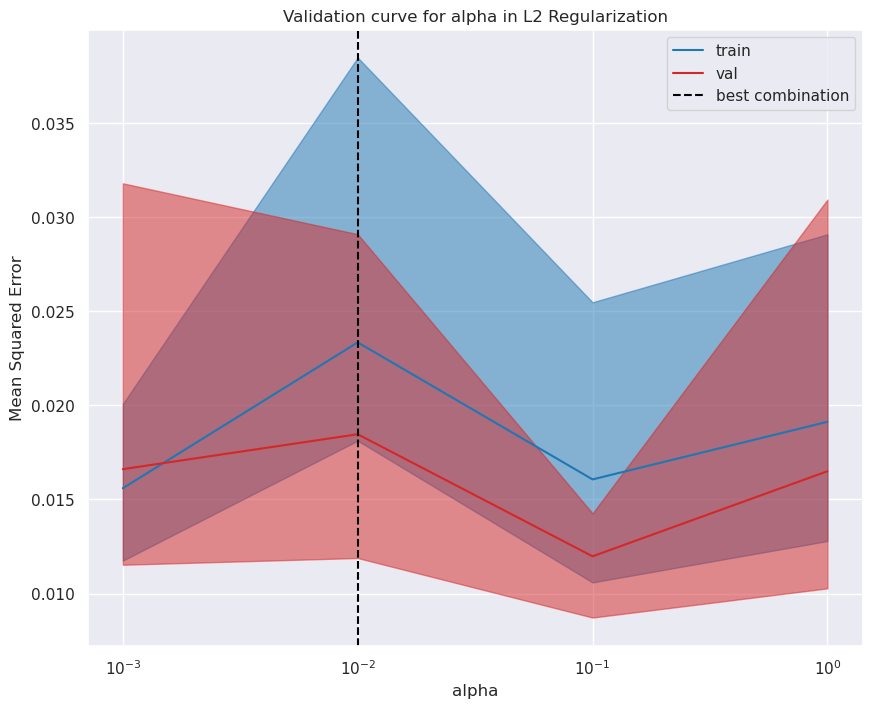

In [ ]:
plt.figure(figsize=(10,8))
alphas = [0.001, 0.01, 0.1, 1.0]

plt.plot(alphas, MSE_train_means, color='tab:blue', label='train')
plt.fill_between(alphas, MSE_train_mins, MSE_train_maxs, alpha=0.5, color='tab:blue')
plt.plot(alphas, MSE_val_means, color='tab:red', label='val')
plt.fill_between(alphas, MSE_val_mins, MSE_val_maxs, alpha=0.5, color='tab:red')
plt.xlabel('alpha')
plt.axvline(x=0.01, color='black', linestyle='--', label='best combination')

plt.xscale('log')
plt.ylabel('Mean Squared Error')
plt.legend()
plt.title("Validation curve for alpha in L2 Regularization")
plt.show()

In [ ]:
# Define model with regularization L2
best_model = tf.keras.Sequential([
    tf.keras.layers.Dense(10, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01), input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(1)
])

best_model.compile(optimizer='adam', loss='mean_squared_error')

best_model.layers[0].kernel_regularizer = tf.keras.regularizers.l2(0.01)

best_model.fit(X_train, y_train, epochs=10, verbose=0)

In [ ]:
y_train_pred = best_model.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

4621/4621 [==============================] - 4s 832us/step
Training Mean Squared Error: 0.004761000253120074
Training Mean Absolute Error: 0.01536372198387999


In [ ]:
y_test_pred = best_model.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

3581/3581 [==============================] - 3s 821us/step
Test Mean Squared Error: 0.04451565555505582
Test Mean Absolute Error: 0.02080676026376757


## s_rtt_avg

In [ ]:
regression_df = df_norm_scaled.drop(columns=['c_ip', '_c_rtt_avg', '_c_rtt_cnt', '_c_rtt_max', '_c_rtt_min', '_c_rtt_std', '_s_rtt_cnt', '_s_rtt_max', '_s_rtt_min', '_s_rtt_std'])
start_test_index = df_training.index[-1] + 1
regression_df

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,label
0,-0.107564,-0.102390,0.574035,0.167195,-0.024507,-0.053287,-0.024250,0.629761,-0.120316,-0.091699,...,-0.457002,-0.069715,1.106862,0.081361,0.108048,-0.088372,-1.106843,0.193998,0.608787,krxd.net
1,-0.105436,-0.099003,-0.605697,-0.084394,-0.031887,-0.053287,-0.031646,-1.804669,-0.195093,-1.116417,...,-0.533046,-0.069715,1.106862,0.081361,0.108048,-0.089836,-1.106843,-5.154702,-1.606309,other
2,-0.108628,-0.103519,0.574035,-0.047634,-0.012732,-0.053287,-0.012449,0.629761,0.156819,-0.091699,...,-0.533901,-0.069715,1.106862,0.081361,0.108048,-0.085807,-1.106843,0.193998,0.608787,contextweb.com
3,-0.107564,-0.103519,0.108562,-0.100397,-0.029593,-0.053287,-0.029347,-0.210697,-0.131139,-1.116417,...,-0.533901,-0.069715,-0.903455,0.081361,0.108048,-0.089228,0.903467,0.193998,-1.606309,twitchcdn.net
4,-0.109692,-0.104649,-1.709188,-0.104993,-0.033197,-0.053287,-0.032959,-0.210697,-0.182303,-1.116417,...,-0.533901,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,-1.606309,twitchcdn.net
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262438,-0.087350,-0.099003,0.742568,-0.096643,-0.015297,-0.037376,-0.015112,0.629761,0.472328,-0.358126,...,2.968682,-0.069715,-0.903455,0.081361,0.108048,-0.085379,0.903467,0.193998,0.608787,other
262439,-0.102244,-0.104649,0.574035,-0.099774,-0.026266,-0.045944,-0.026056,0.629761,-0.017989,-0.091699,...,3.385088,-0.069715,-0.903455,0.081361,0.108048,-0.088800,0.903467,0.193998,0.608787,krxd.net
262440,-0.108628,-0.103519,0.742568,-0.092478,-0.029315,-0.053287,-0.029069,0.629761,-0.144258,0.769064,...,-0.533145,-0.069715,1.106862,0.081361,0.108048,-0.089228,-1.106843,0.193998,0.608787,other
262441,-0.108628,-0.103519,-1.709188,-0.104993,-0.032072,-0.053287,-0.031831,0.629761,-0.144258,0.769064,...,-0.533847,-0.069715,-0.903455,0.081361,0.108048,-0.090083,0.903467,0.193998,0.608787,krxd.net


In [ ]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(regression_df['label'])
regression_df['label'] = y_encoded

features = regression_df.drop(columns=['_s_rtt_avg'])
target = regression_df['_s_rtt_avg']

In [ ]:
corr_matrix = features.corr()
corr_matrix

,_c_ack_cnt,_c_ack_cnt_p,_c_appdataB,_c_appdataT,_c_bytes_all,_c_bytes_retx,_c_bytes_uniq,_c_cwin_ini,_c_cwin_max,_c_cwin_min,...,_s_sit_std,_s_syn_cnt,_s_tm_opt,_s_ttl_max,_s_ttl_min,_s_win_max,_s_win_min,_s_win_scl,_tls_session_stat,label
_c_ack_cnt,1.000000,0.993449,0.013663,-0.000708,0.160441,0.095049,0.160130,-0.014046,0.102324,-0.000205,...,-0.023120,-0.001840,0.012506,0.000886,-0.008931,0.001941,-0.012505,0.011374,-0.012943,0.024507
_c_ack_cnt_p,0.993449,1.000000,0.011032,-0.000810,0.057200,0.061015,0.056935,-0.015632,0.027541,0.001483,...,-0.024215,-0.001588,0.014478,0.000623,-0.008947,0.000844,-0.014478,0.011114,-0.014243,0.023768
_c_appdataB,0.013663,0.011032,1.000000,0.052234,0.011842,0.016640,0.011764,0.363557,0.051410,-0.190298,...,0.239375,-0.025742,0.044127,-0.010387,-0.012193,-0.025000,-0.044112,-0.007169,0.294299,0.012269
_c_appdataT,-0.000708,-0.000810,0.052234,1.000000,0.000322,0.006594,0.000285,-0.006259,0.003401,0.016494,...,0.018741,0.114458,-0.001968,-0.002534,-0.015552,0.109056,0.001969,0.015409,-0.000957,-0.007560
_c_bytes_all,0.160441,0.057200,0.011842,0.000322,1.000000,0.252737,0.999985,0.005460,0.839603,-0.005872,...,-0.005477,-0.001146,-0.004450,0.001247,-0.001730,0.012502,0.004450,0.001072,0.002688,0.005330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
_s_win_max,0.001941,0.000844,-0.025000,0.109056,0.012502,0.009135,0.012468,-0.003319,0.011334,0.036275,...,-0.021006,0.816028,0.012510,0.002640,-0.037047,1.000000,-0.012617,0.020415,0.000582,0.009406
_s_win_min,-0.012505,-0.014478,-0.044112,0.001969,0.004450,-0.006216,0.004492,0.097558,-0.011720,0.044850,...,0.160716,-0.021953,-0.999990,-0.006991,0.009858,-0.012617,1.000000,0.226137,0.029549,0.029121
_s_win_scl,0.011374,0.011114,-0.007169,0.015409,0.001072,0.008556,0.001025,-0.010211,-0.013358,0.060236,...,0.094080,0.014364,-0.226140,-0.008075,-0.016186,0.020415,0.226137,1.000000,-0.043601,-0.003501
_tls_session_stat,-0.012943,-0.014243,0.294299,-0.000957,0.002688,0.006407,0.002656,0.848864,0.008710,-0.035391,...,0.091889,-0.000260,-0.029555,-0.021579,-0.015188,0.000582,0.029549,-0.043601,1.000000,-0.118489


In [ ]:
# extract features having a correlation > 0.8
c = corr_matrix[corr_matrix>0.8]
s = c.unstack()
so = s.sort_values(ascending=False).reset_index()

# get strongly correlatead features removing pairs having correlation = 1 because of the diagonal, i.e., correlation between one feature and itself
so = so[(so[0].isnull()==False) & (so["level_0"] != so["level_1"])]

to_be_deleted = []
candidates = list(so["level_0"])

# get the unique set of features to be deleted. Notice that we discard one feature per time considering the case where a feature is strongly correlated with multiple features
subset_so = so
for candidate in candidates:
    if (candidate in list(subset_so["level_0"])):
        to_be_deleted.append(candidate)
        subset_so = subset_so[(subset_so["level_0"] != candidate) & (subset_so["level_1"] != candidate)]

# to_be_deleted contains the index of columns that you need to remove from both training and test sets
print(len(to_be_deleted), 'features are removed')

# remove the correlated features from bot sets
to_be_deleted.append('label')
features = regression_df.drop(columns=to_be_deleted)
labels = regression_df['label']

X_train = features.loc[:start_test_index]
y_train = target.loc[:start_test_index]
X_test = features.loc[start_test_index:]
y_test = target.loc[start_test_index:]

42 features are removed


### DecisionTree

In [ ]:
dtRTT = DecisionTreeRegressor(random_state=42)
dtRTT.fit(X_train,y_train)

DecisionTreeRegressor(random_state=42)

In [ ]:
y_train_pred = dtRTT.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 2.5953374878656492e-17
Training Mean Absolute Error: 2.4606755807287192e-09


In [ ]:
y_test_pred = dtRTT.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 0.0011072830884782201
Test Mean Absolute Error: 0.0005133255850415807


In [ ]:
MSE_dt_train_means = []
MSE_dt_train_maxs = []
MSE_dt_train_mins = []
MSE_dt_val_means = []
MSE_dt_val_maxs = []
MSE_dt_val_mins = []

combinations = []

for max_depth in [4, 6, 8, None]:
    for min_samples_split in [2, 3, 4]:
        for min_samples_leaf in [1, 2, 3]:
            dt = DecisionTreeRegressor(max_depth=max_depth, min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf)
            scores = cross_validate(dt, X_train, y_train, cv=5, scoring='neg_mean_squared_error', return_train_score=True, n_jobs=n_jobs)

            MSE_dt_train_means.append(-1 * (scores['train_score'].mean()))
            MSE_dt_train_maxs.append(-1 * (scores['train_score'].max()))
            MSE_dt_train_mins.append(-1 * (scores['train_score'].min()))
            MSE_dt_val_means.append(-1 * (scores['test_score'].mean()))
            MSE_dt_val_maxs.append(-1 * (scores['test_score'].max()))
            MSE_dt_val_mins.append(-1 * (scores['test_score'].min()))

            comb = f'max_depth: {max_depth}, min_samples_split: {min_samples_split} , min_samples_leaf: {min_samples_leaf}'
            combinations.append(comb)
            print(comb)

max_depth: 4, min_samples_split: 2 , min_samples_leaf: 1
max_depth: 4, min_samples_split: 2 , min_samples_leaf: 2
max_depth: 4, min_samples_split: 2 , min_samples_leaf: 3
max_depth: 4, min_samples_split: 3 , min_samples_leaf: 1
max_depth: 4, min_samples_split: 3 , min_samples_leaf: 2
max_depth: 4, min_samples_split: 3 , min_samples_leaf: 3
max_depth: 4, min_samples_split: 4 , min_samples_leaf: 1
max_depth: 4, min_samples_split: 4 , min_samples_leaf: 2
max_depth: 4, min_samples_split: 4 , min_samples_leaf: 3
max_depth: 6, min_samples_split: 2 , min_samples_leaf: 1
max_depth: 6, min_samples_split: 2 , min_samples_leaf: 2
max_depth: 6, min_samples_split: 2 , min_samples_leaf: 3
max_depth: 6, min_samples_split: 3 , min_samples_leaf: 1
max_depth: 6, min_samples_split: 3 , min_samples_leaf: 2
max_depth: 6, min_samples_split: 3 , min_samples_leaf: 3
max_depth: 6, min_samples_split: 4 , min_samples_leaf: 1
max_depth: 6, min_samples_split: 4 , min_samples_leaf: 2
max_depth: 6, min_samples_split

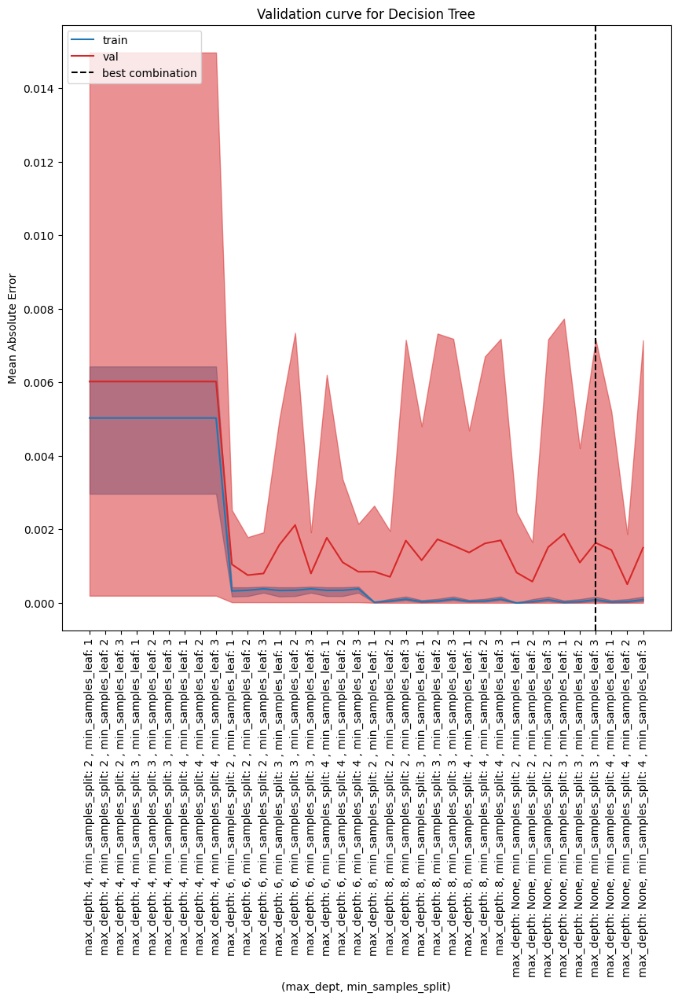

In [ ]:
plt.figure(figsize=(10,10))
x = list(range(len(combinations)))
plt.plot(x, MSE_dt_train_means, color='tab:blue', label='train')
plt.fill_between(x, MSE_dt_train_mins, MSE_dt_train_maxs, alpha=0.5, color='tab:blue')
plt.plot(x, MSE_dt_val_means, color='tab:red', label='val')
plt.fill_between(x, MSE_dt_val_mins, MSE_dt_val_maxs, alpha=0.5, color='tab:red')
plt.xlabel('(max_dept, min_samples_split)')
plt.axvline(x=32, color='black', linestyle='--', label='best combination')

plt.ylabel('Mean Absolute Error')
plt.legend()
plt.title("Validation curve for Decision Tree")
plt.xticks([i for i in range(len(combinations))], combinations, rotation=90)
plt.show()

In [ ]:
best_dt = DecisionTreeRegressor(max_depth=None, min_samples_split=3, min_samples_leaf=3)
best_dt.fit(X_train,y_train)

DecisionTreeRegressor(min_samples_leaf=3, min_samples_split=3)

In [ ]:
y_train_pred = best_dt.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 3.5769788417297556e-05
Training Mean Absolute Error: 0.00014441981899747432


In [ ]:
y_test_pred = best_dt.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 0.0003576198800664357
Test Mean Absolute Error: 0.00039545766059351803


### Lasso Regressor

In [ ]:
lassoRTT = Lasso(random_state=42)
lassoRTT.fit(X_train,y_train)

Lasso(random_state=42)

In [ ]:
y_train_pred = lassoRTT.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 0.9999933601886023
Training Mean Absolute Error: 0.25356126158484743


In [ ]:
y_test_pred = lassoRTT.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 1.0810478843430353
Test Mean Absolute Error: 0.2781564021325332


In [ ]:
MAE_train_means = []
MAE_train_maxs = []
MAE_train_mins = []
MAE_val_means = []
MAE_val_maxs = []
MAE_val_mins = []

alphas=[]

for alpha in np.linspace(0,1,5):
    lasso = Lasso(alpha=alpha)
    scores = cross_validate(lasso, X_train, y_train, cv=5, scoring='neg_mean_absolute_error', return_train_score=True,n_jobs=n_jobs)
    MAE_train_means.append(-1*(scores['train_score'].mean()))
    MAE_train_maxs.append(-1*(scores['train_score'].max()))
    MAE_train_mins.append(-1*(scores['train_score'].min()))
    MAE_val_means.append(-1*(scores['test_score'].mean()))
    MAE_val_maxs.append(-1*(scores['test_score'].max()))
    MAE_val_mins.append(-1*(scores['test_score'].min()))

    alphas.append(alpha)

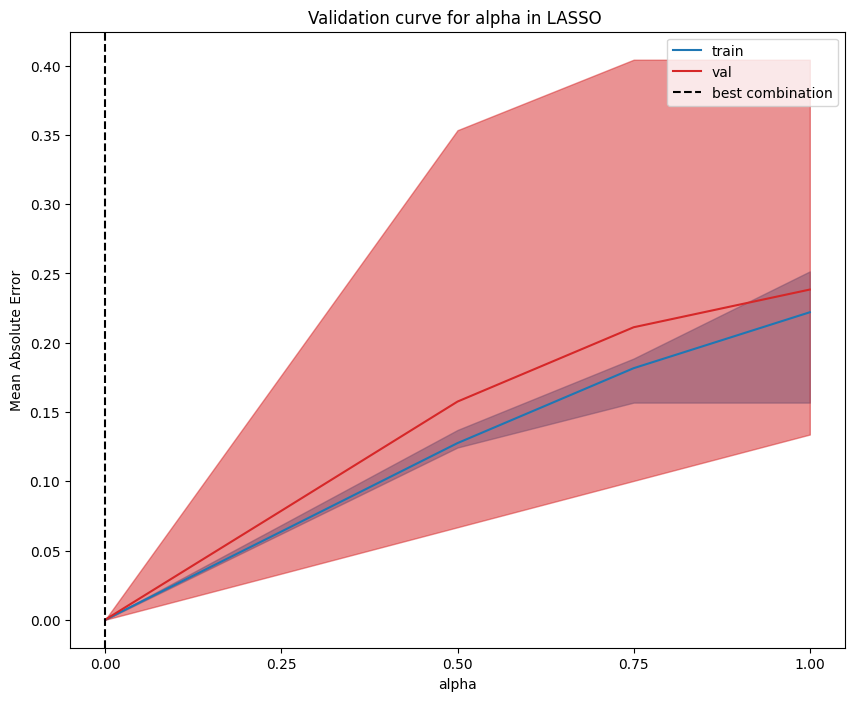

In [ ]:
plt.figure(figsize=(10,8))
x = list(np.linspace(0,1,5))
plt.plot(x, MAE_train_means, color='tab:blue', label='train')
plt.fill_between(x, MAE_train_mins, MAE_train_maxs, alpha=0.5, color='tab:blue')
plt.plot(x, MAE_val_means, color='tab:red', label='val')
plt.fill_between(x, MAE_val_mins, MAE_val_maxs, alpha=0.5, color='tab:red')
plt.xlabel('alpha')
plt.axvline(x=0, color='black', linestyle='--', label='best combination')

plt.xticks(alphas)
plt.ylabel('Mean Absolute Error')
plt.legend()
plt.title("Validation curve for alpha in LASSO ")
plt.show()

In [ ]:
best_lasso = Lasso(random_state=42, alpha=0)
best_lasso.fit(X_train,y_train)

C:\Users\franc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\base.py:1152: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  return fit_method(estimator, *args, **kwargs)
C:\Users\franc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\linear_model\_coordinate_descent.py:628: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(


Lasso(alpha=0, random_state=42)

In [ ]:
y_train_pred = best_lasso.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

Training Mean Squared Error: 1.2266383169882872e-07
Training Mean Absolute Error: 0.00019405874405003794


In [ ]:
y_test_pred = best_lasso.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

Test Mean Squared Error: 1.150955097474553e-07
Test Mean Absolute Error: 0.0001913265123609323


### Neural Network

In [ ]:
model = tf.keras.Sequential([
    tf.keras.layers.Dense(10, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(1)
])

# Compiliamo il modello
model.compile(optimizer='adam', loss='mean_squared_error')

initial_weights = model.get_weights()

model.fit(X_train, y_train, epochs=10, verbose=0)

In [ ]:
y_train_pred = model.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

4621/4621 [==============================] - 4s 793us/step
Training Mean Squared Error: 0.0022800691083085457
Training Mean Absolute Error: 0.009732493411897754


In [ ]:
y_test_pred = model.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

3581/3581 [==============================] - 3s 796us/step
Test Mean Squared Error: 0.03144104840329662
Test Mean Absolute Error: 0.010490375364936152


In [ ]:
import numpy as np
import tensorflow as tf
from sklearn.model_selection import cross_validate, KFold

# Define model with regularization L2
model = tf.keras.Sequential([
    tf.keras.layers.Dense(10, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01), input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(1)
])

model.compile(optimizer='adam', loss='mean_squared_error')

MSE_train_means = []
MSE_train_maxs = []
MSE_train_mins = []
MSE_val_means = []
MSE_val_maxs = []
MSE_val_mins = []

# (parameters for regularization L2)
alphas = [0.001, 0.01, 0.1, 1.0]

# Cross validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

for alpha in alphas:
    model.layers[0].kernel_regularizer = tf.keras.regularizers.l2(alpha)

    train_mse = []
    val_mse = []

    for train_index, val_index in kf.split(X_train.values):
        X_train_fold, X_val_fold = X_train.values[train_index], X_train.values[val_index]
        y_train_fold, y_val_fold = y_train[train_index], y_train[val_index]

        model.set_weights(initial_weights)

        model.fit(X_train_fold, y_train_fold, epochs=10, verbose=0)

        train_mse.append(model.evaluate(X_train_fold, y_train_fold, verbose=0))

        val_mse.append(model.evaluate(X_val_fold, y_val_fold, verbose=0))

    MSE_train_means.append(np.mean(train_mse))
    MSE_train_maxs.append(np.max(train_mse))
    MSE_train_mins.append(np.min(train_mse))
    MSE_val_means.append(np.mean(val_mse))
    MSE_val_maxs.append(np.max(val_mse))
    MSE_val_mins.append(np.min(val_mse))

    print(f"Alpha: {alpha}")

Alpha: 0.001
Alpha: 0.01
Alpha: 0.1
Alpha: 1.0


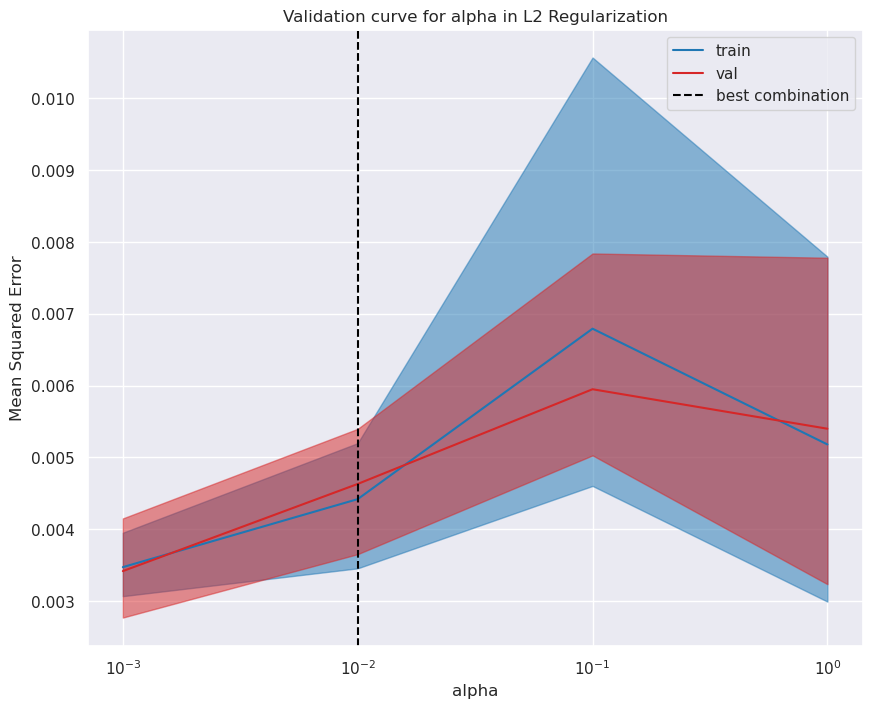

In [ ]:
plt.figure(figsize=(10,8))
alphas = [0.001, 0.01, 0.1, 1.0]

plt.plot(alphas, MSE_train_means, color='tab:blue', label='train')
plt.fill_between(alphas, MSE_train_mins, MSE_train_maxs, alpha=0.5, color='tab:blue')
plt.plot(alphas, MSE_val_means, color='tab:red', label='val')
plt.fill_between(alphas, MSE_val_mins, MSE_val_maxs, alpha=0.5, color='tab:red')
plt.xlabel('alpha')
plt.axvline(x=0.01, color='black', linestyle='--', label='best combination')

plt.xscale('log')  # scala logaritmica per alpha
plt.ylabel('Mean Squared Error')
plt.legend()
plt.title("Validation curve for alpha in L2 Regularization")
plt.show()

In [ ]:
# Define model with regularization L2
best_model = tf.keras.Sequential([
    tf.keras.layers.Dense(10, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01), input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(1)
])

best_model.compile(optimizer='adam', loss='mean_squared_error')

best_model.layers[0].kernel_regularizer = tf.keras.regularizers.l2(0.01)

best_model.fit(X_train, y_train, epochs=10, verbose=0)

In [ ]:
y_train_pred = best_model.predict(X_train)
train_mse = mean_squared_error(y_train, y_train_pred)
print(f'Training Mean Squared Error: {train_mse}')
train_mae = mean_absolute_error(y_train, y_train_pred)
print(f'Training Mean Absolute Error: {train_mae}')

4621/4621 [==============================] - 4s 815us/step
Training Mean Squared Error: 0.0027115943487124564
Training Mean Absolute Error: 0.014732336448390773


In [ ]:
y_test_pred = best_model.predict(X_test)
test_mse = mean_squared_error(y_test, y_test_pred)
print(f'Test Mean Squared Error: {test_mse}')
test_mae = mean_absolute_error(y_test, y_test_pred)
print(f'Test Mean Absolute Error: {test_mae}')

3581/3581 [==============================] - 3s 816us/step
Test Mean Squared Error: 0.005931945057142406
Test Mean Absolute Error: 0.017403132666796578
